In [1]:
!nvidia-smi

Mon Jul 30 23:27:44 2018       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 396.37                 Driver Version: 396.37                    |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:05:00.0 Off |                  Off |
| N/A   43C    P0    43W / 250W |  13237MiB / 16160MiB |      1%      Default |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:84:00.0 Off |                  Off |
| N/A   42C    P0    27W / 250W |     11MiB / 16160MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
        

In [2]:
import time
import os, fnmatch
import numpy as np
import tensorflow as tf
import keras
import matplotlib.pyplot as plt
from __future__ import print_function

from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras.layers import Input
from keras.models import Model, Sequential
from keras.layers.core import Dense, Dropout, Activation, Reshape
from keras.datasets import mnist
from keras.optimizers import Adam, SGD
from keras import initializers
from keras.layers import Input, Conv2D, Lambda, merge, Dense, Flatten,MaxPooling2D, Conv2DTranspose, BatchNormalization, UpSampling2D, ZeroPadding2D
from keras.regularizers import l2
from keras.layers.advanced_activations import LeakyReLU
import keras.backend as K
import numpy.random as rand

/home/arjung2/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [3]:
# create a list, result, of all file names
def find(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files:
            if fnmatch.fnmatch(name, pattern):
                result.append(os.path.join(root, name))
    return result

result = find('*.jpg', 'lfwfaces')
print("Number of images: " + str(len(result)))
print("Example file name: " + result[0])

Number of images: 13233
Example file name: lfwfaces/Aaron_Eckhart_0001.jpg


In [4]:
img = load_img(result[0])
img = img_to_array(img)
print(np.max(img))

239.0


In [5]:
x_train = []

for i in range(len(result)):
    img = load_img(result[i])
    img = img_to_array(img)
    
    # convert from (250, 250, 3) to (256, 256, 3)
    new_img = []
    for j in range(250):
        arr = [[0, 0, 0]]
        arr = np.array(arr)

        vec = np.append(img[j], arr, axis=0)
        vec = np.append(vec, arr, axis=0)
        vec = np.append(vec, arr, axis=0)
        vec = np.append(vec, arr, axis=0)
        vec = np.append(vec, arr, axis=0)
        vec = np.append(vec, arr, axis=0)
        new_img.append(vec)

    new_img.append(vec)
    new_img.append(vec)
    new_img.append(vec)
    new_img.append(vec)
    new_img.append(vec)
    new_img.append(vec)
    new_img = np.array(new_img)
    
    img = (new_img - 127.5) / 127.5
    x_train.append(img)
    
x_train = np.array(x_train)
print(x_train.shape)

(13233, 256, 256, 3)


(256, 256, 3)


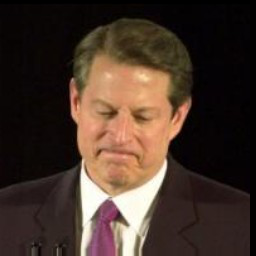

In [6]:
print(x_train[334].shape)
img = array_to_img(x_train[334])
display(img)

In [7]:
# x_train = x_train[:1000]

def get_batch(size):
    
    arr = []
    
    for _ in range(size):
        
        k = rand.randint(0, 13233)
        arr.append(x_train[k])
    
    return np.array(arr)


In [8]:
# Generator

input_shape = (1, 1, 100)

generator = Sequential()

# conv2dTranspose layers to upsample
# generator.add(Conv2DTranspose(64,(5,5),strides=(2,2),activation='relu',input_shape=input_shape)) 
# generator.add(BatchNormalization())

# generator.add(Conv2DTranspose(128,(5,5),strides=(2,2),activation='relu',input_shape=input_shape)) 
# generator.add(BatchNormalization())

# generator.add(Conv2DTranspose(256,(5,5),strides=(2,2),activation='relu',input_shape=input_shape)) 
# generator.add(BatchNormalization())

# generator.add(Conv2DTranspose(3,(5,5),strides=(2,2),activation='relu',input_shape=input_shape))
# generator.add(BatchNormalization())

# --------------------------------------------------------------------------------------------------

# generator.add(UpSampling2D(size=(5, 5), input_shape=input_shape)) # 100 x 5 x 5
# generator.add(Conv2D(64,(5,5),activation='relu',padding='same')) # 64 x 5 x 5
# # try adding strides=(2, 2)

# generator.add(UpSampling2D(5)) # 64 x 25 x 25
# generator.add(Conv2D(128,(5,5),activation='relu',padding='same')) # 128 x 25 x 25

# generator.add(UpSampling2D(5)) # 128 x 125 x 125
# generator.add(Conv2D(256,(5,5),activation='relu',padding='same')) # 256 x 125 x 125

# generator.add(UpSampling2D(2)) # 256 x 250 x 250
# generator.add(Conv2D(3,(5,5),activation='tanh',padding='same')) # 3 x 250 x 250

# changed kernal size from (2, 2) to (5, 5) for noisy instead of structured generation

# --------------------------------------------------------------------------------------------------

# generator.add(UpSampling2D(size=(2, 2), input_shape=input_shape)) # 100 x 2 x 2
# generator.add(Conv2D(64,(6,6),activation='relu',padding='same')) # 4 x 2 x 2
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 4 x 4 x 4
# generator.add(Conv2D(96,(6,6),activation='relu',padding='same')) # 8 x 4 x 4
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 8 x 8 x 8
# generator.add(Conv2D(128,(6,6),activation='relu',padding='same')) # 16 x 8 x 8
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 16 x 16 x 16
# generator.add(Conv2D(160,(6,6),activation='relu',padding='same')) # 32 x 16 x 16
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 32 x 32 x 32
# generator.add(Conv2D(192,(6,6),activation='relu',padding='same')) # 64 x 32 x 32
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 64 x 64 x 64
# generator.add(Conv2D(224,(6,6),activation='relu',padding='same')) # 128 x 64 x 64
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 128 x 128 x 128
# generator.add(Conv2D(256,(6,6),activation='relu',padding='same')) # 256 x 128 x 128
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 256 x 256 x 256
# generator.add(Conv2D(3,(6,6),activation='tanh',padding='same')) # 3 x 256 x 256

# --------------------------------------------------------------------------------------------------

# generator.add(UpSampling2D(size=(2, 2), input_shape=input_shape)) # 100 x 2 x 2
# generator.add(Conv2D(128,(6,6),activation='relu',padding='same')) # 4 x 2 x 2
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(8)) # 4 x 4 x 4
# generator.add(Conv2D(256,(6,6),activation='relu',padding='same')) # 8 x 4 x 4
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(8)) # 8 x 8 x 8
# generator.add(Conv2D(512,(6,6),activation='relu',padding='same')) # 16 x 8 x 8
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 16 x 16 x 16
# generator.add(Conv2D(3,(6,6),activation='tanh',padding='same')) # 32 x 16 x 16

# added batch normalization for colorful results

# --------------------------------------------------------------------------------------------------

initializer = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=None)

# generator.add(Conv2D(512,(5,5),padding='same', input_shape=input_shape, kernel_initializer=initializer)) # 4 x 2 x 2
# generator.add(LeakyReLU(alpha=0.2))

# generator.add(UpSampling2D(size=(2, 2))) # 100 x 2 x 2
# generator.add(Conv2D(256,(5,5),padding='same', kernel_initializer=initializer)) # 4 x 2 x 2
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 4 x 4 x 4
# generator.add(Conv2D(128,(5,5),padding='same', kernel_initializer=initializer)) # 8 x 4 x 4
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 8 x 8 x 8
# generator.add(Conv2D(64,(5,5),padding='same', kernel_initializer=initializer)) # 16 x 8 x 8
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 16 x 16 x 16
# generator.add(Conv2D(32,(5,5),padding='same', kernel_initializer=initializer)) # 32 x 16 x 16
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 32 x 32 x 32
# generator.add(Conv2D(16,(5,5),padding='same', kernel_initializer=initializer)) # 64 x 32 x 32
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 64 x 64 x 64
# generator.add(Conv2D(8,(5,5),padding='same', kernel_initializer=initializer)) # 128 x 64 x 64
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 128 x 128 x 128
# generator.add(Conv2D(4,(5,5),padding='same', kernel_initializer=initializer)) # 256 x 128 x 128
# generator.add(LeakyReLU(alpha=0.2))
# generator.add(BatchNormalization(momentum=0.8))

# generator.add(UpSampling2D(2)) # 256 x 256 x 256
# generator.add(Conv2D(3,(5,5),activation='tanh',padding='same', kernel_initializer=initializer)) # 3 x 256 x 256

# --------------------------------------------------------------------------------------------------

# kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=None)
kernel_init = 'glorot_uniform'

generator.add(Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init, input_shape = input_shape))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 32, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 16, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(BatchNormalization(momentum = 0.5))
generator.add(LeakyReLU(0.2))

generator.add(Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init))
generator.add(Activation('tanh'))

# --------------------------------------------------------------------------------------------------





# goal = 3 x 250 x 250

# Discriminator

img_shape = (256, 256, 3)

discriminator = Sequential()

# --------------------------------------------------------------------------------------------------

# discriminator.add(Conv2D(64,(10,10),activation='relu',input_shape=img_shape)) # 64x241x241 --> 64x120x120
# discriminator.add(MaxPooling2D())
# # try changing MaxPooling2D to AveragePooling2D

# discriminator.add(Conv2D(128,(7,7),activation='relu', kernel_regularizer=l2(2e-4))) # 128x114x114 --> 128x57x57
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(256,(4,4),activation='relu',kernel_regularizer=l2(2e-4))) # 256x54x54 --> 256x27x27 
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(512,(7,7),activation='relu',kernel_regularizer=l2(2e-4))) # 512x21x21 --> 512x10x10
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(1024,(10,10),activation='relu')) # 1024x1x1

# --------------------------------------------------------------------------------------------------

# discriminator.add(Conv2D(64,(3,3),activation='relu',input_shape=img_shape)) # 64x241x241 --> 64x120x120
# discriminator.add(MaxPooling2D())
# # try changing MaxPooling2D to AveragePooling2D

# discriminator.add(Conv2D(128,(4,4),activation='relu', kernel_regularizer=l2(2e-4))) # 128x114x114 --> 128x57x57
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(256,(5,5),activation='relu',kernel_regularizer=l2(2e-4))) # 256x54x54 --> 256x27x27 
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(512,(4,4),activation='relu',kernel_regularizer=l2(2e-4))) # 512x21x21 --> 512x10x10
# discriminator.add(MaxPooling2D())

# discriminator.add(Conv2D(1024,(3,3),activation='relu')) # 1024x1x1

# --------------------------------------------------------------------------------------------------

# discriminator.add(Conv2D(32, kernel_size=5, strides=2, input_shape=img_shape))
# discriminator.add(LeakyReLU(alpha=0.2))
# # discriminator.add(Dropout(0.25))
# discriminator.add(Conv2D(64, kernel_size=5, strides=2))
# # discriminator.add(ZeroPadding2D(padding=((0,1),(0,1))))
# # discriminator.add(BatchNormalization(momentum=0.8))
# discriminator.add(LeakyReLU(alpha=0.2))
# # discriminator.add(Dropout(0.25))
# discriminator.add(Conv2D(128, kernel_size=5, strides=2))
# # discriminator.add(BatchNormalization(momentum=0.8))
# discriminator.add(LeakyReLU(alpha=0.2))
# # discriminator.add(Dropout(0.25))
# discriminator.add(Conv2D(256, kernel_size=5, strides=2))
# # discriminator.add(BatchNormalization(momentum=0.8))
# discriminator.add(LeakyReLU(alpha=0.2))
# # discriminator.add(Dropout(0.25))
# # discriminator.add(Conv2D(1024, kernel_size=5, strides=2, padding="same"))
# # # discriminator.add(BatchNormalization(momentum=0.8))
# # discriminator.add(LeakyReLU(alpha=0.2))
# # # discriminator.add(Dropout(0.25))
# discriminator.add(Conv2D(512, kernel_size=5, strides=2))
# # discriminator.add(BatchNormalization(momentum=0.8))
# discriminator.add(LeakyReLU(alpha=0.2))
# discriminator.add(Conv2D(1, kernel_size=5, strides=1))
# # discriminator.add(BatchNormalization(momentum=0.8))
# discriminator.add(Flatten())
# discriminator.add(Activation('sigmoid'))

# --------------------------------------------------------------------------------------------------

discriminator.add(Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", input_shape=img_shape))
discriminator.add(LeakyReLU(alpha=0.2))

discriminator.add(Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last"))
discriminator.add(BatchNormalization(momentum=0.5))
discriminator.add(LeakyReLU(alpha=0.2))

discriminator.add(Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last"))
discriminator.add(BatchNormalization(momentum=0.5))
discriminator.add(LeakyReLU(alpha=0.2))

discriminator.add(Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last"))
discriminator.add(BatchNormalization(momentum=0.5))
discriminator.add(LeakyReLU(alpha=0.2))

discriminator.add(Flatten())
discriminator.add(Dense(1,activation="sigmoid"))

# --------------------------------------------------------------------------------------------------

# discriminator.add(Flatten()) # (None, 1024)

# discriminator.add(Dense(1,activation="sigmoid",kernel_regularizer=l2(1e-3))) # (None, 1)

In [9]:
# GAN

# initially -- since we only want to train either the generator or discriminator at a time
# discriminator.trainable = False

def wasserstein_loss(y_true, y_pred):
    return K.mean(y_true * y_pred)

# gan input (noise) will be 100-dimensional vectors
gan_input = Input(shape=input_shape)

gan = Model(inputs = gan_input, outputs = discriminator(generator(gan_input)) )

gan.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.00015, beta_1=0.5))

discriminator.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5))

# gan.compile(loss=wasserstein_loss, optimizer=Adam(lr=0.00015, beta_1=0.5))

# discriminator.compile(loss=wasserstein_loss, optimizer=SGD(clipvalue=0.01))

In [10]:
generator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_transpose_1 (Conv2DTr (None, 4, 4, 512)         819712    
_________________________________________________________________
batch_normalization_1 (Batch (None, 4, 4, 512)         2048      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 8, 8, 256)         2097408   
_________________________________________________________________
batch_normalization_2 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 16, 16, 128)       524416    
__________

In [11]:
discriminator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 64, 64, 128)       131200    
_________________________________________________________________
batch_normalization_8 (Batch (None, 64, 64, 128)       512       
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 32, 32, 256)       524544    
_________________________________________________________________
batch_normalization_9 (Batch (None, 32, 32, 256)       1024      
__________

0.0013412086
-0.0013392066
-1.799179e-05
(1, 256, 256, 3)


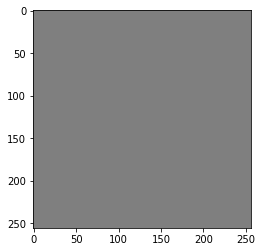

In [12]:
noise = np.random.normal(0, 1, size=[1, 1, 1, 100])
output = generator.predict(noise)
print(np.max(output))
print(np.min(output))
print(np.average(output))
output = output * 0.5 + 0.5
print(output.shape)
output = output.reshape(256, 256, 3)
# output = np.clip(output, 0, 1)
plt.imshow(output, vmin=0, vmax=1)
plt.show()



--------------- Epoch: 0 ---------------


/home/arjung2/anaconda3/lib/python3.6/site-packages/keras/engine/training.py:478: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


Discriminator loss: 5.466561, GAN loss: 8.80331

Discriminator loss: 3.4306464, GAN loss: 12.152222

Discriminator loss: 0.8770641, GAN loss: 7.875622

Discriminator loss: 1.2081659, GAN loss: 8.400751

Discriminator loss: 1.3298295, GAN loss: 4.9696307

Discriminator loss: 0.73281574, GAN loss: 9.441546

Discriminator loss: 4.4686637, GAN loss: 13.622101

Discriminator loss: 1.4592339, GAN loss: 14.229536

Discriminator loss: 5.9183617, GAN loss: 14.176007

Loss History:


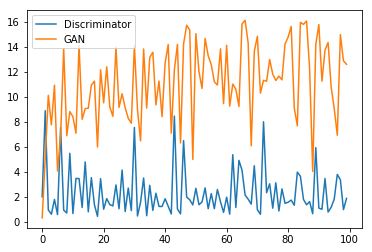

An Example from the Training Set: 


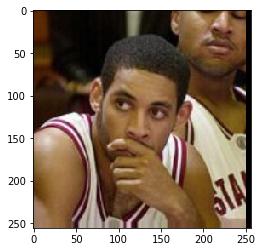

An Example from the Generator: 


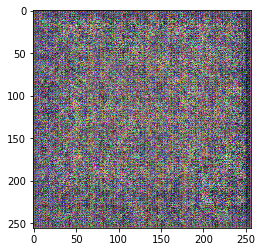

Prediction: [6.403642e-11]


--------------- Epoch: 1 ---------------
Discriminator loss: 0.7979856, GAN loss: 8.469922

Discriminator loss: 2.8873515, GAN loss: 9.599348

Discriminator loss: 1.2762059, GAN loss: 15.769298

Discriminator loss: 1.3685671, GAN loss: 14.71434

Discriminator loss: 2.4336581, GAN loss: 14.696787

Discriminator loss: 3.8749669, GAN loss: 12.577724

Discriminator loss: 4.8873186, GAN loss: 14.280334

Discriminator loss: 0.46423516, GAN loss: 7.4869003

Discriminator loss: 0.6505565, GAN loss: 5.1260195

Loss History:


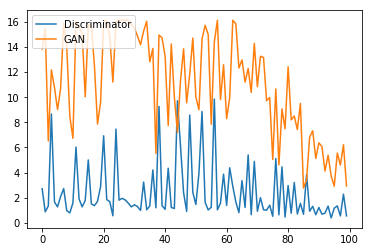

An Example from the Training Set: 


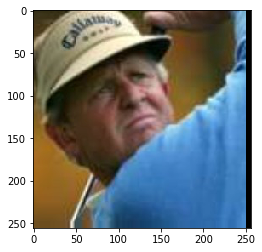

An Example from the Generator: 


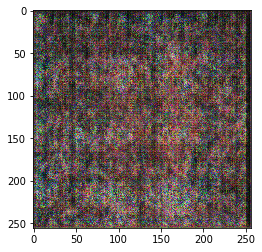

Prediction: [0.5902462]


--------------- Epoch: 2 ---------------
Discriminator loss: 1.5815583, GAN loss: 3.4533336

Discriminator loss: 0.54809403, GAN loss: 2.814154

Discriminator loss: 1.5237577, GAN loss: 3.5501976

Discriminator loss: 0.6584953, GAN loss: 2.6511834

Discriminator loss: 0.95812213, GAN loss: 1.8572897

Discriminator loss: 0.76859343, GAN loss: 2.0825028

Discriminator loss: 0.85417444, GAN loss: 3.2828789

Discriminator loss: 0.58433235, GAN loss: 2.5983443

Discriminator loss: 0.83994246, GAN loss: 2.161404

Loss History:


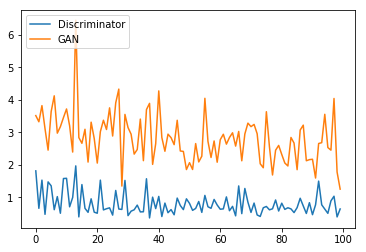

An Example from the Training Set: 


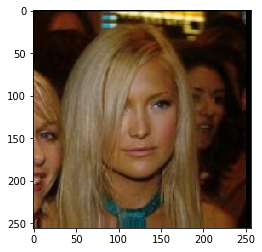

An Example from the Generator: 


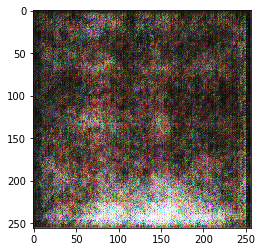

Prediction: [0.59924203]


--------------- Epoch: 3 ---------------
Discriminator loss: 0.471147, GAN loss: 2.3706057

Discriminator loss: 0.60905343, GAN loss: 2.5331054

Discriminator loss: 0.46298966, GAN loss: 0.9905952

Discriminator loss: 0.5427665, GAN loss: 1.7566297

Discriminator loss: 0.982323, GAN loss: 3.0536323

Discriminator loss: 1.3302466, GAN loss: 3.3251057

Discriminator loss: 1.0022098, GAN loss: 3.514679

Discriminator loss: 0.5740077, GAN loss: 2.8237166

Discriminator loss: 0.50236845, GAN loss: 3.1903267

Loss History:


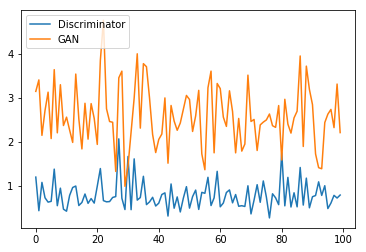

An Example from the Training Set: 


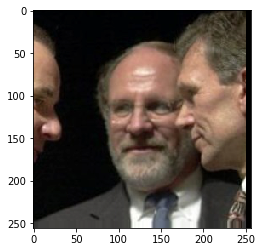

An Example from the Generator: 


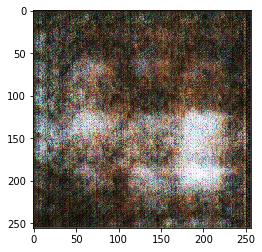

Prediction: [0.07108266]


--------------- Epoch: 4 ---------------
Discriminator loss: 0.8659571, GAN loss: 2.5787437

Discriminator loss: 0.8042642, GAN loss: 2.7931461

Discriminator loss: 0.45386177, GAN loss: 1.4397634

Discriminator loss: 0.6367153, GAN loss: 4.394397

Discriminator loss: 0.6180552, GAN loss: 3.1319127

Discriminator loss: 0.65109044, GAN loss: 2.8919878

Discriminator loss: 0.4026696, GAN loss: 3.1996253

Discriminator loss: 0.57725006, GAN loss: 3.7187886

Discriminator loss: 1.4337261, GAN loss: 2.1893923

Loss History:


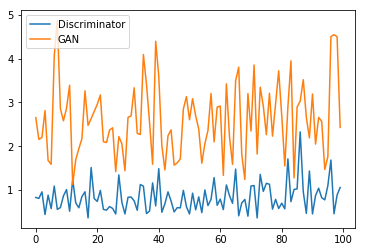

An Example from the Training Set: 


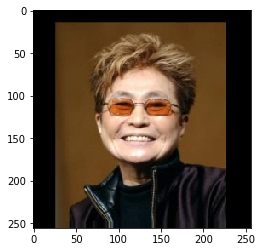

An Example from the Generator: 


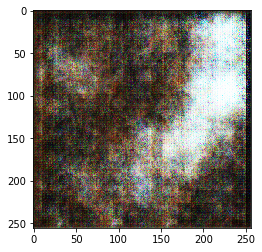

Prediction: [0.04631272]


--------------- Epoch: 5 ---------------
Discriminator loss: 0.71618664, GAN loss: 3.5217376

Discriminator loss: 0.524437, GAN loss: 1.4363216

Discriminator loss: 0.9701931, GAN loss: 1.8691101

Discriminator loss: 1.4464935, GAN loss: 2.7237942

Discriminator loss: 0.8766548, GAN loss: 3.2131455

Discriminator loss: 0.9027381, GAN loss: 1.5678163

Discriminator loss: 1.3849428, GAN loss: 3.2224095

Discriminator loss: 0.5825725, GAN loss: 2.677538

Discriminator loss: 0.6038436, GAN loss: 2.5807302

Loss History:


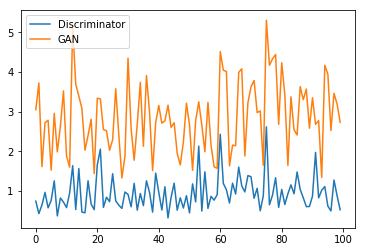

An Example from the Training Set: 


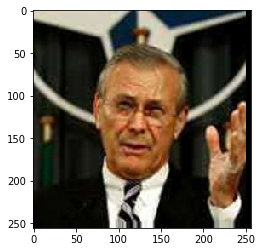

An Example from the Generator: 


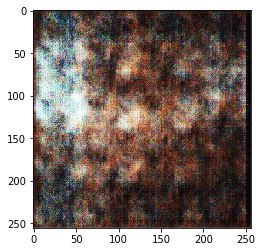

Prediction: [0.3578094]


--------------- Epoch: 6 ---------------
Discriminator loss: 0.7636329, GAN loss: 3.1045814

Discriminator loss: 0.5268973, GAN loss: 1.7922392

Discriminator loss: 0.74841195, GAN loss: 2.7987342

Discriminator loss: 0.5470767, GAN loss: 2.805288

Discriminator loss: 1.7764223, GAN loss: 3.660688

Discriminator loss: 0.71798354, GAN loss: 3.0983872

Discriminator loss: 0.8020398, GAN loss: 2.152015

Discriminator loss: 1.0540645, GAN loss: 4.1103745

Discriminator loss: 0.8097895, GAN loss: 3.6087964

Loss History:


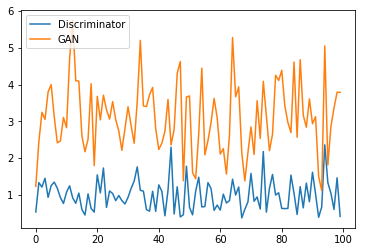

An Example from the Training Set: 


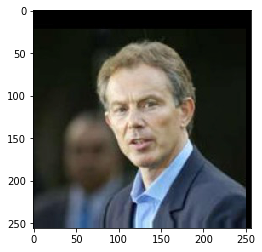

An Example from the Generator: 


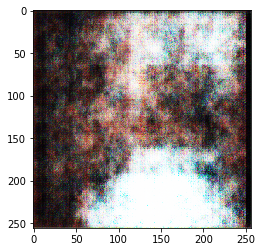

Prediction: [0.07965308]


--------------- Epoch: 7 ---------------
Discriminator loss: 0.491863, GAN loss: 1.6511338

Discriminator loss: 1.6114299, GAN loss: 2.8173199

Discriminator loss: 0.796281, GAN loss: 4.389291

Discriminator loss: 1.5729358, GAN loss: 3.6631653

Discriminator loss: 0.7866856, GAN loss: 2.439103

Discriminator loss: 0.59624135, GAN loss: 3.374413

Discriminator loss: 0.9065957, GAN loss: 6.0147276

Discriminator loss: 1.6152481, GAN loss: 1.81272

Discriminator loss: 0.8237683, GAN loss: 1.4620224

Loss History:


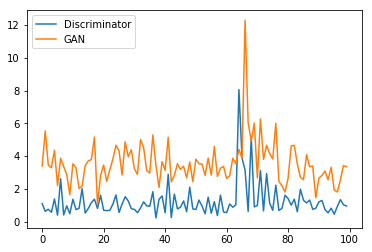

An Example from the Training Set: 


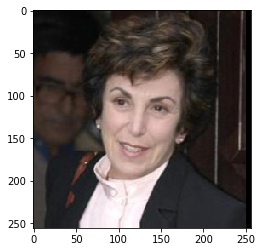

An Example from the Generator: 


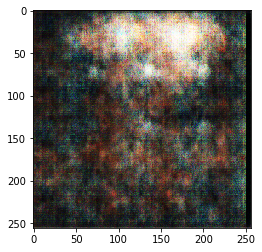

Prediction: [0.53729624]


--------------- Epoch: 8 ---------------
Discriminator loss: 1.0361003, GAN loss: 3.3701377

Discriminator loss: 0.7333225, GAN loss: 3.4545913

Discriminator loss: 0.54184425, GAN loss: 1.7398548

Discriminator loss: 0.71860707, GAN loss: 2.6949298

Discriminator loss: 0.71825176, GAN loss: 3.174252

Discriminator loss: 1.5849565, GAN loss: 0.8207781

Discriminator loss: 0.4857842, GAN loss: 2.2297869

Discriminator loss: 1.385659, GAN loss: 4.5132113

Discriminator loss: 1.6826607, GAN loss: 3.7753952

Loss History:


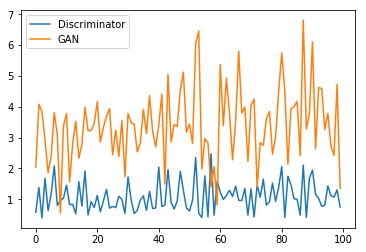

An Example from the Training Set: 


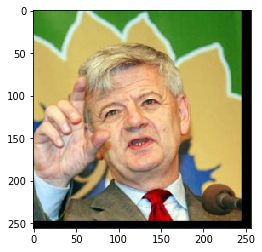

An Example from the Generator: 


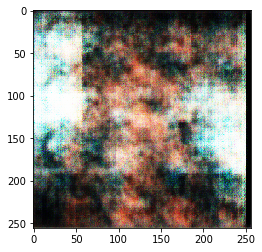

Prediction: [0.7954129]


--------------- Epoch: 9 ---------------
Discriminator loss: 0.9597548, GAN loss: 2.6895866

Discriminator loss: 1.5575392, GAN loss: 3.959787

Discriminator loss: 1.1632725, GAN loss: 2.6022074

Discriminator loss: 1.0296507, GAN loss: 3.8591151

Discriminator loss: 2.150319, GAN loss: 4.1443167

Discriminator loss: 0.7739167, GAN loss: 3.2224183

Discriminator loss: 1.1443088, GAN loss: 3.9803016

Discriminator loss: 0.8834626, GAN loss: 3.2394516

Discriminator loss: 1.3566468, GAN loss: 5.0795884

Loss History:


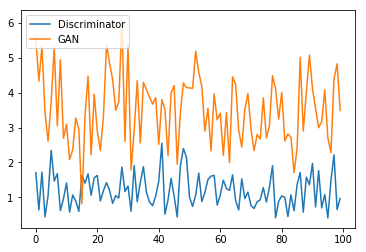

An Example from the Training Set: 


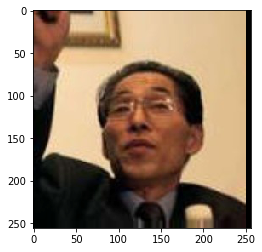

An Example from the Generator: 


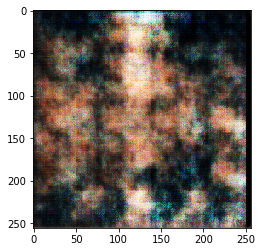

Prediction: [0.646203]


--------------- Epoch: 10 ---------------
Discriminator loss: 0.8227687, GAN loss: 3.3349862

Discriminator loss: 0.41639358, GAN loss: 3.375826

Discriminator loss: 0.7578174, GAN loss: 3.2934194

Discriminator loss: 0.6774224, GAN loss: 2.5530672

Discriminator loss: 0.9075588, GAN loss: 3.805594

Discriminator loss: 0.5599154, GAN loss: 3.3220005

Discriminator loss: 0.7783095, GAN loss: 2.582931

Discriminator loss: 0.45954186, GAN loss: 2.862624

Discriminator loss: 1.0799091, GAN loss: 1.8012778

Loss History:


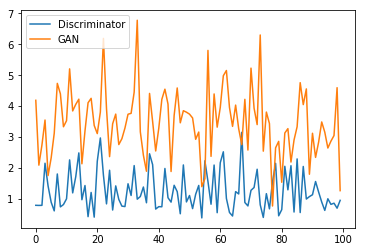

An Example from the Training Set: 


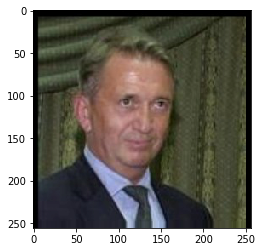

An Example from the Generator: 


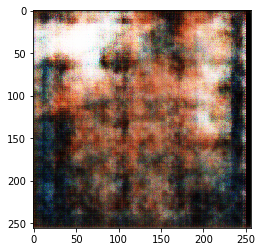

Prediction: [0.02543603]


--------------- Epoch: 11 ---------------
Discriminator loss: 0.60759944, GAN loss: 3.4938617

Discriminator loss: 0.74368423, GAN loss: 2.9426105

Discriminator loss: 1.6367586, GAN loss: 4.3298426

Discriminator loss: 2.1270497, GAN loss: 4.1801453

Discriminator loss: 1.7788874, GAN loss: 4.008642

Discriminator loss: 1.2208419, GAN loss: 1.1880642

Discriminator loss: 1.7480263, GAN loss: 9.889002

Discriminator loss: 14.467848, GAN loss: 1.1920933e-07

Discriminator loss: 14.011914, GAN loss: 1.1920933e-07

Loss History:


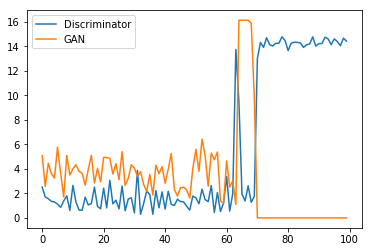

An Example from the Training Set: 


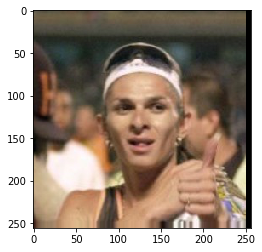

An Example from the Generator: 


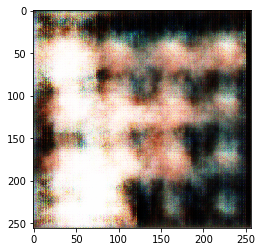

Prediction: [1.]


--------------- Epoch: 12 ---------------
Discriminator loss: 3.1947637, GAN loss: 12.658673

Discriminator loss: 3.1149733, GAN loss: 15.847006

Discriminator loss: 3.0302525, GAN loss: 8.131917

Discriminator loss: 1.0321423, GAN loss: 4.9125643

Discriminator loss: 0.45892876, GAN loss: 5.910559

Discriminator loss: 0.7001074, GAN loss: 5.0184183

Discriminator loss: 1.0670313, GAN loss: 2.0224123

Discriminator loss: 1.8753974, GAN loss: 1.9665842

Discriminator loss: 1.7739162, GAN loss: 3.6318288

Loss History:


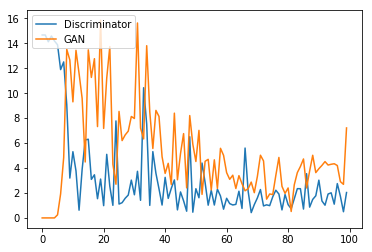

An Example from the Training Set: 


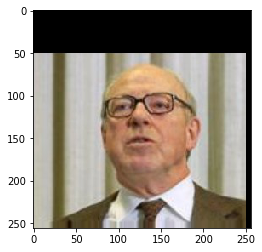

An Example from the Generator: 


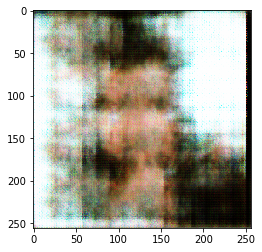

Prediction: [0.00052555]


--------------- Epoch: 13 ---------------
Discriminator loss: 0.63792866, GAN loss: 3.3939369

Discriminator loss: 0.9539118, GAN loss: 2.60315

Discriminator loss: 0.95947397, GAN loss: 2.416101

Discriminator loss: 1.4272554, GAN loss: 3.1915681

Discriminator loss: 1.0188042, GAN loss: 2.1414263

Discriminator loss: 1.2293539, GAN loss: 4.0146914

Discriminator loss: 1.8605648, GAN loss: 3.63274

Discriminator loss: 1.8863833, GAN loss: 3.8063595

Discriminator loss: 1.4728502, GAN loss: 3.6381125

Loss History:


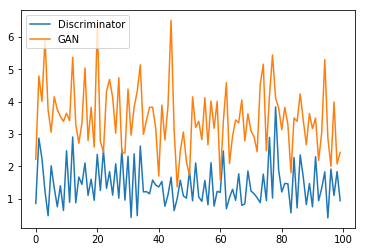

An Example from the Training Set: 


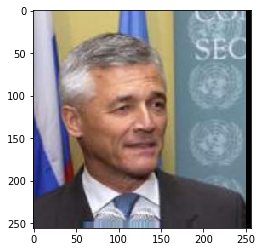

An Example from the Generator: 


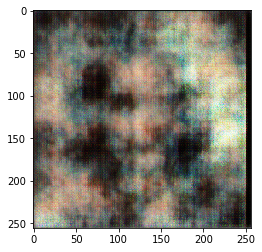

Prediction: [0.8645827]


--------------- Epoch: 14 ---------------
Discriminator loss: 2.612158, GAN loss: 4.216268

Discriminator loss: 1.4081403, GAN loss: 2.9124324

Discriminator loss: 2.0009854, GAN loss: 1.9920862

Discriminator loss: 1.5607408, GAN loss: 2.973129

Discriminator loss: 1.1943426, GAN loss: 4.947477

Discriminator loss: 1.4941531, GAN loss: 2.2021992

Discriminator loss: 0.42335397, GAN loss: 3.4879456

Discriminator loss: 3.357098, GAN loss: 3.2685611

Discriminator loss: 2.0392118, GAN loss: 3.855929

Loss History:


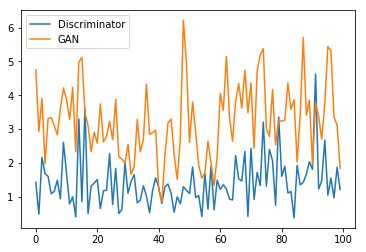

An Example from the Training Set: 


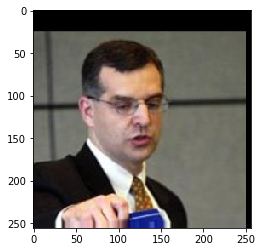

An Example from the Generator: 


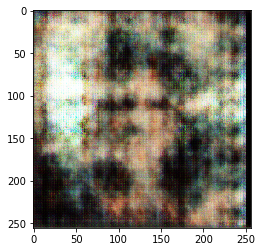

Prediction: [0.02926906]


--------------- Epoch: 15 ---------------
Discriminator loss: 0.67558694, GAN loss: 5.269674

Discriminator loss: 1.6960074, GAN loss: 5.0358534

Discriminator loss: 0.6063045, GAN loss: 4.251542

Discriminator loss: 2.1962957, GAN loss: 1.8092604

Discriminator loss: 1.2727046, GAN loss: 3.83837

Discriminator loss: 1.6083412, GAN loss: 7.26122

Discriminator loss: 1.6992376, GAN loss: 5.128028

Discriminator loss: 1.6423448, GAN loss: 2.9507766

Discriminator loss: 0.40677816, GAN loss: 2.0315852

Loss History:


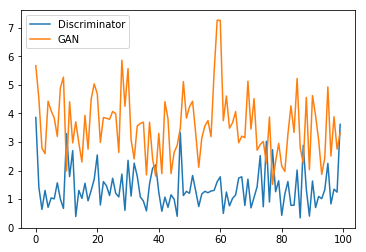

An Example from the Training Set: 


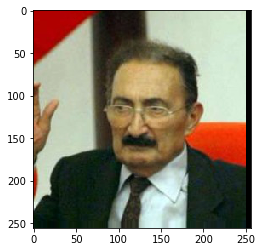

An Example from the Generator: 


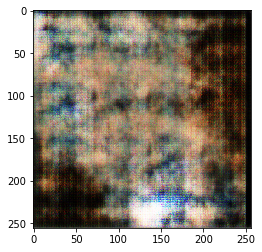

Prediction: [0.07497478]


--------------- Epoch: 16 ---------------
Discriminator loss: 1.6815894, GAN loss: 2.9626403

Discriminator loss: 0.8759202, GAN loss: 2.6115532

Discriminator loss: 1.8547999, GAN loss: 4.3366156

Discriminator loss: 1.5233891, GAN loss: 4.6367674

Discriminator loss: 2.8992274, GAN loss: 4.590392

Discriminator loss: 1.4555442, GAN loss: 2.7459092

Discriminator loss: 0.95342225, GAN loss: 4.8708143

Discriminator loss: 0.6297566, GAN loss: 2.2945778

Discriminator loss: 1.7713668, GAN loss: 4.10263

Loss History:


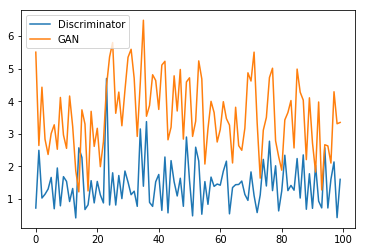

An Example from the Training Set: 


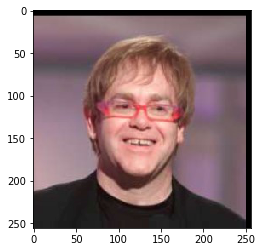

An Example from the Generator: 


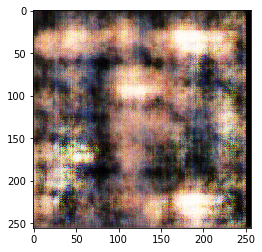

Prediction: [0.7431984]


--------------- Epoch: 17 ---------------
Discriminator loss: 1.2518227, GAN loss: 1.8531847

Discriminator loss: 1.0043417, GAN loss: 3.5466847

Discriminator loss: 0.4876074, GAN loss: 1.2777836

Discriminator loss: 0.9606822, GAN loss: 3.926152

Discriminator loss: 2.0591354, GAN loss: 5.493033

Discriminator loss: 1.7823441, GAN loss: 2.0578666

Discriminator loss: 1.6128832, GAN loss: 2.5993035

Discriminator loss: 1.9987147, GAN loss: 2.3807788

Discriminator loss: 1.018191, GAN loss: 5.007567

Loss History:


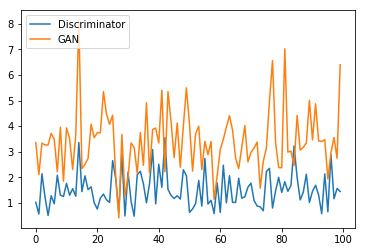

An Example from the Training Set: 


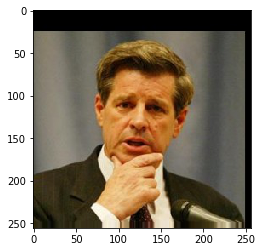

An Example from the Generator: 


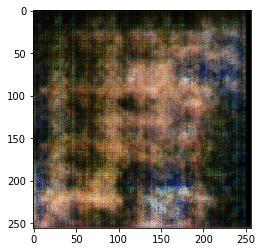

Prediction: [0.88580453]


--------------- Epoch: 18 ---------------
Discriminator loss: 0.85771704, GAN loss: 3.6272602

Discriminator loss: 1.1930867, GAN loss: 2.8901095

Discriminator loss: 0.36091098, GAN loss: 3.300671

Discriminator loss: 0.8559674, GAN loss: 2.4601676

Discriminator loss: 0.8565651, GAN loss: 3.2731118

Discriminator loss: 1.3424718, GAN loss: 4.630054

Discriminator loss: 0.9158099, GAN loss: 3.603147

Discriminator loss: 0.7369055, GAN loss: 2.863486

Discriminator loss: 0.9671448, GAN loss: 2.3472037

Loss History:


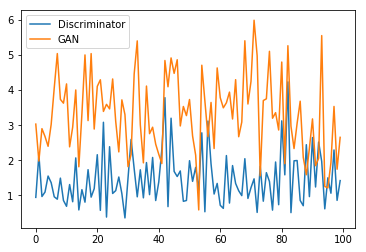

An Example from the Training Set: 


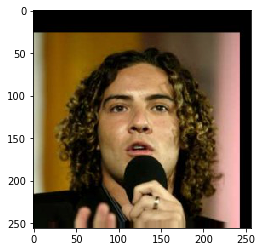

An Example from the Generator: 


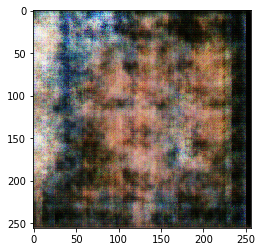

Prediction: [0.6793886]


--------------- Epoch: 19 ---------------
Discriminator loss: 2.0904155, GAN loss: 3.3451552

Discriminator loss: 2.141086, GAN loss: 5.34169

Discriminator loss: 0.6548525, GAN loss: 2.1932225

Discriminator loss: 1.6626987, GAN loss: 2.3812628

Discriminator loss: 1.700337, GAN loss: 3.1679206

Discriminator loss: 2.846681, GAN loss: 7.745014

Discriminator loss: 0.9175986, GAN loss: 2.0112324

Discriminator loss: 1.4804822, GAN loss: 2.961578

Discriminator loss: 1.2059389, GAN loss: 4.818461

Loss History:


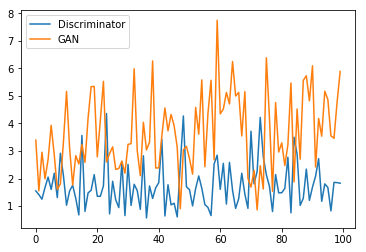

An Example from the Training Set: 


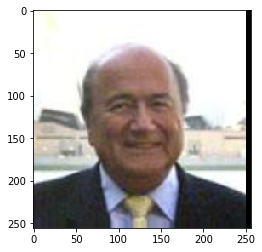

An Example from the Generator: 


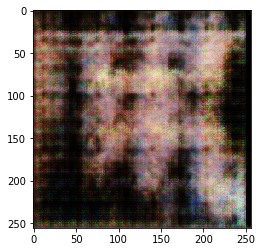

Prediction: [0.13585828]


--------------- Epoch: 20 ---------------
Discriminator loss: 2.2537131, GAN loss: 2.1148846

Discriminator loss: 1.6355579, GAN loss: 5.205661

Discriminator loss: 0.7804851, GAN loss: 2.0684

Discriminator loss: 1.4302136, GAN loss: 4.687942

Discriminator loss: 2.5810814, GAN loss: 7.239957

Discriminator loss: 1.6871929, GAN loss: 3.8292966

Discriminator loss: 2.853029, GAN loss: 3.6664124

Discriminator loss: 1.5343584, GAN loss: 3.842376

Discriminator loss: 0.74424547, GAN loss: 0.7569934

Loss History:


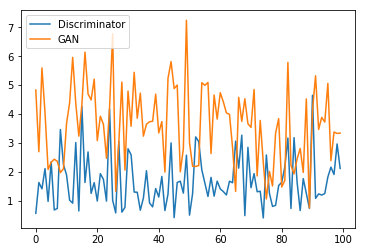

An Example from the Training Set: 


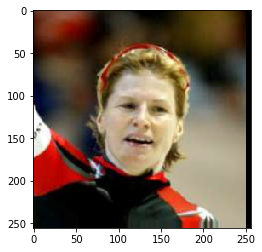

An Example from the Generator: 


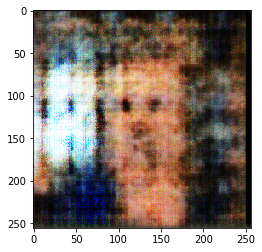

Prediction: [0.00025172]


--------------- Epoch: 21 ---------------
Discriminator loss: 0.3294654, GAN loss: 3.926824

Discriminator loss: 1.1676072, GAN loss: 2.14185

Discriminator loss: 2.680224, GAN loss: 3.4053707

Discriminator loss: 3.3862672, GAN loss: 3.9739196

Discriminator loss: 1.2629397, GAN loss: 4.5463343

Discriminator loss: 0.6687312, GAN loss: 4.1399345

Discriminator loss: 14.710716, GAN loss: 1.1920933e-07

Discriminator loss: 13.768095, GAN loss: 1.4305118e-07

Discriminator loss: 14.790074, GAN loss: 1.6689306e-07

Loss History:


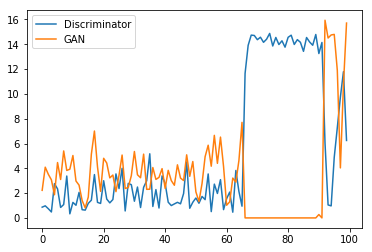

An Example from the Training Set: 


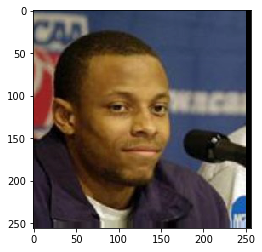

An Example from the Generator: 


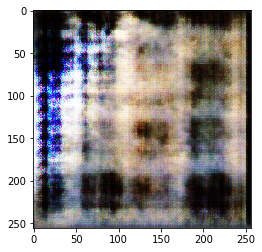

Prediction: [1.]


--------------- Epoch: 22 ---------------
Discriminator loss: 1.8129838, GAN loss: 8.706916

Discriminator loss: 9.596949, GAN loss: 6.4300394

Discriminator loss: 5.347657, GAN loss: 9.251992

Discriminator loss: 4.6390543, GAN loss: 10.746997

Discriminator loss: 5.195382, GAN loss: 13.524017

Discriminator loss: 2.1904516, GAN loss: 10.408747

Discriminator loss: 4.927457, GAN loss: 8.892263

Discriminator loss: 3.9186535, GAN loss: 6.2605486

Discriminator loss: 3.794508, GAN loss: 6.820218

Loss History:


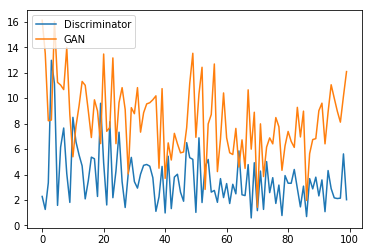

An Example from the Training Set: 


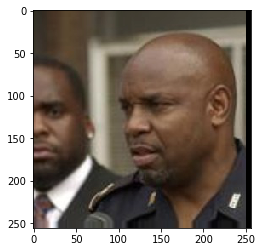

An Example from the Generator: 


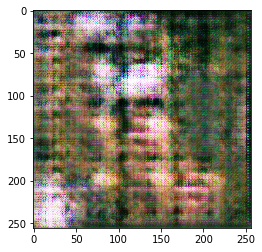

Prediction: [0.01617433]


--------------- Epoch: 23 ---------------
Discriminator loss: 1.9918041, GAN loss: 8.726102

Discriminator loss: 3.8099384, GAN loss: 4.986038

Discriminator loss: 4.670747, GAN loss: 10.504971

Discriminator loss: 3.5370126, GAN loss: 6.516614

Discriminator loss: 4.8058767, GAN loss: 8.059987

Discriminator loss: 3.2772815, GAN loss: 8.602012

Discriminator loss: 5.768649, GAN loss: 5.576

Discriminator loss: 2.0246608, GAN loss: 6.4371514

Discriminator loss: 2.3936126, GAN loss: 5.617606

Loss History:


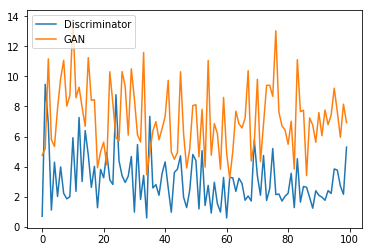

An Example from the Training Set: 


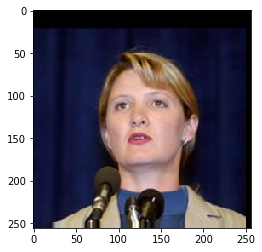

An Example from the Generator: 


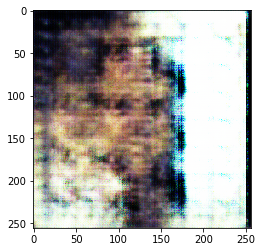

Prediction: [0.99965155]


--------------- Epoch: 24 ---------------
Discriminator loss: 1.9149532, GAN loss: 6.939692

Discriminator loss: 2.7603042, GAN loss: 5.4373627

Discriminator loss: 3.7800598, GAN loss: 7.443628

Discriminator loss: 3.8642259, GAN loss: 7.4671235

Discriminator loss: 2.379372, GAN loss: 6.8684416

Discriminator loss: 4.225855, GAN loss: 9.6399975

Discriminator loss: 8.351964, GAN loss: 10.234026

Discriminator loss: 2.7316926, GAN loss: 6.88399

Discriminator loss: 2.5394926, GAN loss: 9.635894

Loss History:


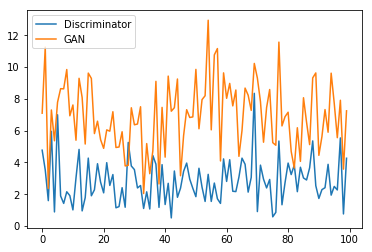

An Example from the Training Set: 


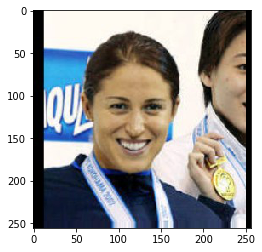

An Example from the Generator: 


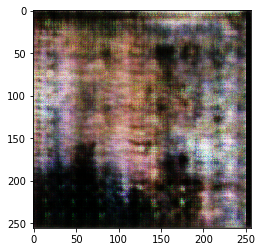

Prediction: [0.00488237]


--------------- Epoch: 25 ---------------
Discriminator loss: 2.046471, GAN loss: 7.0774217

Discriminator loss: 1.7885879, GAN loss: 4.8340583

Discriminator loss: 5.294973, GAN loss: 5.891266

Discriminator loss: 5.122142, GAN loss: 3.6952336

Discriminator loss: 0.9366878, GAN loss: 2.2776678

Discriminator loss: 0.5751169, GAN loss: 6.8072343

Discriminator loss: 1.3001134, GAN loss: 6.6546125

Discriminator loss: 2.4437797, GAN loss: 4.5510187

Discriminator loss: 2.3197267, GAN loss: 3.34887

Loss History:


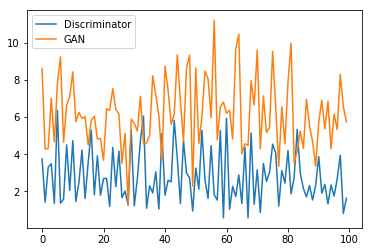

An Example from the Training Set: 


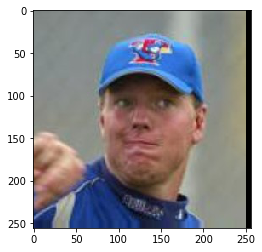

An Example from the Generator: 


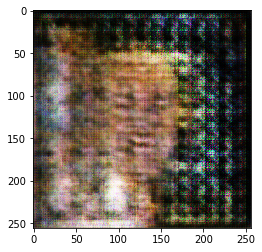

Prediction: [0.3456355]


--------------- Epoch: 26 ---------------
Discriminator loss: 2.073828, GAN loss: 3.1014817

Discriminator loss: 4.5757356, GAN loss: 5.6177673

Discriminator loss: 0.76530784, GAN loss: 8.823645

Discriminator loss: 4.6490407, GAN loss: 9.772466

Discriminator loss: 2.4745052, GAN loss: 8.750863

Discriminator loss: 0.7788993, GAN loss: 5.5301833

Discriminator loss: 2.9475121, GAN loss: 5.430322

Discriminator loss: 2.3517108, GAN loss: 6.205261

Discriminator loss: 2.2386146, GAN loss: 5.5198326

Loss History:


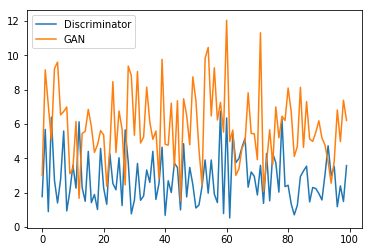

An Example from the Training Set: 


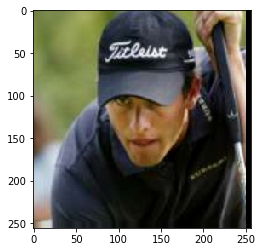

An Example from the Generator: 


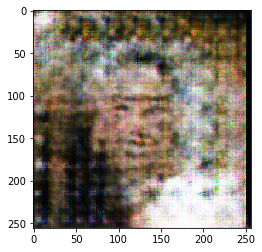

Prediction: [0.0027087]


--------------- Epoch: 27 ---------------
Discriminator loss: 3.573466, GAN loss: 5.252476

Discriminator loss: 1.3065732, GAN loss: 3.897667

Discriminator loss: 4.1292024, GAN loss: 5.021215

Discriminator loss: 3.7225685, GAN loss: 7.24203

Discriminator loss: 0.82941276, GAN loss: 4.843566

Discriminator loss: 2.2605624, GAN loss: 4.874329

Discriminator loss: 2.1413674, GAN loss: 3.9716873

Discriminator loss: 2.77245, GAN loss: 6.102451

Discriminator loss: 2.4057472, GAN loss: 2.0232759

Loss History:


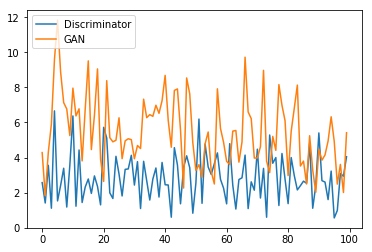

An Example from the Training Set: 


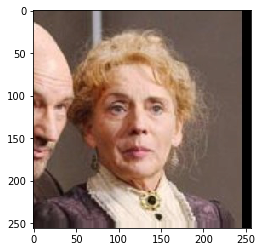

An Example from the Generator: 


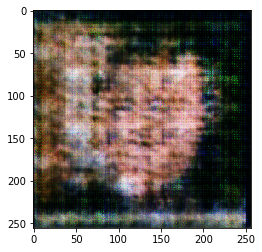

Prediction: [0.00499982]


--------------- Epoch: 28 ---------------
Discriminator loss: 0.76220757, GAN loss: 2.7668908

Discriminator loss: 2.9577982, GAN loss: 7.61652

Discriminator loss: 4.3598146, GAN loss: 5.8208003

Discriminator loss: 0.8309188, GAN loss: 4.9536624

Discriminator loss: 1.9567711, GAN loss: 8.687819

Discriminator loss: 2.5711288, GAN loss: 5.819603

Discriminator loss: 2.4573643, GAN loss: 5.405376

Discriminator loss: 3.4205823, GAN loss: 5.025968

Discriminator loss: 2.5135605, GAN loss: 3.758342

Loss History:


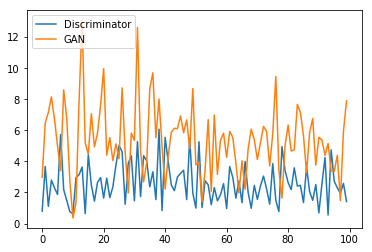

An Example from the Training Set: 


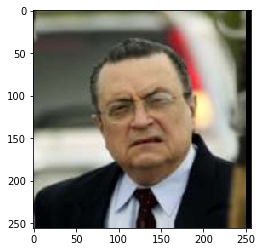

An Example from the Generator: 


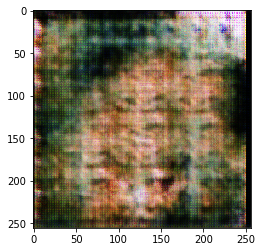

Prediction: [0.9993375]


--------------- Epoch: 29 ---------------
Discriminator loss: 6.086934, GAN loss: 1.1974192

Discriminator loss: 3.365022, GAN loss: 7.0535746

Discriminator loss: 1.9251379, GAN loss: 4.6534104

Discriminator loss: 1.608352, GAN loss: 2.7475147

Discriminator loss: 1.827668, GAN loss: 2.6651378

Discriminator loss: 2.343504, GAN loss: 8.859824

Discriminator loss: 1.8041309, GAN loss: 3.4150596

Discriminator loss: 2.4393287, GAN loss: 1.8939526

Discriminator loss: 2.7233548, GAN loss: 5.448333

Loss History:


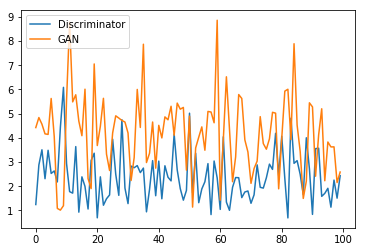

An Example from the Training Set: 


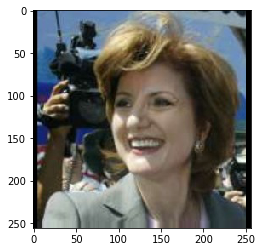

An Example from the Generator: 


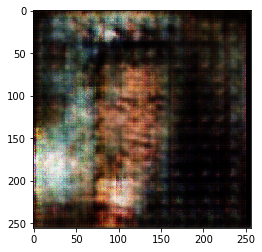

Prediction: [0.00515079]


--------------- Epoch: 30 ---------------
Discriminator loss: 0.9426336, GAN loss: 2.6473145

Discriminator loss: 1.1347587, GAN loss: 3.8953767

Discriminator loss: 3.431844, GAN loss: 3.9290347

Discriminator loss: 4.8370094, GAN loss: 4.031514

Discriminator loss: 3.73228, GAN loss: 6.752083

Discriminator loss: 2.4462562, GAN loss: 5.355638

Discriminator loss: 5.573919, GAN loss: 2.9191701

Discriminator loss: 1.7723358, GAN loss: 6.4986854

Discriminator loss: 1.8127571, GAN loss: 2.2274265

Loss History:


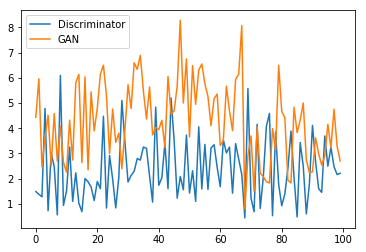

An Example from the Training Set: 


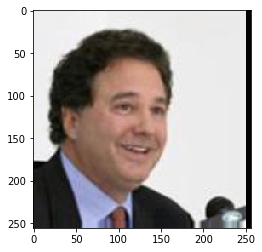

An Example from the Generator: 


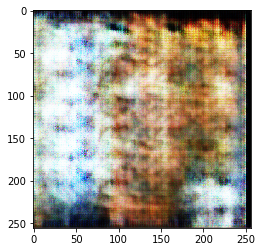

Prediction: [0.9986993]


--------------- Epoch: 31 ---------------
Discriminator loss: 2.9564705, GAN loss: 2.794243

Discriminator loss: 2.578774, GAN loss: 4.452769

Discriminator loss: 2.034139, GAN loss: 2.0263488

Discriminator loss: 2.6237001, GAN loss: 7.7404127

Discriminator loss: 1.9380627, GAN loss: 4.754885

Discriminator loss: 3.7041755, GAN loss: 3.3697262

Discriminator loss: 1.2828116, GAN loss: 3.4587455

Discriminator loss: 2.645336, GAN loss: 3.205604

Discriminator loss: 1.9561363, GAN loss: 7.1501594

Loss History:


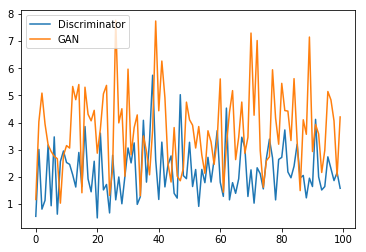

An Example from the Training Set: 


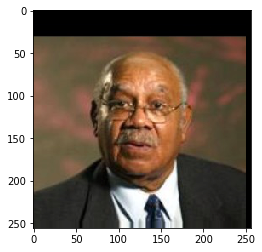

An Example from the Generator: 


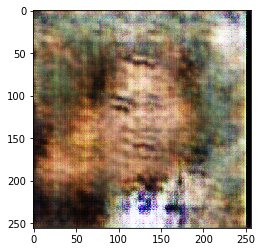

Prediction: [0.71901643]


--------------- Epoch: 32 ---------------
Discriminator loss: 4.4901266, GAN loss: 3.2568932

Discriminator loss: 2.1943245, GAN loss: 2.883775

Discriminator loss: 1.435784, GAN loss: 3.5560513

Discriminator loss: 2.3438306, GAN loss: 2.488809

Discriminator loss: 2.066195, GAN loss: 1.8748264

Discriminator loss: 3.3749187, GAN loss: 4.813681

Discriminator loss: 4.4602685, GAN loss: 2.2896922

Discriminator loss: 3.6447022, GAN loss: 1.8034118

Discriminator loss: 1.991012, GAN loss: 4.106486

Loss History:


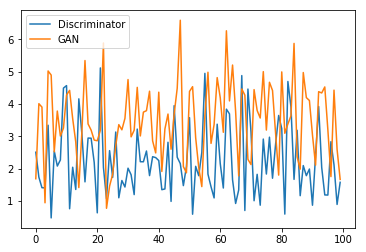

An Example from the Training Set: 


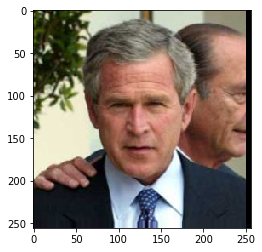

An Example from the Generator: 


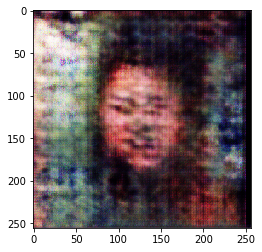

Prediction: [0.99571806]


--------------- Epoch: 33 ---------------
Discriminator loss: 2.9159882, GAN loss: 4.291339

Discriminator loss: 2.099864, GAN loss: 2.8223214

Discriminator loss: 2.4711728, GAN loss: 4.8390255

Discriminator loss: 1.9189167, GAN loss: 2.1361754

Discriminator loss: 2.2765696, GAN loss: 3.3977692

Discriminator loss: 2.37919, GAN loss: 4.510389

Discriminator loss: 1.809179, GAN loss: 7.554811

Discriminator loss: 2.7160962, GAN loss: 3.0678463

Discriminator loss: 2.1589818, GAN loss: 2.8155203

Loss History:


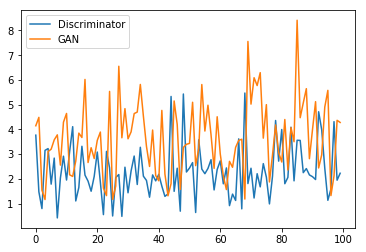

An Example from the Training Set: 


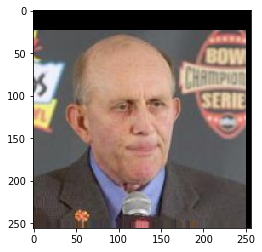

An Example from the Generator: 


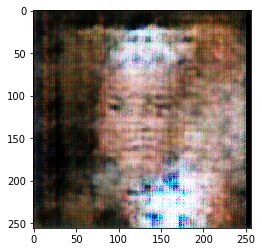

Prediction: [0.01500039]


--------------- Epoch: 34 ---------------
Discriminator loss: 1.9366614, GAN loss: 4.081656

Discriminator loss: 2.9885669, GAN loss: 5.0453644

Discriminator loss: 1.8477274, GAN loss: 0.8960169

Discriminator loss: 3.0120816, GAN loss: 5.141431

Discriminator loss: 1.288794, GAN loss: 5.413656

Discriminator loss: 2.1457925, GAN loss: 2.055011

Discriminator loss: 1.1062076, GAN loss: 1.6583515

Discriminator loss: 2.0201402, GAN loss: 3.673325

Discriminator loss: 3.6341598, GAN loss: 1.5335296

Loss History:


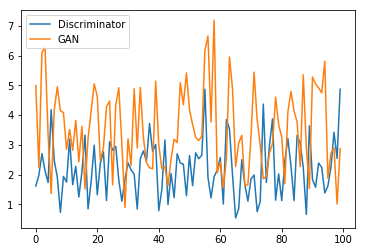

An Example from the Training Set: 


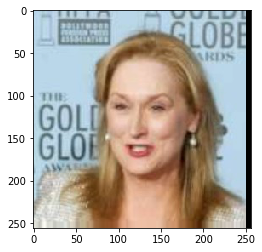

An Example from the Generator: 


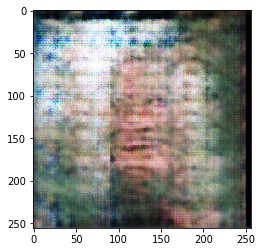

Prediction: [0.999099]


--------------- Epoch: 35 ---------------
Discriminator loss: 3.2146842, GAN loss: 2.0329244

Discriminator loss: 1.2095416, GAN loss: 3.2035153

Discriminator loss: 2.116034, GAN loss: 3.7007732

Discriminator loss: 0.63356334, GAN loss: 2.3624501

Discriminator loss: 2.0861857, GAN loss: 3.786235

Discriminator loss: 4.172164, GAN loss: 4.943804

Discriminator loss: 2.5919602, GAN loss: 3.5522285

Discriminator loss: 1.0069424, GAN loss: 6.0314817

Discriminator loss: 3.507553, GAN loss: 2.6078768

Loss History:


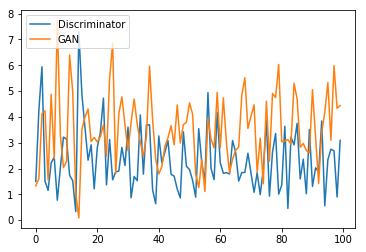

An Example from the Training Set: 


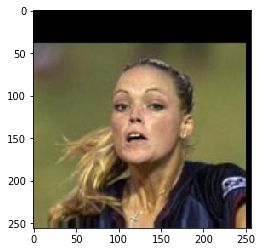

An Example from the Generator: 


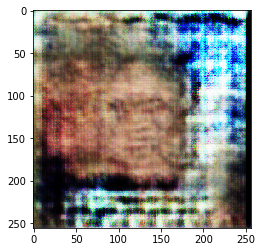

Prediction: [0.9456739]


--------------- Epoch: 36 ---------------
Discriminator loss: 0.97033846, GAN loss: 2.2518144

Discriminator loss: 2.743526, GAN loss: 2.6827846

Discriminator loss: 1.577525, GAN loss: 3.935592

Discriminator loss: 4.104184, GAN loss: 4.2738748

Discriminator loss: 5.21663, GAN loss: 2.6997166

Discriminator loss: 1.104784, GAN loss: 3.046092

Discriminator loss: 3.4661446, GAN loss: 2.8583977

Discriminator loss: 3.710566, GAN loss: 3.3798096

Discriminator loss: 1.5009001, GAN loss: 1.890119

Loss History:


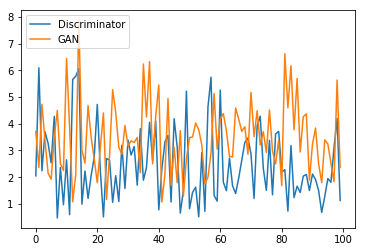

An Example from the Training Set: 


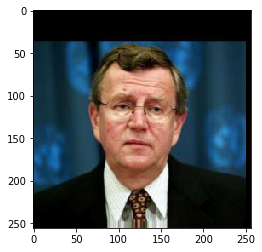

An Example from the Generator: 


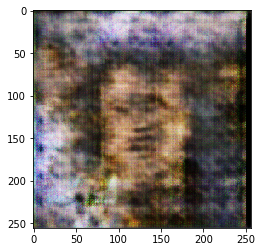

Prediction: [1.9002377e-06]


--------------- Epoch: 37 ---------------
Discriminator loss: 1.7658392, GAN loss: 3.6353393

Discriminator loss: 2.2466402, GAN loss: 2.7961617

Discriminator loss: 3.4904466, GAN loss: 2.3026633

Discriminator loss: 1.7385019, GAN loss: 3.3590896

Discriminator loss: 1.1089197, GAN loss: 4.3311744

Discriminator loss: 2.8897076, GAN loss: 3.1036048

Discriminator loss: 2.6711564, GAN loss: 1.9954987

Discriminator loss: 1.484327, GAN loss: 4.8342576

Discriminator loss: 3.0501575, GAN loss: 3.682349

Loss History:


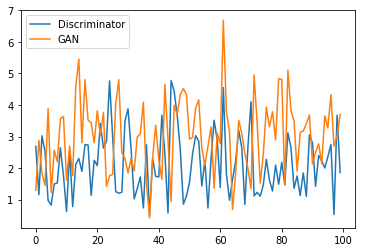

An Example from the Training Set: 


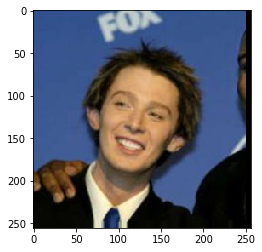

An Example from the Generator: 


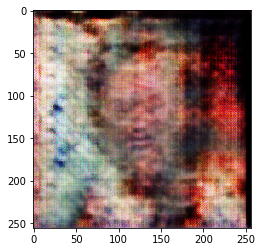

Prediction: [0.034275]


--------------- Epoch: 38 ---------------
Discriminator loss: 0.87720585, GAN loss: 3.713665

Discriminator loss: 1.3105274, GAN loss: 4.705989

Discriminator loss: 1.2164437, GAN loss: 6.0270143

Discriminator loss: 1.8815308, GAN loss: 1.6715815

Discriminator loss: 2.9930108, GAN loss: 4.040108

Discriminator loss: 6.2831564, GAN loss: 7.438451

Discriminator loss: 3.1735785, GAN loss: 6.1450124

Discriminator loss: 5.143361, GAN loss: 3.5631797

Discriminator loss: 3.5128582, GAN loss: 4.0769777

Loss History:


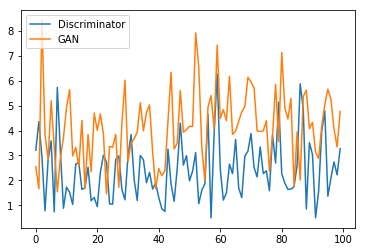

An Example from the Training Set: 


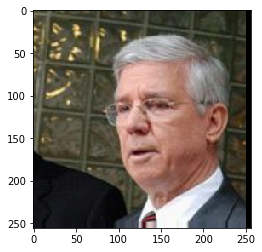

An Example from the Generator: 


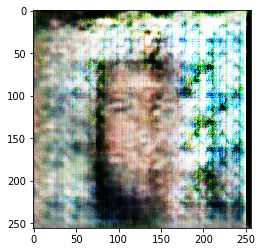

Prediction: [1.016003e-16]


--------------- Epoch: 39 ---------------
Discriminator loss: 1.0598482, GAN loss: 3.3252594

Discriminator loss: 2.7281013, GAN loss: 3.62651

Discriminator loss: 2.9412036, GAN loss: 3.9040895

Discriminator loss: 1.3077565, GAN loss: 3.7738144

Discriminator loss: 4.6832457, GAN loss: 2.0721593

Discriminator loss: 0.78601027, GAN loss: 4.4454927

Discriminator loss: 2.5954056, GAN loss: 4.4184337

Discriminator loss: 2.056004, GAN loss: 1.4017231

Discriminator loss: 2.319038, GAN loss: 1.5643011

Loss History:


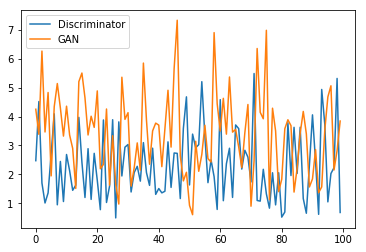

An Example from the Training Set: 


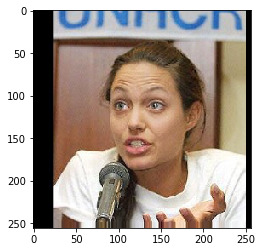

An Example from the Generator: 


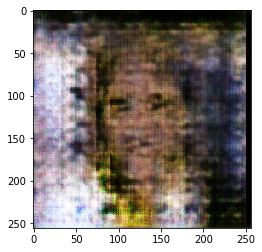

Prediction: [1.554547e-09]


--------------- Epoch: 40 ---------------
Discriminator loss: 1.5471013, GAN loss: 1.6019843

Discriminator loss: 1.5785859, GAN loss: 4.1321344

Discriminator loss: 2.9683852, GAN loss: 3.9459634

Discriminator loss: 0.9299661, GAN loss: 1.9300734

Discriminator loss: 0.8104655, GAN loss: 0.41825837

Discriminator loss: 1.6381419, GAN loss: 2.7122893

Discriminator loss: 1.6863041, GAN loss: 2.8482144

Discriminator loss: 2.9018764, GAN loss: 4.617219

Discriminator loss: 1.4992642, GAN loss: 4.526781

Loss History:


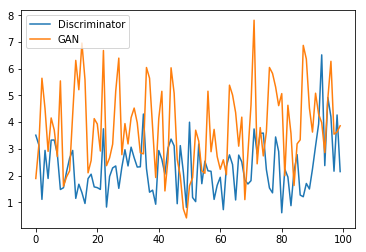

An Example from the Training Set: 


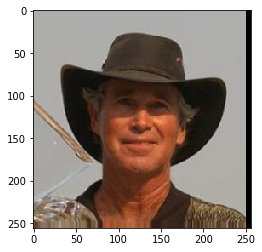

An Example from the Generator: 


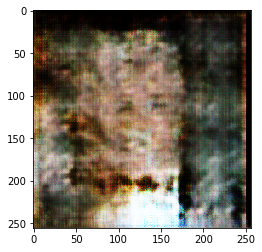

Prediction: [7.466291e-07]


--------------- Epoch: 41 ---------------
Discriminator loss: 1.6929379, GAN loss: 1.4856874

Discriminator loss: 1.0091636, GAN loss: 3.851083

Discriminator loss: 2.6058037, GAN loss: 4.336871

Discriminator loss: 3.529602, GAN loss: 4.988749

Discriminator loss: 2.6044686, GAN loss: 2.8349242

Discriminator loss: 3.771122, GAN loss: 2.5416007

Discriminator loss: 1.6559229, GAN loss: 2.8870616

Discriminator loss: 1.4674544, GAN loss: 2.5972404

Discriminator loss: 5.378314, GAN loss: 1.6786693

Loss History:


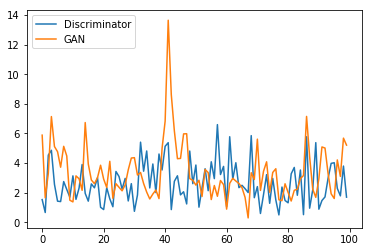

An Example from the Training Set: 


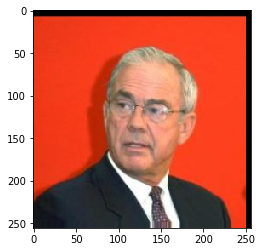

An Example from the Generator: 


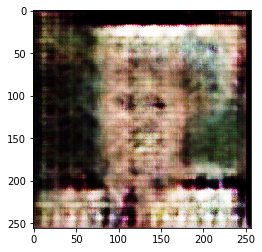

Prediction: [1.03282306e-10]


--------------- Epoch: 42 ---------------
Discriminator loss: 1.8413603, GAN loss: 3.557965

Discriminator loss: 4.5264435, GAN loss: 4.4808455

Discriminator loss: 3.2041023, GAN loss: 2.2348323

Discriminator loss: 1.2108195, GAN loss: 3.5310874

Discriminator loss: 2.4101605, GAN loss: 3.6639156

Discriminator loss: 2.7343748, GAN loss: 3.5944011

Discriminator loss: 1.0904425, GAN loss: 2.7941794

Discriminator loss: 2.3336213, GAN loss: 3.557227

Discriminator loss: 1.9643974, GAN loss: 2.767762

Loss History:


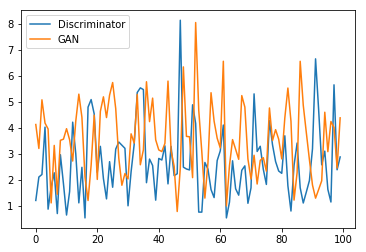

An Example from the Training Set: 


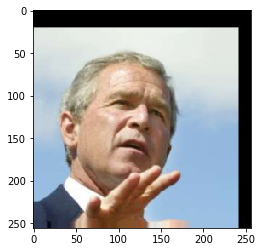

An Example from the Generator: 


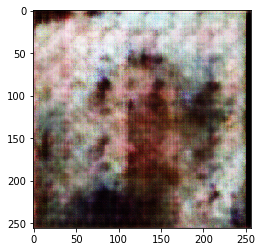

Prediction: [5.155647e-07]


--------------- Epoch: 43 ---------------
Discriminator loss: 2.9346802, GAN loss: 3.8384814

Discriminator loss: 1.510966, GAN loss: 4.804341

Discriminator loss: 6.2982755, GAN loss: 2.3352518

Discriminator loss: 1.2771294, GAN loss: 4.0801497

Discriminator loss: 0.8805796, GAN loss: 3.560004

Discriminator loss: 4.608396, GAN loss: 3.8741803

Discriminator loss: 0.85903215, GAN loss: 5.20436

Discriminator loss: 3.3232098, GAN loss: 4.2191563

Discriminator loss: 0.7066438, GAN loss: 2.3782532

Loss History:


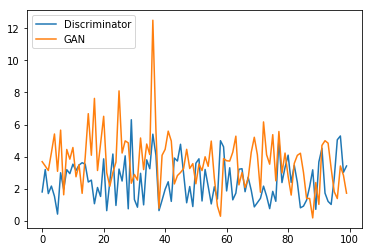

An Example from the Training Set: 


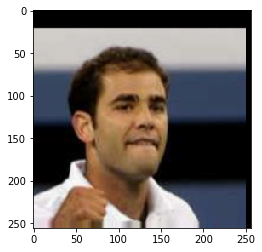

An Example from the Generator: 


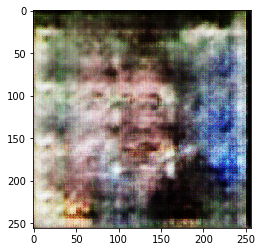

Prediction: [5.499755e-09]


--------------- Epoch: 44 ---------------
Discriminator loss: 3.5323167, GAN loss: 2.9691925

Discriminator loss: 0.97178364, GAN loss: 3.7591164

Discriminator loss: 2.0680633, GAN loss: 8.2061825

Discriminator loss: 0.9782613, GAN loss: 4.609593

Discriminator loss: 0.51505816, GAN loss: 2.6299977

Discriminator loss: 2.0954227, GAN loss: 1.7596575

Discriminator loss: 2.510422, GAN loss: 1.5730395

Discriminator loss: 4.2782135, GAN loss: 2.3059285

Discriminator loss: 3.4078496, GAN loss: 5.5121007

Loss History:


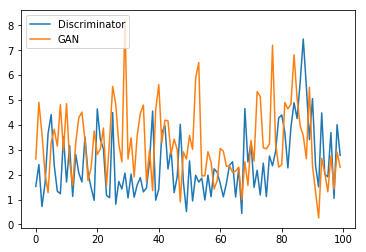

An Example from the Training Set: 


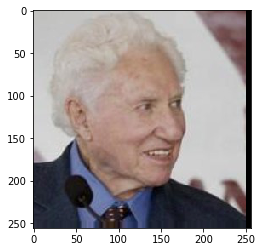

An Example from the Generator: 


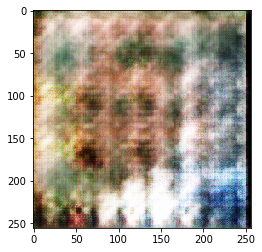

Prediction: [1.5410511e-11]


--------------- Epoch: 45 ---------------
Discriminator loss: 1.7747307, GAN loss: 2.843407

Discriminator loss: 2.3614552, GAN loss: 3.6398094

Discriminator loss: 0.91510296, GAN loss: 3.7691345

Discriminator loss: 2.9237244, GAN loss: 4.592229

Discriminator loss: 1.7830925, GAN loss: 3.1515841

Discriminator loss: 1.7082316, GAN loss: 1.4567926

Discriminator loss: 3.020596, GAN loss: 2.032818

Discriminator loss: 3.3584266, GAN loss: 3.9819152

Discriminator loss: 3.6874988, GAN loss: 3.074063

Loss History:


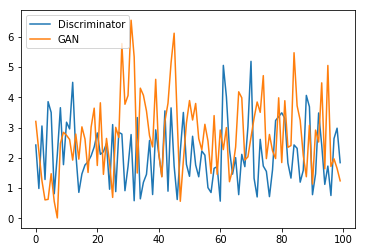

An Example from the Training Set: 


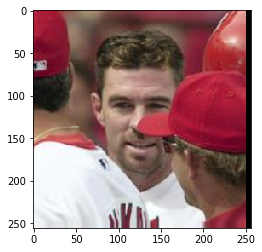

An Example from the Generator: 


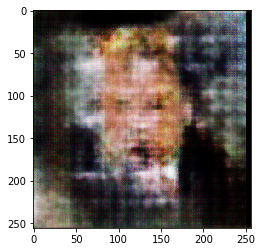

Prediction: [4.977302e-13]


--------------- Epoch: 46 ---------------
Discriminator loss: 2.3283954, GAN loss: 2.229279

Discriminator loss: 3.4498825, GAN loss: 2.4353986

Discriminator loss: 13.901746, GAN loss: 9.1791514e-07

Discriminator loss: 14.127829, GAN loss: 1.1920933e-07

Discriminator loss: 13.855741, GAN loss: 1.1920933e-07

Discriminator loss: 14.201904, GAN loss: 1.1920933e-07

Discriminator loss: 14.596823, GAN loss: 1.1920933e-07

Discriminator loss: 14.722278, GAN loss: 1.1920933e-07

Discriminator loss: 14.290538, GAN loss: 1.1920933e-07

Loss History:


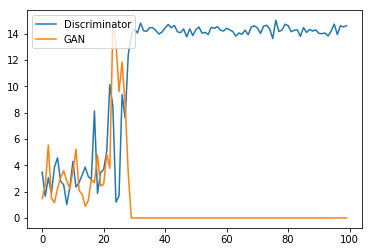

An Example from the Training Set: 


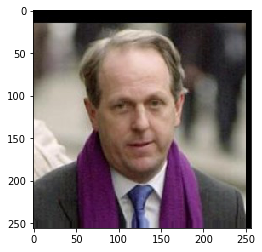

An Example from the Generator: 


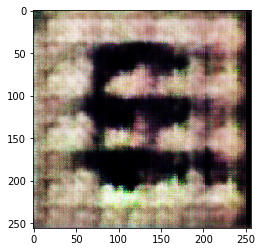

Prediction: [8.3742116e-14]


--------------- Epoch: 47 ---------------
Discriminator loss: 14.37231, GAN loss: 1.1920933e-07

Discriminator loss: 14.383649, GAN loss: 1.1920933e-07

Discriminator loss: 4.7770844, GAN loss: 3.6747425

Discriminator loss: 4.3793173, GAN loss: 4.8644953

Discriminator loss: 5.610555, GAN loss: 8.724841

Discriminator loss: 3.403335, GAN loss: 6.8706765

Discriminator loss: 2.9482648, GAN loss: 4.492585

Discriminator loss: 2.4047697, GAN loss: 3.2890065

Discriminator loss: 2.2513096, GAN loss: 2.4768221

Loss History:


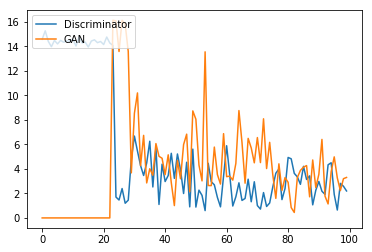

An Example from the Training Set: 


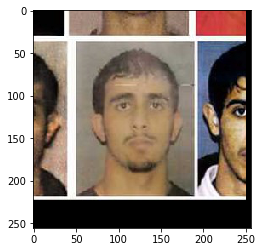

An Example from the Generator: 


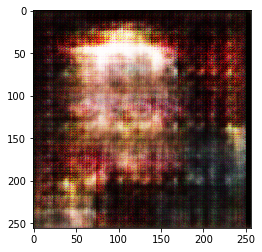

Prediction: [1.7742269e-14]


--------------- Epoch: 48 ---------------
Discriminator loss: 2.0763707, GAN loss: 3.4624946

Discriminator loss: 2.0864048, GAN loss: 4.275545

Discriminator loss: 2.153497, GAN loss: 2.9511864

Discriminator loss: 2.481773, GAN loss: 3.3545768

Discriminator loss: 4.147383, GAN loss: 4.589809

Discriminator loss: 3.174635, GAN loss: 1.8610785

Discriminator loss: 0.94319916, GAN loss: 1.8555927

Discriminator loss: 2.8356013, GAN loss: 2.7802804

Discriminator loss: 3.567302, GAN loss: 2.011639

Loss History:


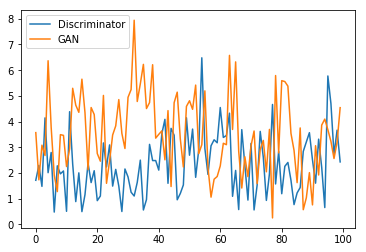

An Example from the Training Set: 


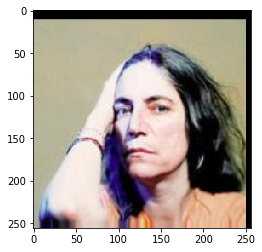

An Example from the Generator: 


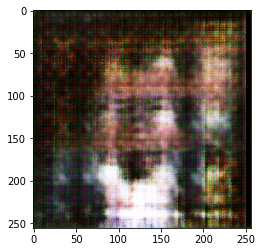

Prediction: [7.89685e-14]


--------------- Epoch: 49 ---------------
Discriminator loss: 2.3614366, GAN loss: 2.3943594

Discriminator loss: 1.7956692, GAN loss: 8.216119

Discriminator loss: 1.3861395, GAN loss: 2.7040648

Discriminator loss: 3.0474696, GAN loss: 4.0796976

Discriminator loss: 3.4655602, GAN loss: 2.6375914

Discriminator loss: 4.3617477, GAN loss: 0.48888174

Discriminator loss: 2.2518287, GAN loss: 2.7547247

Discriminator loss: 2.3701046, GAN loss: 4.686923

Discriminator loss: 0.69103855, GAN loss: 5.882837

Loss History:


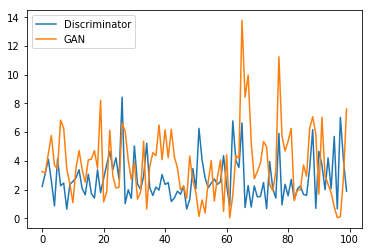

An Example from the Training Set: 


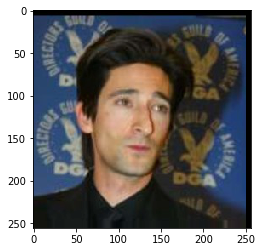

An Example from the Generator: 


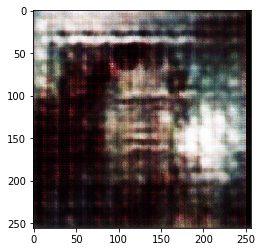

Prediction: [5.2981664e-14]


--------------- Epoch: 50 ---------------
Discriminator loss: 2.9535956, GAN loss: 3.4822574

Discriminator loss: 1.6484642, GAN loss: 5.754094

Discriminator loss: 1.1132376, GAN loss: 4.7032022

Discriminator loss: 5.419482, GAN loss: 1.8134743

Discriminator loss: 3.910479, GAN loss: 3.9730167

Discriminator loss: 1.9321973, GAN loss: 5.5958285

Discriminator loss: 1.0258986, GAN loss: 5.227567

Discriminator loss: 1.3108242, GAN loss: 3.3266723

Discriminator loss: 3.7501838, GAN loss: 2.2630649

Loss History:


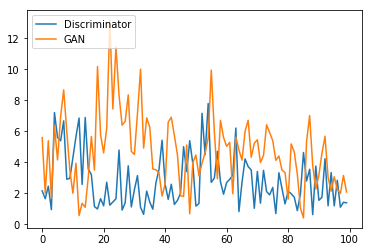

An Example from the Training Set: 


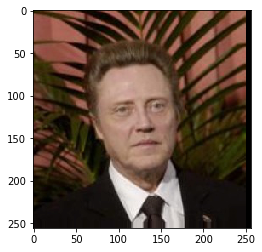

An Example from the Generator: 


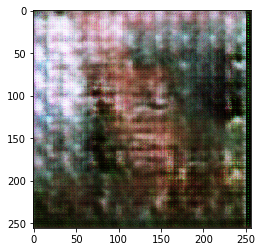

Prediction: [4.8958365e-14]


--------------- Epoch: 51 ---------------
Discriminator loss: 1.5895675, GAN loss: 2.6727962

Discriminator loss: 3.7024086, GAN loss: 1.0691464

Discriminator loss: 0.92504054, GAN loss: 4.4035563

Discriminator loss: 7.169224, GAN loss: 12.753444

Discriminator loss: 4.611361, GAN loss: 6.664682

Discriminator loss: 3.0730147, GAN loss: 5.3149276

Discriminator loss: 2.0590522, GAN loss: 5.4287324

Discriminator loss: 2.5846043, GAN loss: 4.5194373

Discriminator loss: 2.6227627, GAN loss: 3.7248504

Loss History:


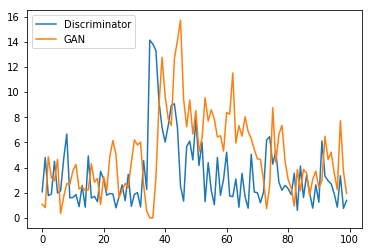

An Example from the Training Set: 


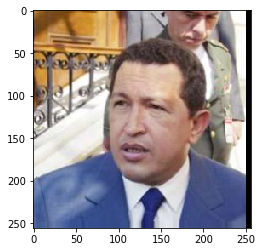

An Example from the Generator: 


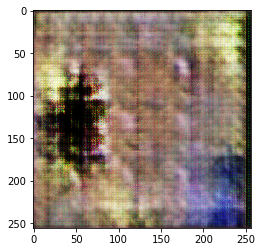

Prediction: [2.6041604e-17]


--------------- Epoch: 52 ---------------
Discriminator loss: 1.9971888, GAN loss: 4.219195

Discriminator loss: 3.5924134, GAN loss: 4.939224

Discriminator loss: 9.784853, GAN loss: 14.81584

Discriminator loss: 4.9734583, GAN loss: 10.4085865

Discriminator loss: 6.4876604, GAN loss: 4.1345577

Discriminator loss: 2.228902, GAN loss: 4.592441

Discriminator loss: 1.935024, GAN loss: 3.1788504

Discriminator loss: 2.91537, GAN loss: 2.7580068

Discriminator loss: 2.4724422, GAN loss: 4.4647894

Loss History:


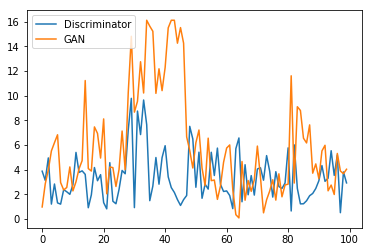

An Example from the Training Set: 


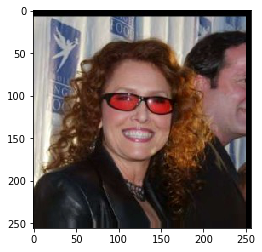

An Example from the Generator: 


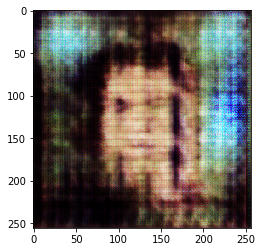

Prediction: [6.41681e-15]


--------------- Epoch: 53 ---------------
Discriminator loss: 3.800342, GAN loss: 3.5956376

Discriminator loss: 1.1463397, GAN loss: 4.108754

Discriminator loss: 3.6593506, GAN loss: 4.3556046

Discriminator loss: 0.6401116, GAN loss: 3.065564

Discriminator loss: 3.5624104, GAN loss: 2.4149966

Discriminator loss: 2.055251, GAN loss: 5.0995193

Discriminator loss: 0.60891724, GAN loss: 1.6384016

Discriminator loss: 1.2820171, GAN loss: 2.298989

Discriminator loss: 2.2908356, GAN loss: 2.2006109

Loss History:


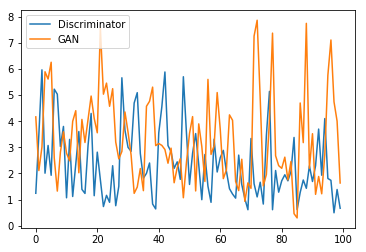

An Example from the Training Set: 


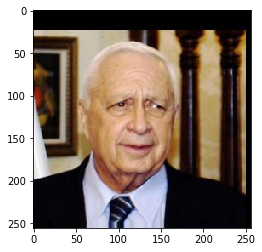

An Example from the Generator: 


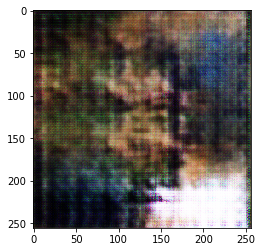

Prediction: [5.721438e-16]


--------------- Epoch: 54 ---------------
Discriminator loss: 2.079906, GAN loss: 6.531629

Discriminator loss: 0.9899098, GAN loss: 5.9917774

Discriminator loss: 1.3081675, GAN loss: 3.9907556

Discriminator loss: 2.2539856, GAN loss: 3.2055373

Discriminator loss: 2.033227, GAN loss: 1.9460325

Discriminator loss: 0.6708249, GAN loss: 2.7900941

Discriminator loss: 2.8217402, GAN loss: 11.465525

Discriminator loss: 1.3690687, GAN loss: 6.2126765

Discriminator loss: 2.9168677, GAN loss: 3.2524009

Loss History:


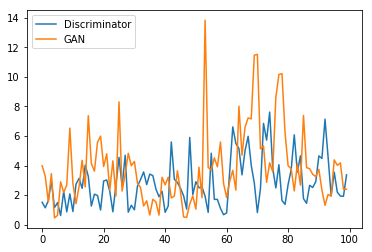

An Example from the Training Set: 


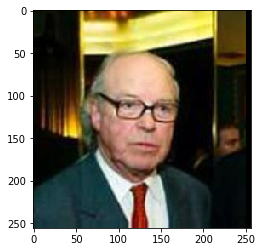

An Example from the Generator: 


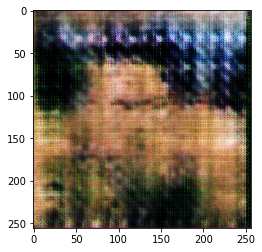

Prediction: [1.7555378e-10]


--------------- Epoch: 55 ---------------
Discriminator loss: 3.7845864, GAN loss: 3.938565

Discriminator loss: 0.58126277, GAN loss: 2.082093

Discriminator loss: 1.1188408, GAN loss: 4.764337

Discriminator loss: 0.9901832, GAN loss: 0.6991603

Discriminator loss: 2.7879505, GAN loss: 4.8509254

Discriminator loss: 2.4058402, GAN loss: 6.100033

Discriminator loss: 2.3813539, GAN loss: 1.7704897

Discriminator loss: 0.9658697, GAN loss: 4.276162

Discriminator loss: 2.2986033, GAN loss: 3.2550874

Loss History:


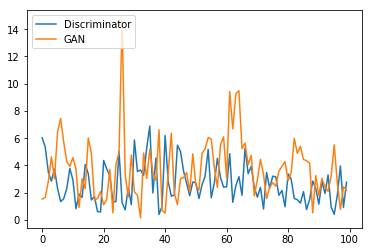

An Example from the Training Set: 


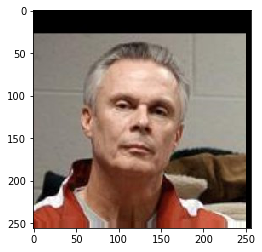

An Example from the Generator: 


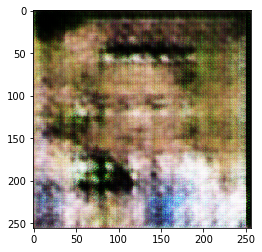

Prediction: [1.2344892e-11]


--------------- Epoch: 56 ---------------
Discriminator loss: 2.9224563, GAN loss: 2.135284

Discriminator loss: 2.891145, GAN loss: 3.4929657

Discriminator loss: 3.2634358, GAN loss: 2.51912

Discriminator loss: 2.5846984, GAN loss: 6.762758

Discriminator loss: 1.7706177, GAN loss: 6.5343475

Discriminator loss: 9.812642, GAN loss: 12.157933

Discriminator loss: 2.0325353, GAN loss: 2.1975148

Discriminator loss: 2.8319302, GAN loss: 4.6809006

Discriminator loss: 2.5972722, GAN loss: 2.9188426

Loss History:


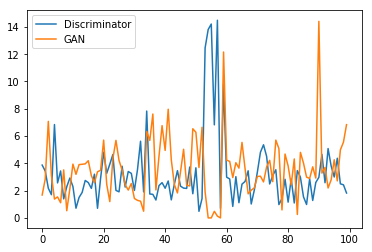

An Example from the Training Set: 


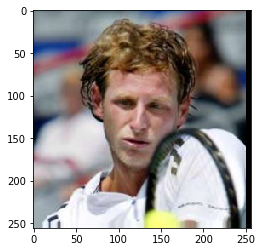

An Example from the Generator: 


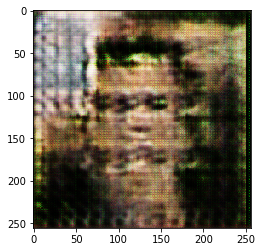

Prediction: [6.398649e-11]


--------------- Epoch: 57 ---------------
Discriminator loss: 4.8931856, GAN loss: 0.36993042

Discriminator loss: 5.362667, GAN loss: 2.1185849

Discriminator loss: 0.4940228, GAN loss: 1.9720516

Discriminator loss: 2.321111, GAN loss: 4.68202

Discriminator loss: 3.6970763, GAN loss: 6.517953

Discriminator loss: 1.0052037, GAN loss: 2.1896205

Discriminator loss: 0.95071256, GAN loss: 4.8068953

Discriminator loss: 2.2524707, GAN loss: 2.2814023

Discriminator loss: 2.341167, GAN loss: 1.2094233

Loss History:


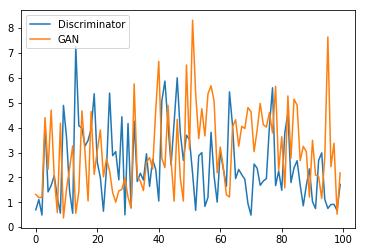

An Example from the Training Set: 


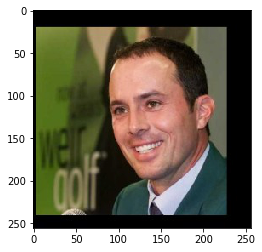

An Example from the Generator: 


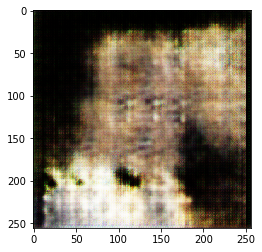

Prediction: [3.3410752e-12]


--------------- Epoch: 58 ---------------
Discriminator loss: 1.8229529, GAN loss: 2.705403

Discriminator loss: 3.0046391, GAN loss: 0.8595837

Discriminator loss: 0.6052496, GAN loss: 2.1010995

Discriminator loss: 2.3823404, GAN loss: 0.13051598

Discriminator loss: 0.55960697, GAN loss: 0.30481514

Discriminator loss: 1.2376426, GAN loss: 0.9204958

Discriminator loss: 1.2888758, GAN loss: 4.417065

Discriminator loss: 2.5571594, GAN loss: 4.551138

Discriminator loss: 4.7524443, GAN loss: 1.0771464

Loss History:


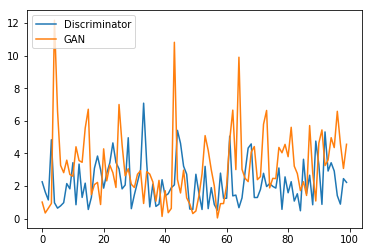

An Example from the Training Set: 


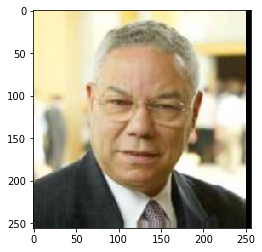

An Example from the Generator: 


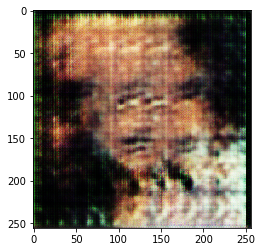

Prediction: [1.1251106e-12]


--------------- Epoch: 59 ---------------
Discriminator loss: 1.4423002, GAN loss: 4.771791

Discriminator loss: 1.6331499, GAN loss: 1.1086547

Discriminator loss: 1.4559287, GAN loss: 0.061032884

Discriminator loss: 0.85524195, GAN loss: 4.217717

Discriminator loss: 3.6047692, GAN loss: 9.797563

Discriminator loss: 3.3629081, GAN loss: 3.2998233

Discriminator loss: 0.65895665, GAN loss: 2.3133655

Discriminator loss: 0.5831733, GAN loss: 1.9841583

Discriminator loss: 0.43412384, GAN loss: 2.7316864

Loss History:


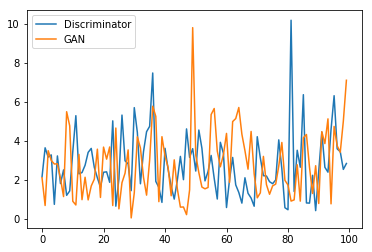

An Example from the Training Set: 


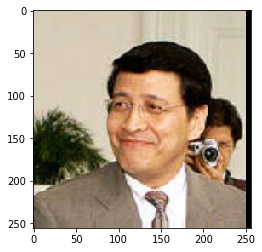

An Example from the Generator: 


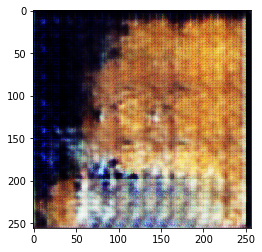

Prediction: [2.1500152e-10]


--------------- Epoch: 60 ---------------
Discriminator loss: 2.2264366, GAN loss: 6.281875

Discriminator loss: 4.929118, GAN loss: 1.1002594

Discriminator loss: 3.41078, GAN loss: 3.3478637

Discriminator loss: 2.52632, GAN loss: 1.6584883

Discriminator loss: 5.5547915, GAN loss: 4.1313553

Discriminator loss: 2.6819515, GAN loss: 4.919411

Discriminator loss: 0.9848817, GAN loss: 2.1883116

Discriminator loss: 3.6427665, GAN loss: 1.2923392

Discriminator loss: 2.7549458, GAN loss: 2.587242

Loss History:


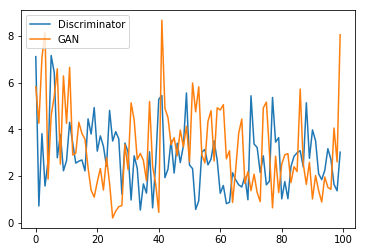

An Example from the Training Set: 


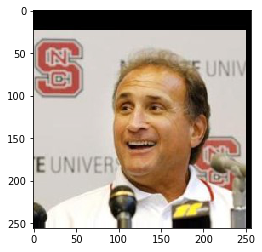

An Example from the Generator: 


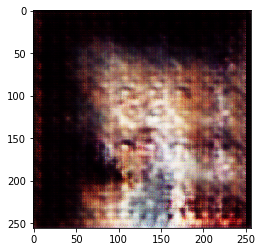

Prediction: [2.8818603e-10]


--------------- Epoch: 61 ---------------
Discriminator loss: 1.8782934, GAN loss: 5.0732336

Discriminator loss: 3.7908783, GAN loss: 0.69000447

Discriminator loss: 2.390265, GAN loss: 1.3355646

Discriminator loss: 1.7920507, GAN loss: 3.9662833

Discriminator loss: 3.11973, GAN loss: 6.7709455

Discriminator loss: 1.689913, GAN loss: 4.0342956

Discriminator loss: 1.7558146, GAN loss: 2.3017993

Discriminator loss: 6.8561034, GAN loss: 0.74856687

Discriminator loss: 8.198141, GAN loss: 4.385923

Loss History:


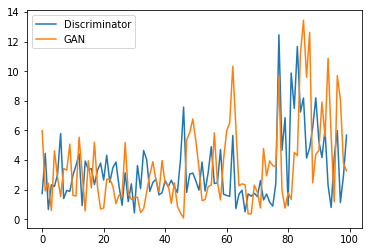

An Example from the Training Set: 


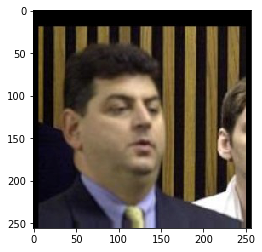

An Example from the Generator: 


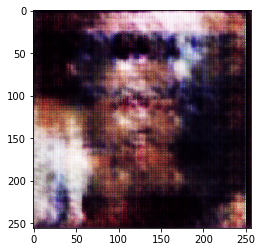

Prediction: [5.822428e-10]


--------------- Epoch: 62 ---------------
Discriminator loss: 0.5283375, GAN loss: 4.7840443

Discriminator loss: 8.5552435, GAN loss: 0.0030960585

Discriminator loss: 5.2932987, GAN loss: 2.313766

Discriminator loss: 2.4220414, GAN loss: 3.289658

Discriminator loss: 2.2424357, GAN loss: 3.9877026

Discriminator loss: 1.3927863, GAN loss: 4.0148

Discriminator loss: 1.12921, GAN loss: 1.1180302

Discriminator loss: 0.8597003, GAN loss: 6.2238836

Discriminator loss: 1.2492342, GAN loss: 1.9139417

Loss History:


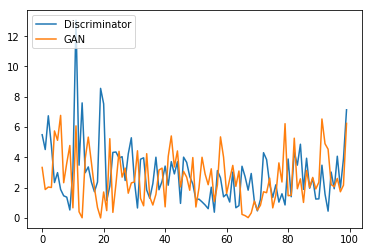

An Example from the Training Set: 


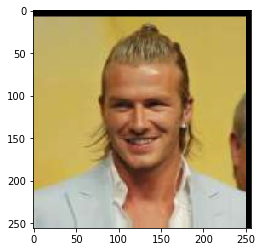

An Example from the Generator: 


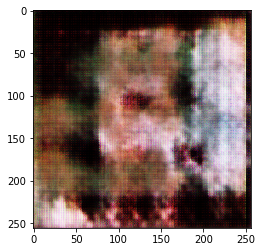

Prediction: [2.2264215e-12]


--------------- Epoch: 63 ---------------
Discriminator loss: 6.6635294, GAN loss: 3.1120846

Discriminator loss: 8.090895, GAN loss: 3.19068

Discriminator loss: 4.6781816, GAN loss: 1.5426261

Discriminator loss: 1.068949, GAN loss: 3.4081903

Discriminator loss: 1.0615928, GAN loss: 2.1044488

Discriminator loss: 3.389339, GAN loss: 1.1104707

Discriminator loss: 2.8045008, GAN loss: 1.28144

Discriminator loss: 4.3524237, GAN loss: 3.6794076

Discriminator loss: 1.3111231, GAN loss: 2.017243

Loss History:


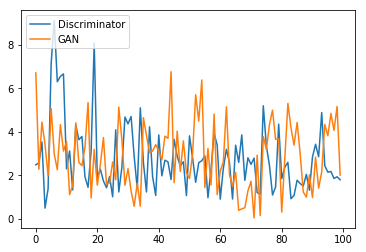

An Example from the Training Set: 


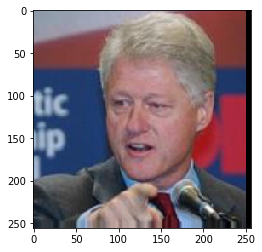

An Example from the Generator: 


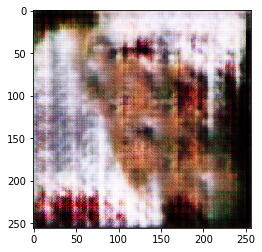

Prediction: [4.729348e-11]


--------------- Epoch: 64 ---------------
Discriminator loss: 2.6135545, GAN loss: 0.65964186

Discriminator loss: 2.5693467, GAN loss: 2.4429102

Discriminator loss: 3.0339198, GAN loss: 3.9274056

Discriminator loss: 2.492675, GAN loss: 1.2164932

Discriminator loss: 4.3577337, GAN loss: 1.6716397

Discriminator loss: 2.1097312, GAN loss: 8.841028

Discriminator loss: 2.4943194, GAN loss: 4.803336

Discriminator loss: 2.7396715, GAN loss: 5.1040435

Discriminator loss: 0.46133384, GAN loss: 2.404256

Loss History:


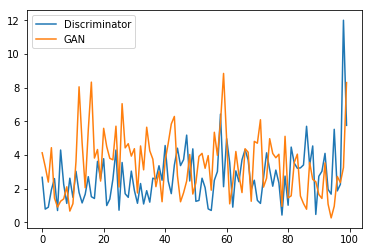

An Example from the Training Set: 


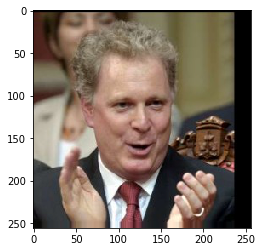

An Example from the Generator: 


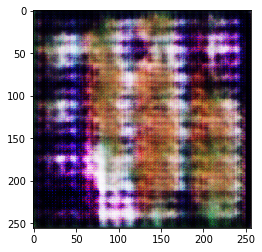

Prediction: [9.245868e-07]


--------------- Epoch: 65 ---------------
Discriminator loss: 0.9009706, GAN loss: 1.2460977

Discriminator loss: 1.8593775, GAN loss: 1.9796795

Discriminator loss: 2.207521, GAN loss: 5.461955

Discriminator loss: 1.7929224, GAN loss: 3.4531624

Discriminator loss: 2.5075843, GAN loss: 4.418284

Discriminator loss: 4.139016, GAN loss: 2.335582

Discriminator loss: 5.9080124, GAN loss: 4.9934025

Discriminator loss: 0.6947524, GAN loss: 8.810556

Discriminator loss: 4.1747026, GAN loss: 2.9177296

Loss History:


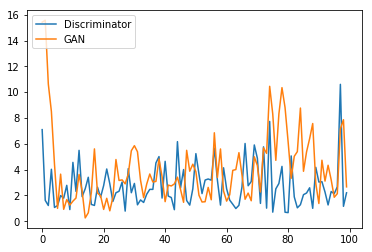

An Example from the Training Set: 


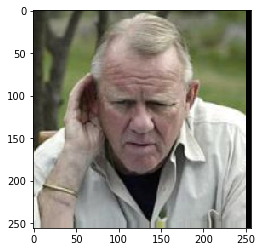

An Example from the Generator: 


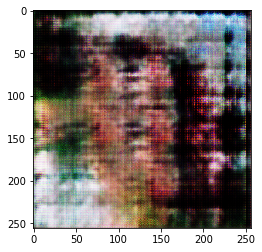

Prediction: [5.595911e-08]


--------------- Epoch: 66 ---------------
Discriminator loss: 6.304782, GAN loss: 1.4216361

Discriminator loss: 3.2157989, GAN loss: 2.4789681

Discriminator loss: 1.4460243, GAN loss: 2.5748737

Discriminator loss: 2.5476665, GAN loss: 4.275817

Discriminator loss: 2.0916724, GAN loss: 8.963583

Discriminator loss: 2.534542, GAN loss: 2.0515628

Discriminator loss: 2.0647361, GAN loss: 1.8782825

Discriminator loss: 2.31763, GAN loss: 7.9041114

Discriminator loss: 2.8777275, GAN loss: 3.1329286

Loss History:


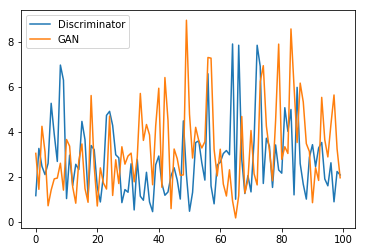

An Example from the Training Set: 


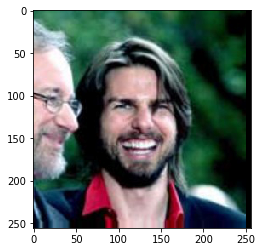

An Example from the Generator: 


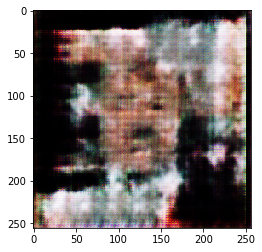

Prediction: [0.00037641]


--------------- Epoch: 67 ---------------
Discriminator loss: 1.4409096, GAN loss: 3.097414

Discriminator loss: 3.0110233, GAN loss: 2.1912472

Discriminator loss: 1.1922206, GAN loss: 6.3066926

Discriminator loss: 1.3308986, GAN loss: 3.7462018

Discriminator loss: 1.6493034, GAN loss: 3.8075588

Discriminator loss: 1.8371979, GAN loss: 5.1175346

Discriminator loss: 1.3649883, GAN loss: 4.5029607

Discriminator loss: 14.05838, GAN loss: 1.1920933e-07

Discriminator loss: 14.280312, GAN loss: 1.549721e-07

Loss History:


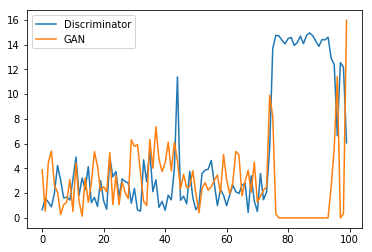

An Example from the Training Set: 


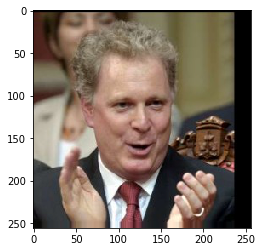

An Example from the Generator: 


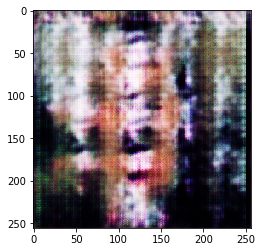

Prediction: [9.596271e-09]


--------------- Epoch: 68 ---------------
Discriminator loss: 5.2747407, GAN loss: 9.496948

Discriminator loss: 5.711481, GAN loss: 5.134916

Discriminator loss: 2.0786495, GAN loss: 5.102187

Discriminator loss: 2.383715, GAN loss: 12.785155

Discriminator loss: 0.94609135, GAN loss: 5.0678797

Discriminator loss: 5.2035203, GAN loss: 5.685684

Discriminator loss: 4.8486586, GAN loss: 4.5481567

Discriminator loss: 1.9976227, GAN loss: 5.105632

Discriminator loss: 0.73458403, GAN loss: 2.9388576

Loss History:


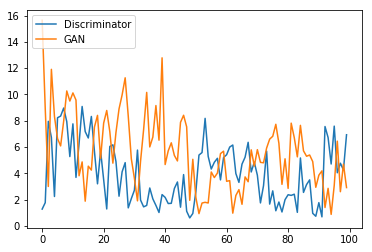

An Example from the Training Set: 


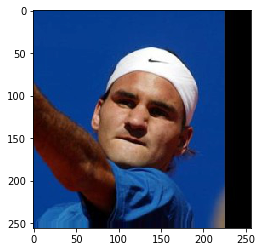

An Example from the Generator: 


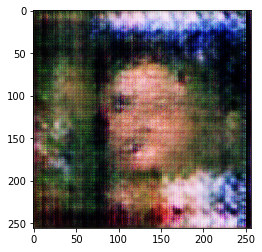

Prediction: [0.01139652]


--------------- Epoch: 69 ---------------
Discriminator loss: 6.39869, GAN loss: 0.61395776

Discriminator loss: 4.913138, GAN loss: 2.4626918

Discriminator loss: 3.5222073, GAN loss: 2.7688973

Discriminator loss: 2.6093552, GAN loss: 5.16331

Discriminator loss: 1.6250874, GAN loss: 7.8879533

Discriminator loss: 0.910651, GAN loss: 5.413727

Discriminator loss: 4.26562, GAN loss: 2.6910496

Discriminator loss: 2.31998, GAN loss: 2.0925133

Discriminator loss: 6.2316694, GAN loss: 6.2183075

Loss History:


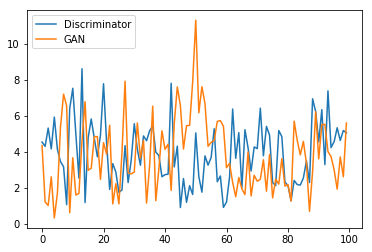

An Example from the Training Set: 


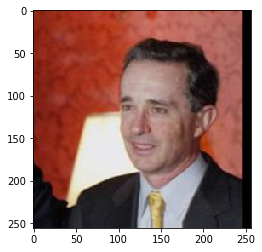

An Example from the Generator: 


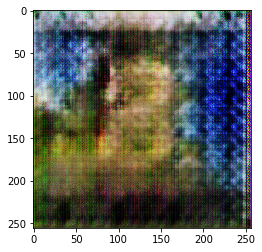

Prediction: [0.9999167]


--------------- Epoch: 70 ---------------
Discriminator loss: 6.7222414, GAN loss: 7.3200393

Discriminator loss: 3.3528843, GAN loss: 5.0958066

Discriminator loss: 5.4093447, GAN loss: 3.2022014

Discriminator loss: 1.1144733, GAN loss: 5.3173633

Discriminator loss: 3.6584077, GAN loss: 3.381187

Discriminator loss: 1.4047965, GAN loss: 6.030665

Discriminator loss: 4.9977045, GAN loss: 3.270452

Discriminator loss: 2.4253657, GAN loss: 5.5386963

Discriminator loss: 2.1390905, GAN loss: 2.8193016

Loss History:


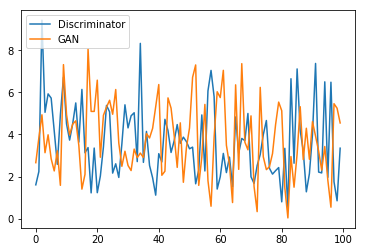

An Example from the Training Set: 


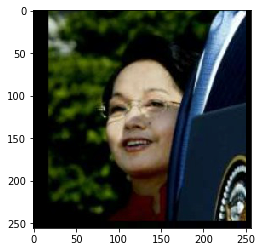

An Example from the Generator: 


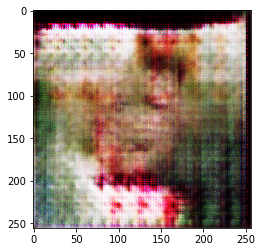

Prediction: [0.697914]


--------------- Epoch: 71 ---------------
Discriminator loss: 3.8458648, GAN loss: 1.776144

Discriminator loss: 2.6422772, GAN loss: 3.0590622

Discriminator loss: 4.4045033, GAN loss: 2.8817852

Discriminator loss: 2.4173522, GAN loss: 2.577533

Discriminator loss: 3.667457, GAN loss: 5.0953383

Discriminator loss: 1.3473287, GAN loss: 5.0067534

Discriminator loss: 4.4084506, GAN loss: 2.336423

Discriminator loss: 2.6619365, GAN loss: 4.293971

Discriminator loss: 1.902811, GAN loss: 3.2260156

Loss History:


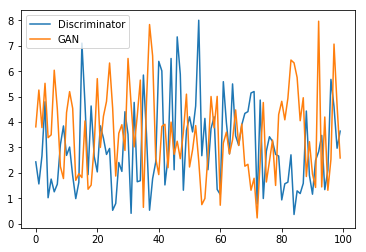

An Example from the Training Set: 


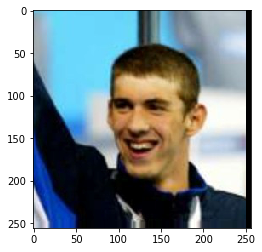

An Example from the Generator: 


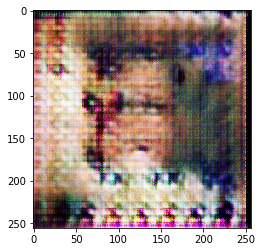

Prediction: [0.70986784]


--------------- Epoch: 72 ---------------
Discriminator loss: 5.4040174, GAN loss: 2.4593604

Discriminator loss: 4.518607, GAN loss: 2.4921794

Discriminator loss: 4.1373005, GAN loss: 10.1634035

Discriminator loss: 8.651484, GAN loss: 8.581447

Discriminator loss: 6.1990438, GAN loss: 3.4673324

Discriminator loss: 2.1003385, GAN loss: 7.846283

Discriminator loss: 1.7587572, GAN loss: 3.4349694

Discriminator loss: 6.075568, GAN loss: 3.1826892

Discriminator loss: 4.3940797, GAN loss: 3.9003766

Loss History:


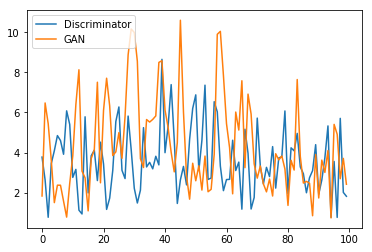

An Example from the Training Set: 


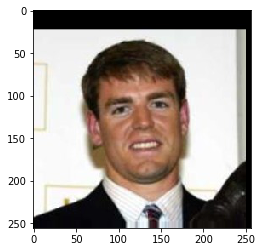

An Example from the Generator: 


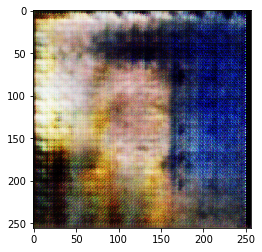

Prediction: [0.0122933]


--------------- Epoch: 73 ---------------
Discriminator loss: 3.1032693, GAN loss: 0.27112973

Discriminator loss: 3.574208, GAN loss: 3.496573

Discriminator loss: 1.2274212, GAN loss: 3.3638866

Discriminator loss: 2.839562, GAN loss: 1.6642244

Discriminator loss: 5.180938, GAN loss: 4.386773

Discriminator loss: 2.3146152, GAN loss: 4.8340273

Discriminator loss: 4.148864, GAN loss: 2.3275824

Discriminator loss: 5.3495727, GAN loss: 1.2313238

Discriminator loss: 1.3059647, GAN loss: 3.2808335

Loss History:


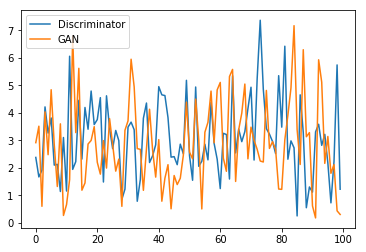

An Example from the Training Set: 


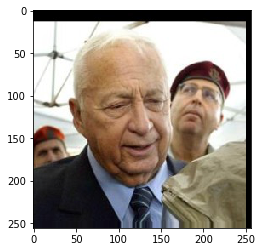

An Example from the Generator: 


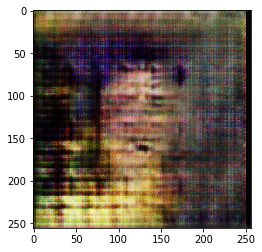

Prediction: [2.852442e-08]


--------------- Epoch: 74 ---------------
Discriminator loss: 1.9176033, GAN loss: 1.4681424

Discriminator loss: 3.6198502, GAN loss: 2.9321215

Discriminator loss: 2.1155665, GAN loss: 5.397324

Discriminator loss: 3.5250466, GAN loss: 1.7357445

Discriminator loss: 9.411733, GAN loss: 1.4135958

Discriminator loss: 4.688651, GAN loss: 1.0414011

Discriminator loss: 2.8697827, GAN loss: 1.9374908

Discriminator loss: 1.2492956, GAN loss: 5.1753116

Discriminator loss: 11.099115, GAN loss: 2.2514012

Loss History:


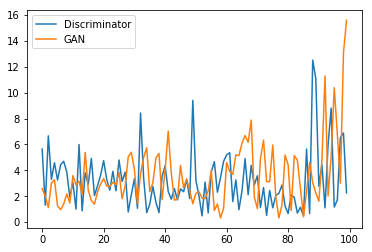

An Example from the Training Set: 


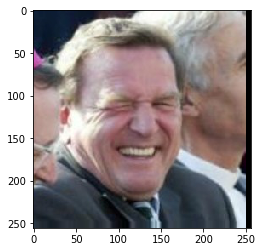

An Example from the Generator: 


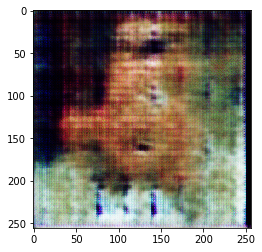

Prediction: [0.00049771]


--------------- Epoch: 75 ---------------
Discriminator loss: 3.5522988, GAN loss: 4.127025

Discriminator loss: 2.7392983, GAN loss: 1.1570677

Discriminator loss: 3.1348042, GAN loss: 2.3272552

Discriminator loss: 3.6612687, GAN loss: 2.6213698

Discriminator loss: 1.792881, GAN loss: 2.322375

Discriminator loss: 11.084862, GAN loss: 0.38980603

Discriminator loss: 3.3266053, GAN loss: 2.5767453

Discriminator loss: 1.1831957, GAN loss: 3.632871

Discriminator loss: 3.115557, GAN loss: 6.616675

Loss History:


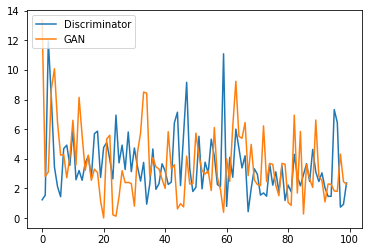

An Example from the Training Set: 


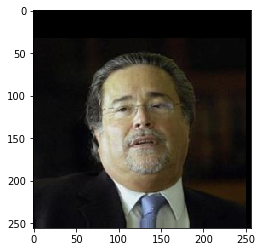

An Example from the Generator: 


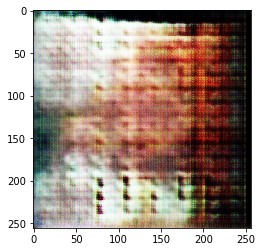

Prediction: [1.4323571e-08]


--------------- Epoch: 76 ---------------
Discriminator loss: 3.4285245, GAN loss: 1.8264061

Discriminator loss: 0.88441485, GAN loss: 1.5704932

Discriminator loss: 3.565186, GAN loss: 2.6696231

Discriminator loss: 3.013648, GAN loss: 4.7749496

Discriminator loss: 2.848686, GAN loss: 5.0137496

Discriminator loss: 3.538854, GAN loss: 6.185668

Discriminator loss: 1.8114846, GAN loss: 1.2700434

Discriminator loss: 1.8371655, GAN loss: 5.19709

Discriminator loss: 1.3036188, GAN loss: 3.211097

Loss History:


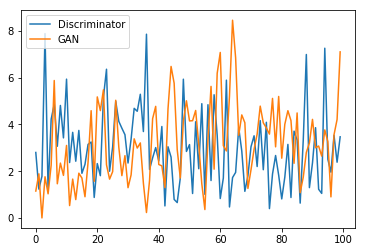

An Example from the Training Set: 


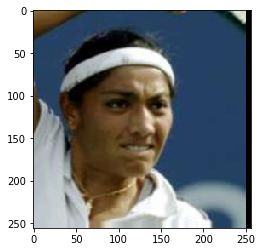

An Example from the Generator: 


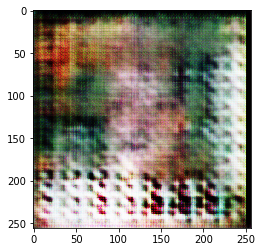

Prediction: [0.01257986]


--------------- Epoch: 77 ---------------
Discriminator loss: 2.3639636, GAN loss: 3.9914136

Discriminator loss: 4.279486, GAN loss: 2.6684048

Discriminator loss: 2.2612026, GAN loss: 1.9921967

Discriminator loss: 3.5965703, GAN loss: 0.5515746

Discriminator loss: 2.8934765, GAN loss: 5.9799004

Discriminator loss: 6.399876, GAN loss: 1.2556261

Discriminator loss: 0.4576828, GAN loss: 4.8570848

Discriminator loss: 5.2740507, GAN loss: 4.9310865

Discriminator loss: 4.2410135, GAN loss: 0.889918

Loss History:


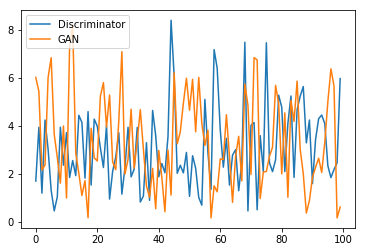

An Example from the Training Set: 


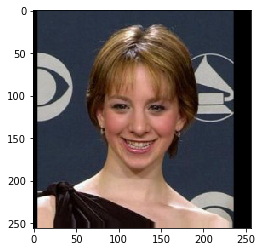

An Example from the Generator: 


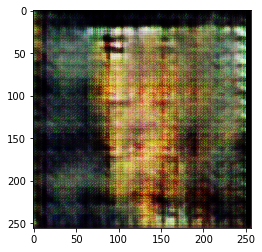

Prediction: [0.06121888]


--------------- Epoch: 78 ---------------
Discriminator loss: 2.025837, GAN loss: 0.87617415

Discriminator loss: 2.5171416, GAN loss: 2.1396422

Discriminator loss: 2.8592587, GAN loss: 2.259002

Discriminator loss: 1.1473722, GAN loss: 2.9463067

Discriminator loss: 3.1638858, GAN loss: 4.00558

Discriminator loss: 1.9160287, GAN loss: 0.64981526

Discriminator loss: 7.6200995, GAN loss: 1.1189948

Discriminator loss: 5.905038, GAN loss: 2.53271

Discriminator loss: 1.193133, GAN loss: 5.1036434

Loss History:


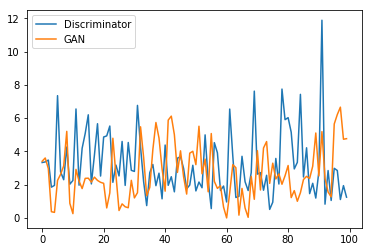

An Example from the Training Set: 


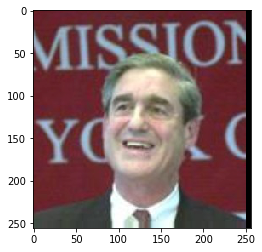

An Example from the Generator: 


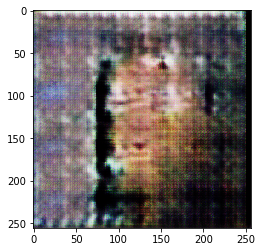

Prediction: [0.9993193]


--------------- Epoch: 79 ---------------
Discriminator loss: 1.108317, GAN loss: 0.21561113

Discriminator loss: 2.0314398, GAN loss: 4.1754937

Discriminator loss: 6.6155486, GAN loss: 4.002809

Discriminator loss: 4.6254563, GAN loss: 1.8860935

Discriminator loss: 0.76283693, GAN loss: 1.7647988

Discriminator loss: 1.9467436, GAN loss: 5.8925786

Discriminator loss: 1.3442852, GAN loss: 4.797136

Discriminator loss: 3.1034443, GAN loss: 3.9898334

Discriminator loss: 0.4630688, GAN loss: 4.2161255

Loss History:


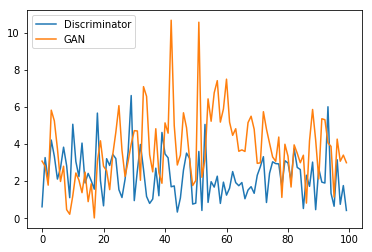

An Example from the Training Set: 


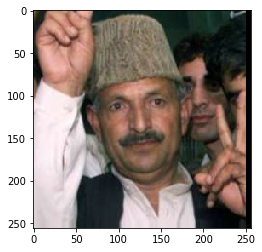

An Example from the Generator: 


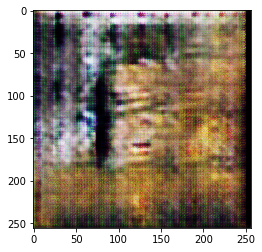

Prediction: [0.06055195]


--------------- Epoch: 80 ---------------
Discriminator loss: 2.4134552, GAN loss: 3.4402823

Discriminator loss: 4.2244663, GAN loss: 3.9656608

Discriminator loss: 3.3063617, GAN loss: 3.6854286

Discriminator loss: 1.7685087, GAN loss: 2.698955

Discriminator loss: 1.8719711, GAN loss: 5.917156

Discriminator loss: 1.6598438, GAN loss: 5.0173135

Discriminator loss: 1.910569, GAN loss: 5.092484

Discriminator loss: 4.213638, GAN loss: 3.9741225

Discriminator loss: 5.191181, GAN loss: 6.3876524

Loss History:


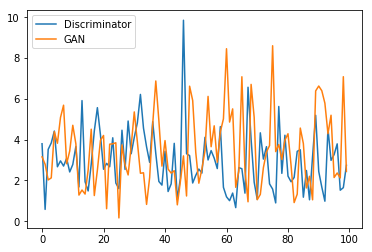

An Example from the Training Set: 


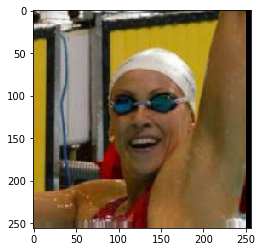

An Example from the Generator: 


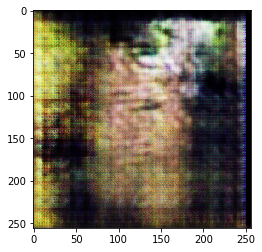

Prediction: [1.3837029e-05]


--------------- Epoch: 81 ---------------
Discriminator loss: 0.48610726, GAN loss: 2.3082538

Discriminator loss: 6.680673, GAN loss: 4.871852

Discriminator loss: 2.1142704, GAN loss: 4.4651136

Discriminator loss: 4.975754, GAN loss: 1.9436249

Discriminator loss: 3.0882359, GAN loss: 3.660952

Discriminator loss: 1.9603758, GAN loss: 1.5370657

Discriminator loss: 2.3718505, GAN loss: 3.0907571

Discriminator loss: 0.72943944, GAN loss: 3.889893

Discriminator loss: 4.7766685, GAN loss: 0.85046464

Loss History:


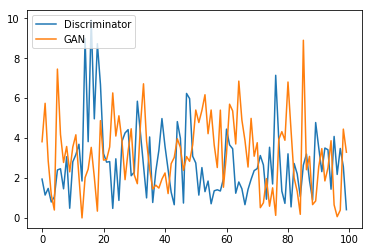

An Example from the Training Set: 


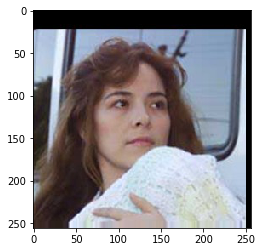

An Example from the Generator: 


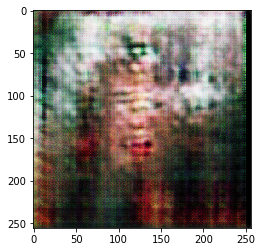

Prediction: [0.00197479]


--------------- Epoch: 82 ---------------
Discriminator loss: 2.524237, GAN loss: 4.181851

Discriminator loss: 2.683537, GAN loss: 0.0077322805

Discriminator loss: 8.622894, GAN loss: 0.44504547

Discriminator loss: 3.306251, GAN loss: 0.18000822

Discriminator loss: 1.0180242, GAN loss: 3.1318262

Discriminator loss: 1.769187, GAN loss: 2.4600635

Discriminator loss: 3.7122605, GAN loss: 0.6987807

Discriminator loss: 3.4339767, GAN loss: 2.9067953

Discriminator loss: 1.6675158, GAN loss: 7.974988

Loss History:


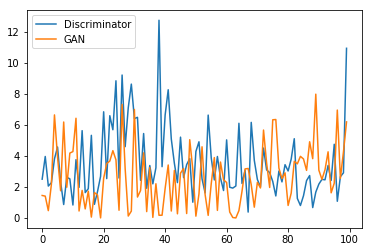

An Example from the Training Set: 


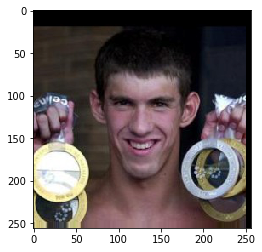

An Example from the Generator: 


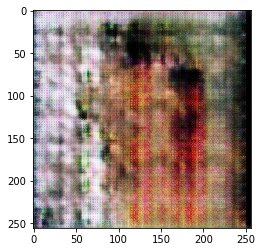

Prediction: [0.00421256]


--------------- Epoch: 83 ---------------
Discriminator loss: 1.946381, GAN loss: 3.7002327

Discriminator loss: 8.544823, GAN loss: 0.70149845

Discriminator loss: 8.68907, GAN loss: 7.248011

Discriminator loss: 5.5472875, GAN loss: 9.134938

Discriminator loss: 8.998827, GAN loss: 4.9383073

Discriminator loss: 5.403447, GAN loss: 9.030202

Discriminator loss: 5.4950504, GAN loss: 3.9627967

Discriminator loss: 4.816411, GAN loss: 1.9620641

Discriminator loss: 6.137743, GAN loss: 3.6432843

Loss History:


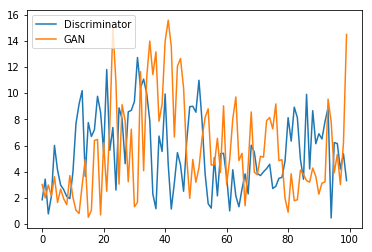

An Example from the Training Set: 


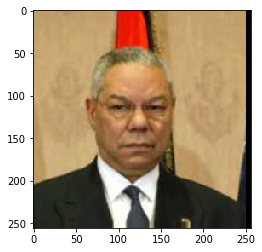

An Example from the Generator: 


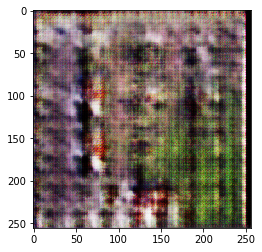

Prediction: [6.4232603e-07]


--------------- Epoch: 84 ---------------
Discriminator loss: 4.4383426, GAN loss: 2.7473917

Discriminator loss: 4.4960647, GAN loss: 3.0941746

Discriminator loss: 3.8792515, GAN loss: 0.9236471

Discriminator loss: 4.0879116, GAN loss: 5.8150024

Discriminator loss: 4.795849, GAN loss: 2.7546546

Discriminator loss: 7.26174, GAN loss: 12.975683

Discriminator loss: 6.8962793, GAN loss: 6.995014

Discriminator loss: 7.0539336, GAN loss: 2.0028503

Discriminator loss: 4.0617223, GAN loss: 2.137439

Loss History:


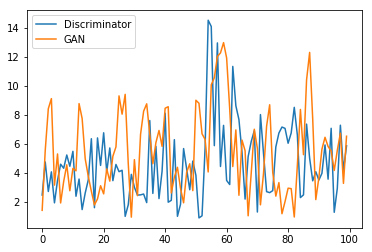

An Example from the Training Set: 


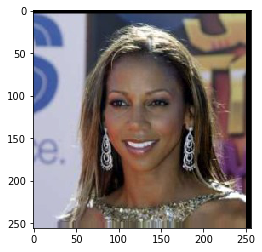

An Example from the Generator: 


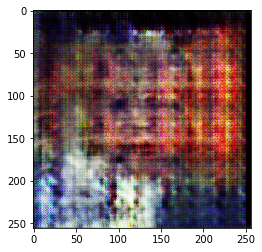

Prediction: [4.213386e-07]


--------------- Epoch: 85 ---------------
Discriminator loss: 2.0680425, GAN loss: 5.18801

Discriminator loss: 2.5684338, GAN loss: 8.094854

Discriminator loss: 5.674058, GAN loss: 2.6765678

Discriminator loss: 4.6436515, GAN loss: 3.415012

Discriminator loss: 3.1677823, GAN loss: 8.278288

Discriminator loss: 3.1162732, GAN loss: 3.7503593

Discriminator loss: 3.3256729, GAN loss: 3.358422

Discriminator loss: 3.4976134, GAN loss: 9.2492075

Discriminator loss: 2.8949895, GAN loss: 4.3890953

Loss History:


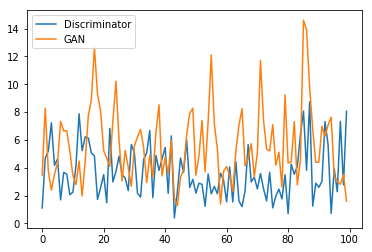

An Example from the Training Set: 


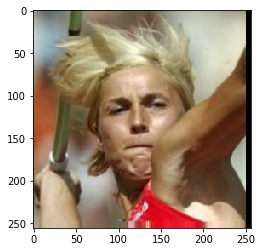

An Example from the Generator: 


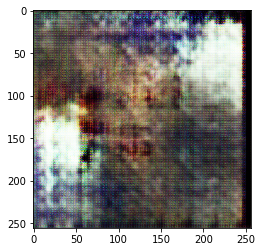

Prediction: [6.478677e-05]


--------------- Epoch: 86 ---------------
Discriminator loss: 3.7203612, GAN loss: 5.4807973

Discriminator loss: 4.027522, GAN loss: 7.841647

Discriminator loss: 2.4452803, GAN loss: 2.298471

Discriminator loss: 1.3706348, GAN loss: 0.19250688

Discriminator loss: 4.929268, GAN loss: 8.444004

Discriminator loss: 3.3642936, GAN loss: 5.1161127

Discriminator loss: 4.473337, GAN loss: 2.0476635

Discriminator loss: 1.9980093, GAN loss: 2.6177444

Discriminator loss: 3.2572014, GAN loss: 3.568233

Loss History:


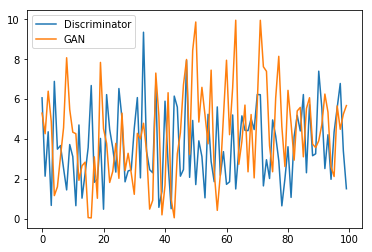

An Example from the Training Set: 


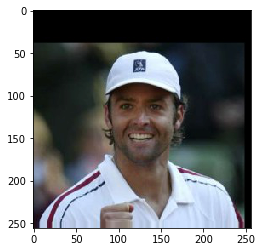

An Example from the Generator: 


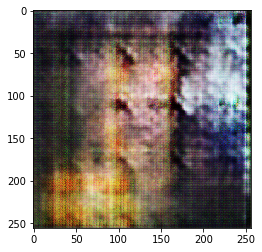

Prediction: [2.5520487e-06]


--------------- Epoch: 87 ---------------
Discriminator loss: 4.842645, GAN loss: 4.521638

Discriminator loss: 4.781967, GAN loss: 4.606622

Discriminator loss: 0.60577667, GAN loss: 1.7091045

Discriminator loss: 3.786131, GAN loss: 2.0539606

Discriminator loss: 4.666642, GAN loss: 2.4914641

Discriminator loss: 3.7082813, GAN loss: 6.849013

Discriminator loss: 3.54451, GAN loss: 8.958745

Discriminator loss: 3.8920894, GAN loss: 6.0391364

Discriminator loss: 1.7525454, GAN loss: 2.580377

Loss History:


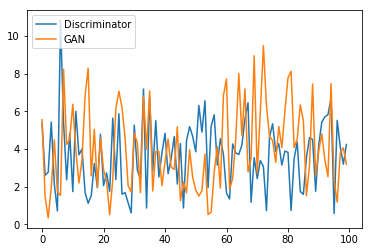

An Example from the Training Set: 


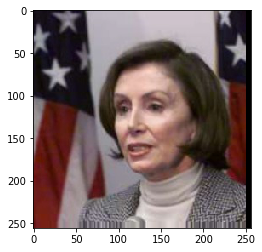

An Example from the Generator: 


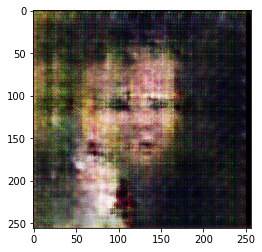

Prediction: [0.02015078]


--------------- Epoch: 88 ---------------
Discriminator loss: 0.6943847, GAN loss: 6.499324

Discriminator loss: 2.8754187, GAN loss: 2.4271739

Discriminator loss: 0.8841361, GAN loss: 5.157146

Discriminator loss: 5.403344, GAN loss: 5.433921

Discriminator loss: 5.1652994, GAN loss: 3.09108

Discriminator loss: 3.7690759, GAN loss: 3.8093178

Discriminator loss: 3.2598414, GAN loss: 1.5826155

Discriminator loss: 2.3302455, GAN loss: 2.7496386

Discriminator loss: 1.9953467, GAN loss: 2.8725064

Loss History:


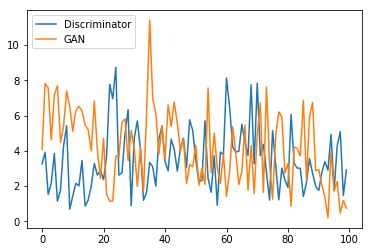

An Example from the Training Set: 


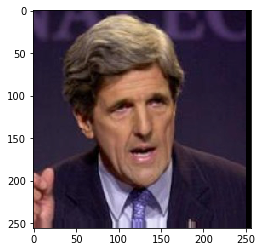

An Example from the Generator: 


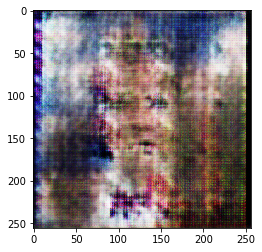

Prediction: [0.01377667]


--------------- Epoch: 89 ---------------
Discriminator loss: 0.6335961, GAN loss: 0.5530369

Discriminator loss: 2.0034473, GAN loss: 0.5403763

Discriminator loss: 4.0123816, GAN loss: 1.2556634

Discriminator loss: 4.9119244, GAN loss: 1.6916567

Discriminator loss: 1.7327249, GAN loss: 3.533835

Discriminator loss: 5.171897, GAN loss: 2.9610016

Discriminator loss: 2.6954863, GAN loss: 2.8845127

Discriminator loss: 4.0868955, GAN loss: 3.8211815

Discriminator loss: 2.7475572, GAN loss: 4.626

Loss History:


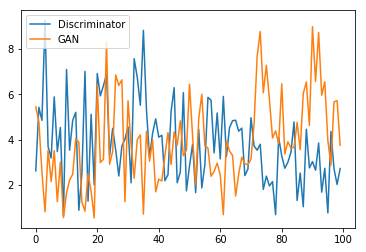

An Example from the Training Set: 


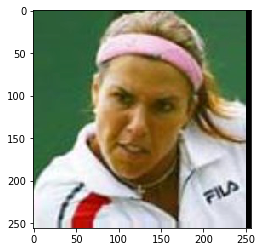

An Example from the Generator: 


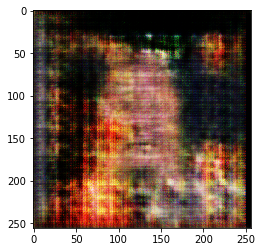

Prediction: [4.6928517e-06]


--------------- Epoch: 90 ---------------
Discriminator loss: 5.6232677, GAN loss: 3.9718013

Discriminator loss: 1.7279537, GAN loss: 1.3730122

Discriminator loss: 2.9403722, GAN loss: 1.584935

Discriminator loss: 2.4742131, GAN loss: 4.4002676

Discriminator loss: 3.4810948, GAN loss: 4.176047

Discriminator loss: 2.3321433, GAN loss: 7.2928686

Discriminator loss: 1.6009617, GAN loss: 4.672511

Discriminator loss: 3.4280357, GAN loss: 6.914636

Discriminator loss: 4.688094, GAN loss: 3.7407165

Loss History:


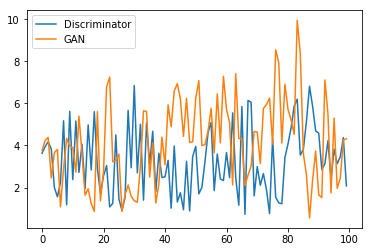

An Example from the Training Set: 


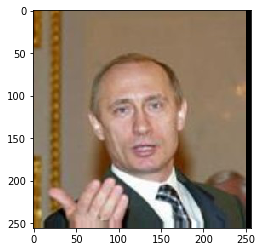

An Example from the Generator: 


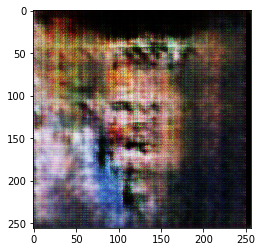

Prediction: [0.00916768]


--------------- Epoch: 91 ---------------
Discriminator loss: 3.7825387, GAN loss: 2.4929318

Discriminator loss: 5.729135, GAN loss: 1.5144799

Discriminator loss: 4.1653466, GAN loss: 2.7268677

Discriminator loss: 3.7002711, GAN loss: 1.73263

Discriminator loss: 3.2919178, GAN loss: 3.7914138

Discriminator loss: 2.1606476, GAN loss: 4.59361

Discriminator loss: 1.7706127, GAN loss: 6.2695017

Discriminator loss: 3.4663632, GAN loss: 2.9142349

Discriminator loss: 2.5550852, GAN loss: 2.6535008

Loss History:


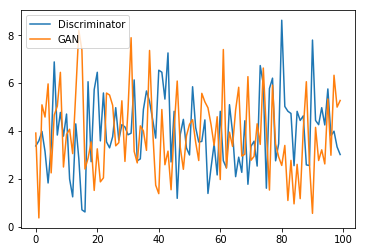

An Example from the Training Set: 


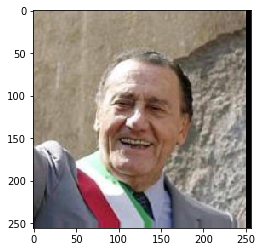

An Example from the Generator: 


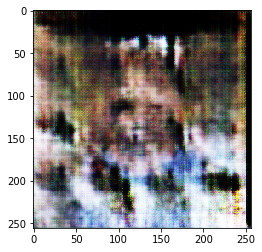

Prediction: [0.03084541]


--------------- Epoch: 92 ---------------
Discriminator loss: 2.2449021, GAN loss: 6.2320933

Discriminator loss: 5.05307, GAN loss: 5.5624485

Discriminator loss: 5.7642245, GAN loss: 5.1928205

Discriminator loss: 3.909204, GAN loss: 4.64814

Discriminator loss: 10.02462, GAN loss: 3.0964844

Discriminator loss: 2.7887452, GAN loss: 7.9798117

Discriminator loss: 2.4522743, GAN loss: 8.9694195

Discriminator loss: 2.346347, GAN loss: 4.1379905

Discriminator loss: 4.5310555, GAN loss: 1.7997757

Loss History:


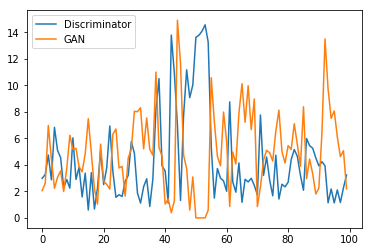

An Example from the Training Set: 


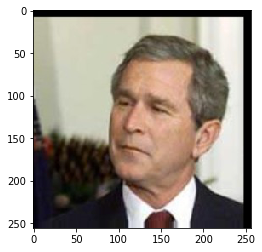

An Example from the Generator: 


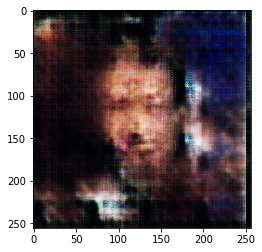

Prediction: [0.03296838]


--------------- Epoch: 93 ---------------
Discriminator loss: 1.9817007, GAN loss: 4.0747347

Discriminator loss: 3.4083118, GAN loss: 3.88973

Discriminator loss: 3.2208176, GAN loss: 4.6947966

Discriminator loss: 4.062543, GAN loss: 3.1630132

Discriminator loss: 1.9306707, GAN loss: 3.1569214

Discriminator loss: 0.3954838, GAN loss: 6.1897655

Discriminator loss: 1.8663906, GAN loss: 5.1669574

Discriminator loss: 3.906192, GAN loss: 3.2178445

Discriminator loss: 5.474785, GAN loss: 3.189002

Loss History:


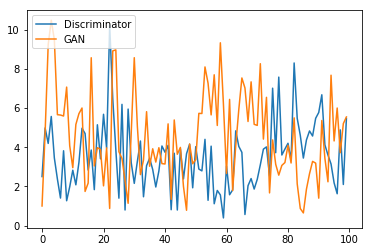

An Example from the Training Set: 


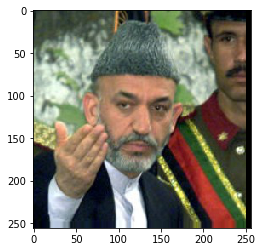

An Example from the Generator: 


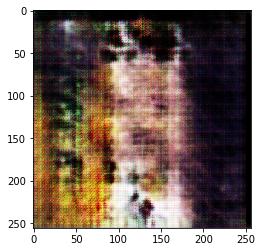

Prediction: [9.933758e-06]


--------------- Epoch: 94 ---------------
Discriminator loss: 2.2636158, GAN loss: 4.4566584

Discriminator loss: 3.3608403, GAN loss: 3.007515

Discriminator loss: 2.2473817, GAN loss: 7.6660523

Discriminator loss: 4.41946, GAN loss: 5.677128

Discriminator loss: 2.9125905, GAN loss: 4.4081335

Discriminator loss: 2.7014866, GAN loss: 4.636979

Discriminator loss: 2.1838517, GAN loss: 1.7549384

Discriminator loss: 1.4436399, GAN loss: 4.347045

Discriminator loss: 6.8415403, GAN loss: 3.882693

Loss History:


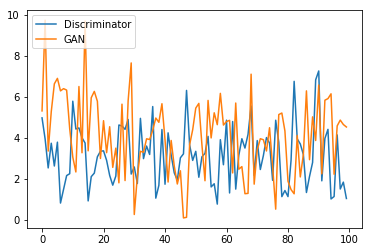

An Example from the Training Set: 


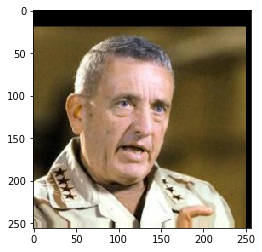

An Example from the Generator: 


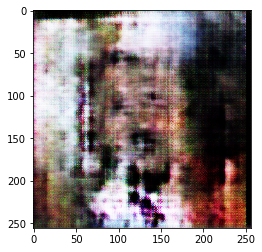

Prediction: [9.341509e-07]


--------------- Epoch: 95 ---------------
Discriminator loss: 7.384487, GAN loss: 2.5188532

Discriminator loss: 6.9068403, GAN loss: 3.128862

Discriminator loss: 0.86800146, GAN loss: 6.174774

Discriminator loss: 2.72176, GAN loss: 9.673302

Discriminator loss: 2.0839777, GAN loss: 2.8582077

Discriminator loss: 2.2755466, GAN loss: 4.977894

Discriminator loss: 1.609956, GAN loss: 5.6281176

Discriminator loss: 2.6601706, GAN loss: 3.8007476

Discriminator loss: 3.21746, GAN loss: 4.4425554

Loss History:


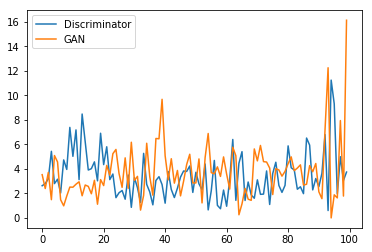

An Example from the Training Set: 


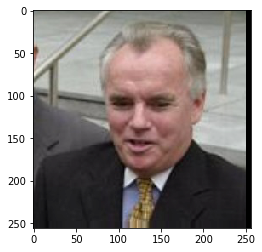

An Example from the Generator: 


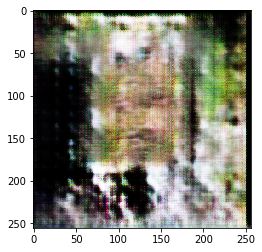

Prediction: [2.3174095e-12]


--------------- Epoch: 96 ---------------
Discriminator loss: 4.520777, GAN loss: 9.918017

Discriminator loss: 4.725812, GAN loss: 0.54569805

Discriminator loss: 0.86152303, GAN loss: 4.4592705

Discriminator loss: 2.1954904, GAN loss: 5.149494

Discriminator loss: 1.4318644, GAN loss: 6.6547456

Discriminator loss: 3.2459984, GAN loss: 4.5278015

Discriminator loss: 4.979337, GAN loss: 1.9124857

Discriminator loss: 3.8015354, GAN loss: 1.6925955

Discriminator loss: 2.75416, GAN loss: 3.9945133

Loss History:


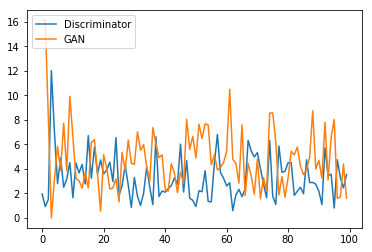

An Example from the Training Set: 


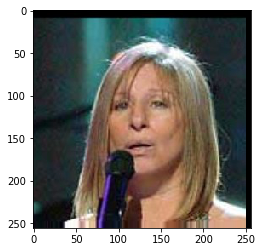

An Example from the Generator: 


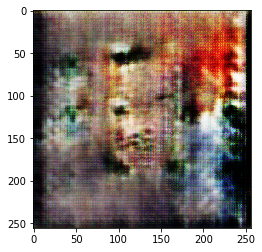

Prediction: [2.2069884e-07]


--------------- Epoch: 97 ---------------
Discriminator loss: 2.5547976, GAN loss: 4.9522815

Discriminator loss: 3.247373, GAN loss: 5.089509

Discriminator loss: 5.0325828, GAN loss: 2.6177888

Discriminator loss: 2.3379905, GAN loss: 3.1201649

Discriminator loss: 4.147112, GAN loss: 8.004488

Discriminator loss: 2.2070215, GAN loss: 2.7932408

Discriminator loss: 4.8990097, GAN loss: 4.474416

Discriminator loss: 2.3562613, GAN loss: 6.1614323

Discriminator loss: 1.2561936, GAN loss: 8.311033

Loss History:


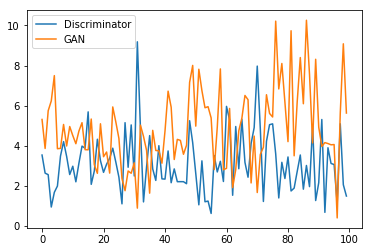

An Example from the Training Set: 


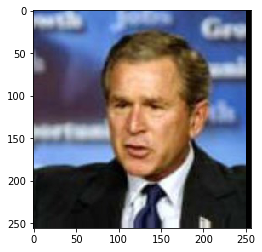

An Example from the Generator: 


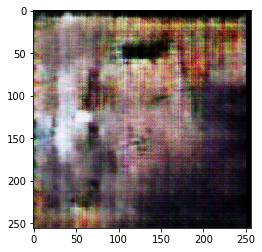

Prediction: [0.00073196]


--------------- Epoch: 98 ---------------
Discriminator loss: 9.747782, GAN loss: 1.1510998

Discriminator loss: 2.3785663, GAN loss: 4.512525

Discriminator loss: 4.5781603, GAN loss: 1.3167641

Discriminator loss: 3.3058681, GAN loss: 4.986684

Discriminator loss: 4.3188357, GAN loss: 4.3418856

Discriminator loss: 0.4139537, GAN loss: 3.6146512

Discriminator loss: 0.4358948, GAN loss: 0.062899955

Discriminator loss: 5.2221856, GAN loss: 2.6697838

Discriminator loss: 2.5096748, GAN loss: 7.0056305

Loss History:


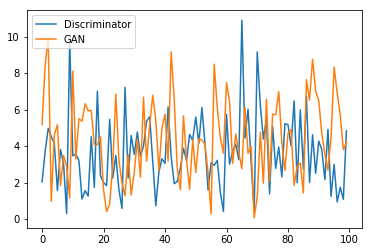

An Example from the Training Set: 


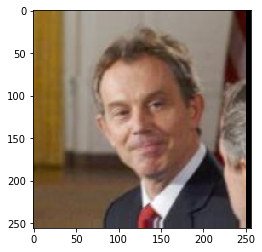

An Example from the Generator: 


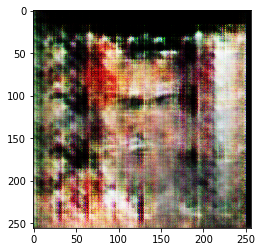

Prediction: [2.0313244e-09]


--------------- Epoch: 99 ---------------
Discriminator loss: 7.4336076, GAN loss: 3.6426766

Discriminator loss: 5.479552, GAN loss: 4.6474385

Discriminator loss: 4.5260344, GAN loss: 2.9885566

Discriminator loss: 2.835446, GAN loss: 3.4501204

Discriminator loss: 3.079249, GAN loss: 8.033125

Discriminator loss: 0.99104357, GAN loss: 3.5538936

Discriminator loss: 3.7882042, GAN loss: 12.461218

Discriminator loss: 2.9375446, GAN loss: 6.867405

Discriminator loss: 2.592217, GAN loss: 4.3577147

Loss History:


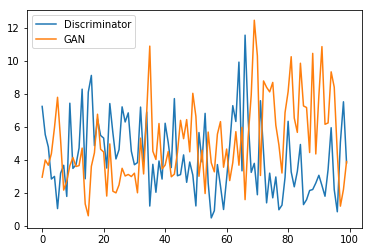

An Example from the Training Set: 


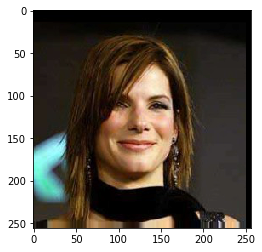

An Example from the Generator: 


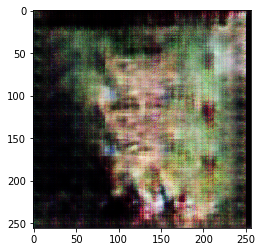

Prediction: [4.371932e-10]


--------------- Epoch: 100 ---------------
Discriminator loss: 1.2724935, GAN loss: 5.1049476

Discriminator loss: 2.840826, GAN loss: 4.3197894

Discriminator loss: 3.1260397, GAN loss: 3.3279464

Discriminator loss: 7.7947145, GAN loss: 1.2693231

Discriminator loss: 0.61522394, GAN loss: 3.7417972

Discriminator loss: 5.853424, GAN loss: 3.894978

Discriminator loss: 1.1786783, GAN loss: 4.6714215

Discriminator loss: 6.0478945, GAN loss: 1.3944199

Discriminator loss: 2.9574497, GAN loss: 3.447525

Loss History:


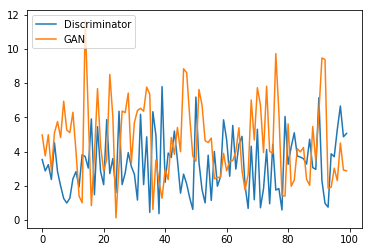

An Example from the Training Set: 


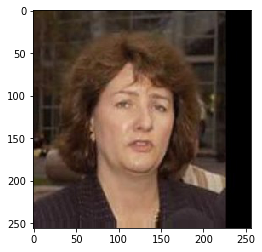

An Example from the Generator: 


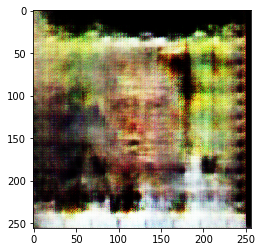

Prediction: [2.0831967e-08]


--------------- Epoch: 101 ---------------
Discriminator loss: 6.89297, GAN loss: 2.852623

Discriminator loss: 1.5450182, GAN loss: 10.09627

Discriminator loss: 2.4825299, GAN loss: 5.093992

Discriminator loss: 2.9589155, GAN loss: 5.2571554

Discriminator loss: 3.2539234, GAN loss: 6.1534066

Discriminator loss: 2.0995593, GAN loss: 2.4212866

Discriminator loss: 2.9290535, GAN loss: 4.018554

Discriminator loss: 3.302531, GAN loss: 2.915131

Discriminator loss: 5.003076, GAN loss: 9.691466

Loss History:


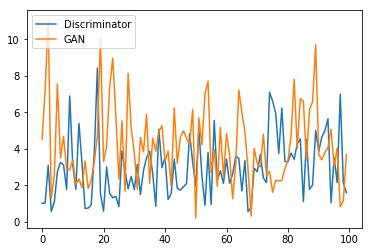

An Example from the Training Set: 


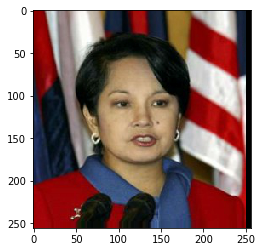

An Example from the Generator: 


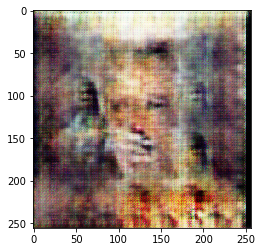

Prediction: [1.11105986e-11]


--------------- Epoch: 102 ---------------
Discriminator loss: 4.508958, GAN loss: 7.4030037

Discriminator loss: 2.1556733, GAN loss: 4.8401093

Discriminator loss: 4.041402, GAN loss: 3.780553

Discriminator loss: 2.4824393, GAN loss: 5.565732

Discriminator loss: 7.5104856, GAN loss: 2.3649666

Discriminator loss: 5.323187, GAN loss: 4.4180994

Discriminator loss: 6.653758, GAN loss: 5.378836

Discriminator loss: 4.9792223, GAN loss: 2.2697587

Discriminator loss: 2.2096896, GAN loss: 6.5258994

Loss History:


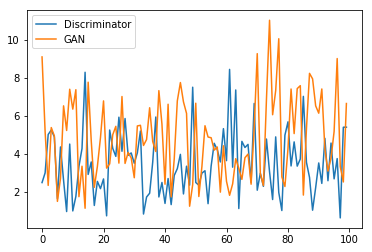

An Example from the Training Set: 


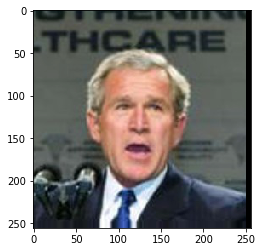

An Example from the Generator: 


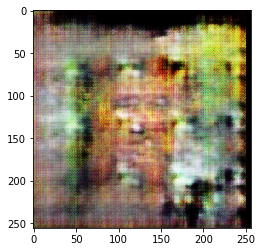

Prediction: [4.6519807e-10]


--------------- Epoch: 103 ---------------
Discriminator loss: 3.4640708, GAN loss: 3.8441787

Discriminator loss: 2.5949237, GAN loss: 7.108143

Discriminator loss: 4.623748, GAN loss: 7.7566404

Discriminator loss: 1.0410572, GAN loss: 3.7815697

Discriminator loss: 7.0512633, GAN loss: 3.092699

Discriminator loss: 3.6438873, GAN loss: 5.486537

Discriminator loss: 0.50929, GAN loss: 2.2501953

Discriminator loss: 3.122422, GAN loss: 0.7698863

Discriminator loss: 1.6424952, GAN loss: 6.306051

Loss History:


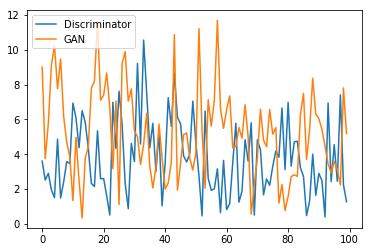

An Example from the Training Set: 


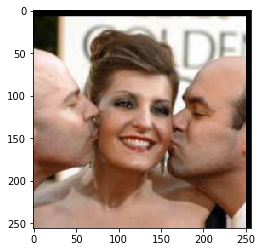

An Example from the Generator: 


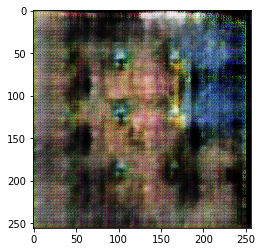

Prediction: [9.432759e-07]


--------------- Epoch: 104 ---------------
Discriminator loss: 5.54716, GAN loss: 4.3272347

Discriminator loss: 4.414212, GAN loss: 3.9011078

Discriminator loss: 6.807288, GAN loss: 0.6863983

Discriminator loss: 3.1467698, GAN loss: 6.1591487

Discriminator loss: 0.8040352, GAN loss: 6.394384

Discriminator loss: 9.6527195, GAN loss: 1.3090456

Discriminator loss: 2.8979738, GAN loss: 5.7893486

Discriminator loss: 2.3352067, GAN loss: 5.52292

Discriminator loss: 3.2798934, GAN loss: 5.476936

Loss History:


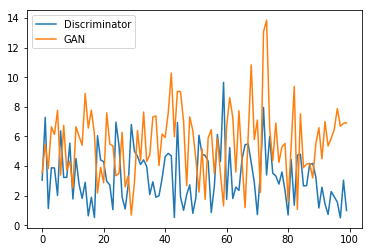

An Example from the Training Set: 


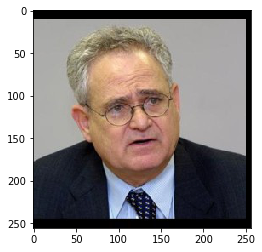

An Example from the Generator: 


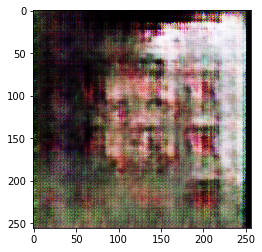

Prediction: [5.52824e-06]


--------------- Epoch: 105 ---------------
Discriminator loss: 5.7156487, GAN loss: 6.098615

Discriminator loss: 5.4114923, GAN loss: 6.4661345

Discriminator loss: 6.8843355, GAN loss: 4.9876585

Discriminator loss: 5.5044947, GAN loss: 10.048344

Discriminator loss: 3.6093662, GAN loss: 5.198966

Discriminator loss: 9.801786, GAN loss: 0.272469

Discriminator loss: 4.793586, GAN loss: 3.498294

Discriminator loss: 2.1184602, GAN loss: 9.153455

Discriminator loss: 2.463555, GAN loss: 6.827044

Loss History:


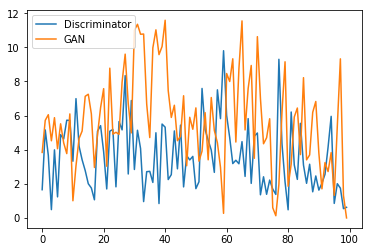

An Example from the Training Set: 


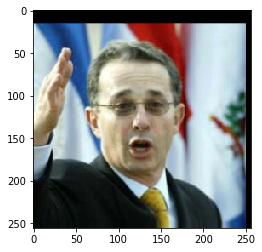

An Example from the Generator: 


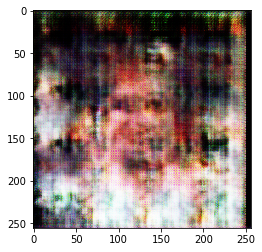

Prediction: [2.5323819e-09]


--------------- Epoch: 106 ---------------
Discriminator loss: 2.931304, GAN loss: 4.605574

Discriminator loss: 1.2663053, GAN loss: 2.9929402

Discriminator loss: 4.2897406, GAN loss: 1.8591449

Discriminator loss: 3.9080994, GAN loss: 5.252558

Discriminator loss: 2.3167386, GAN loss: 6.0467343

Discriminator loss: 3.764729, GAN loss: 4.633199

Discriminator loss: 1.3222028, GAN loss: 5.3037286

Discriminator loss: 2.2498698, GAN loss: 6.087718

Discriminator loss: 5.8788805, GAN loss: 5.5782456

Loss History:


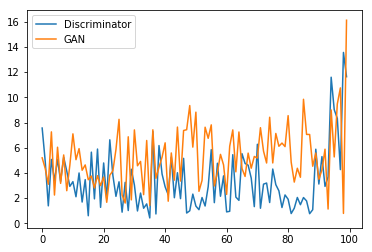

An Example from the Training Set: 


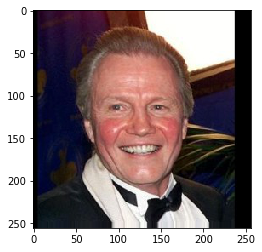

An Example from the Generator: 


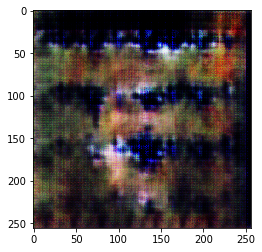

Prediction: [4.700806e-10]


--------------- Epoch: 107 ---------------
Discriminator loss: 1.3748624, GAN loss: 16.118095

Discriminator loss: 0.91692895, GAN loss: 11.776385

Discriminator loss: 2.389298, GAN loss: 8.90785

Discriminator loss: 5.8223004, GAN loss: 7.743106

Discriminator loss: 5.88128, GAN loss: 5.54769

Discriminator loss: 4.955391, GAN loss: 5.3304024

Discriminator loss: 5.752143, GAN loss: 8.572164

Discriminator loss: 3.206966, GAN loss: 9.541846

Discriminator loss: 1.3046242, GAN loss: 4.8968487

Loss History:


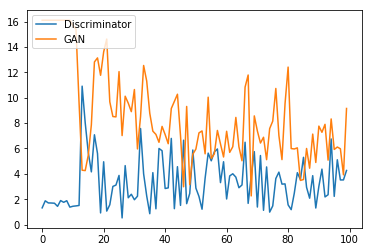

An Example from the Training Set: 


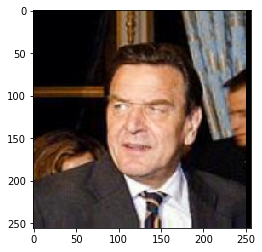

An Example from the Generator: 


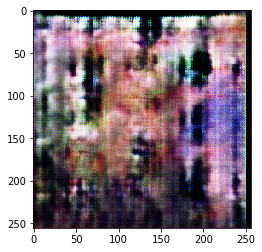

Prediction: [5.057997e-10]


--------------- Epoch: 108 ---------------
Discriminator loss: 5.0993433, GAN loss: 2.294256

Discriminator loss: 4.356723, GAN loss: 3.4999757

Discriminator loss: 2.4085248, GAN loss: 5.925887

Discriminator loss: 3.7499428, GAN loss: 8.393607

Discriminator loss: 0.92681515, GAN loss: 3.7266152

Discriminator loss: 3.65027, GAN loss: 6.933974

Discriminator loss: 2.4356532, GAN loss: 8.09682

Discriminator loss: 4.3757277, GAN loss: 5.0435305

Discriminator loss: 3.559794, GAN loss: 5.2322044

Loss History:


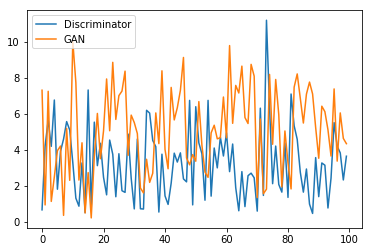

An Example from the Training Set: 


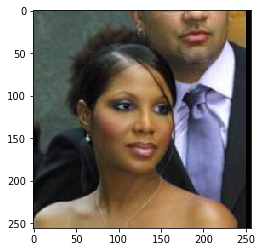

An Example from the Generator: 


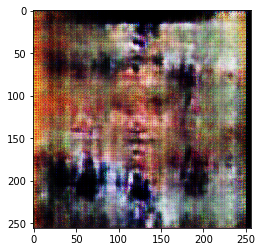

Prediction: [3.0126625e-13]


--------------- Epoch: 109 ---------------
Discriminator loss: 2.1704922, GAN loss: 7.8627396

Discriminator loss: 0.47356877, GAN loss: 0.094259635

Discriminator loss: 5.379997, GAN loss: 2.6437988

Discriminator loss: 2.3223553, GAN loss: 5.12432

Discriminator loss: 2.9645727, GAN loss: 6.7109947

Discriminator loss: 2.0860515, GAN loss: 5.8232145

Discriminator loss: 4.2703147, GAN loss: 6.5398

Discriminator loss: 1.8928127, GAN loss: 3.9280229

Discriminator loss: 3.371318, GAN loss: 3.9385357

Loss History:


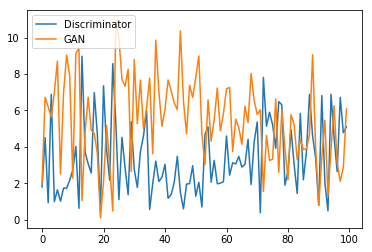

An Example from the Training Set: 


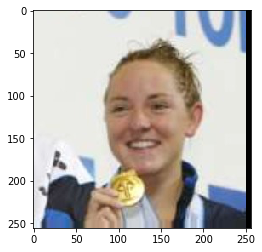

An Example from the Generator: 


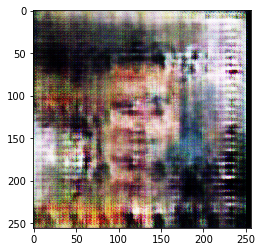

Prediction: [1.7196004e-14]


--------------- Epoch: 110 ---------------
Discriminator loss: 4.937187, GAN loss: 2.089707

Discriminator loss: 3.117766, GAN loss: 9.056231

Discriminator loss: 0.89655983, GAN loss: 3.997399

Discriminator loss: 8.167008, GAN loss: 11.006177

Discriminator loss: 5.689567, GAN loss: 5.8559256

Discriminator loss: 4.1306353, GAN loss: 7.6022973

Discriminator loss: 4.033994, GAN loss: 10.159657

Discriminator loss: 3.2033615, GAN loss: 3.7533727

Discriminator loss: 2.51213, GAN loss: 5.173482

Loss History:


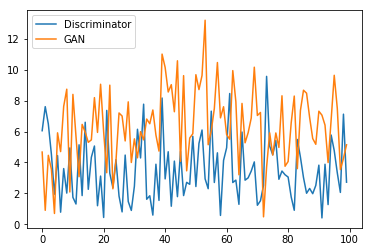

An Example from the Training Set: 


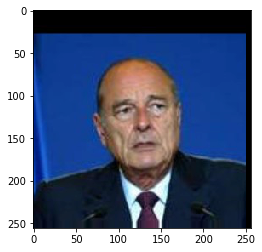

An Example from the Generator: 


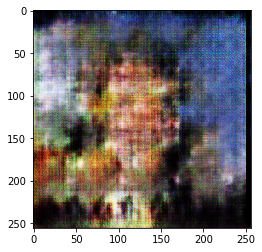

Prediction: [8.623508e-10]


--------------- Epoch: 111 ---------------
Discriminator loss: 4.9871373, GAN loss: 9.2337

Discriminator loss: 2.6739097, GAN loss: 5.43489

Discriminator loss: 4.3771715, GAN loss: 3.6583514

Discriminator loss: 3.1190479, GAN loss: 10.320075

Discriminator loss: 1.0194575, GAN loss: 2.9578853

Discriminator loss: 4.205381, GAN loss: 1.9614038

Discriminator loss: 1.3750961, GAN loss: 9.755786

Discriminator loss: 2.0229907, GAN loss: 5.184863

Discriminator loss: 12.292967, GAN loss: 6.4879313

Loss History:


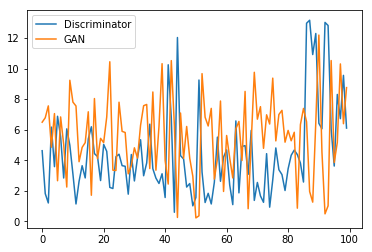

An Example from the Training Set: 


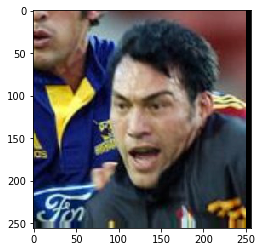

An Example from the Generator: 


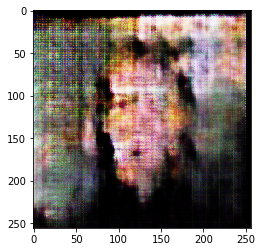

Prediction: [2.467435e-15]


--------------- Epoch: 112 ---------------
Discriminator loss: 3.48286, GAN loss: 8.619889

Discriminator loss: 2.6806097, GAN loss: 8.681161

Discriminator loss: 5.869725, GAN loss: 15.241084

Discriminator loss: 7.0345054, GAN loss: 5.929255

Discriminator loss: 3.9218204, GAN loss: 16.118095

Discriminator loss: 6.8722506, GAN loss: 12.7829075

Discriminator loss: 4.6717024, GAN loss: 8.312093

Discriminator loss: 1.5258038, GAN loss: 11.277468

Discriminator loss: 1.0203378, GAN loss: 14.047069

Loss History:


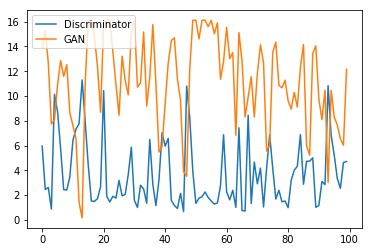

An Example from the Training Set: 


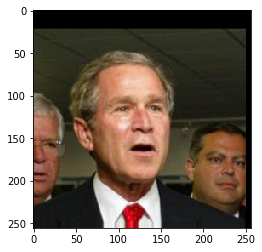

An Example from the Generator: 


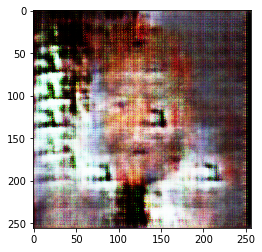

Prediction: [7.112863e-18]


--------------- Epoch: 113 ---------------
Discriminator loss: 1.6635101, GAN loss: 12.943655

Discriminator loss: 6.19929, GAN loss: 5.112584

Discriminator loss: 2.4918914, GAN loss: 6.6079254

Discriminator loss: 6.06772, GAN loss: 4.724028

Discriminator loss: 5.239696, GAN loss: 9.005327

Discriminator loss: 2.2132192, GAN loss: 4.9306884

Discriminator loss: 4.548981, GAN loss: 5.5056353

Discriminator loss: 3.4761498, GAN loss: 9.607477

Discriminator loss: 3.1275876, GAN loss: 5.475098

Loss History:


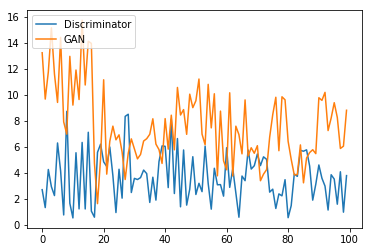

An Example from the Training Set: 


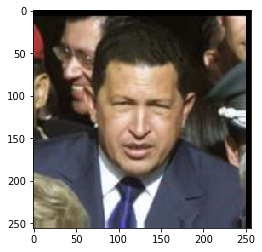

An Example from the Generator: 


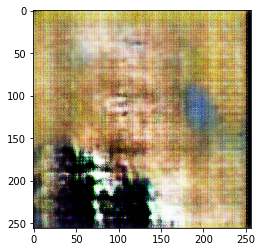

Prediction: [2.0722593e-19]


--------------- Epoch: 114 ---------------
Discriminator loss: 3.2949224, GAN loss: 6.008996

Discriminator loss: 3.3540375, GAN loss: 4.7133775

Discriminator loss: 2.6202369, GAN loss: 5.576653

Discriminator loss: 0.958218, GAN loss: 4.4491425

Discriminator loss: 1.3772379, GAN loss: 9.896638

Discriminator loss: 5.806186, GAN loss: 3.7733035

Discriminator loss: 3.417514, GAN loss: 6.2094307

Discriminator loss: 1.1073359, GAN loss: 8.981799

Discriminator loss: 4.5708094, GAN loss: 7.3538027

Loss History:


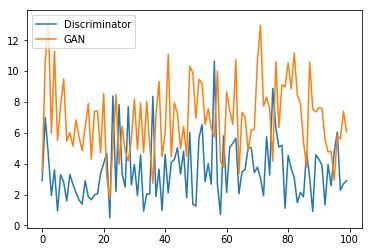

An Example from the Training Set: 


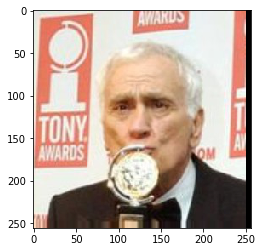

An Example from the Generator: 


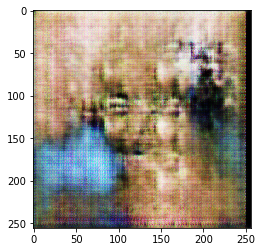

Prediction: [1.2935845e-20]


--------------- Epoch: 115 ---------------
Discriminator loss: 0.74210536, GAN loss: 10.594689

Discriminator loss: 5.9640265, GAN loss: 5.8050036

Discriminator loss: 3.4590652, GAN loss: 8.9137745

Discriminator loss: 2.301659, GAN loss: 11.531285

Discriminator loss: 1.0223734, GAN loss: 6.048538

Discriminator loss: 6.567549, GAN loss: 3.0091996

Discriminator loss: 1.5494928, GAN loss: 9.247521

Discriminator loss: 0.3962806, GAN loss: 3.7294579

Discriminator loss: 2.3757963, GAN loss: 8.560775

Loss History:


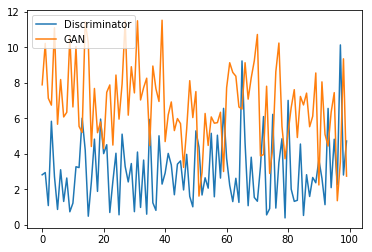

An Example from the Training Set: 


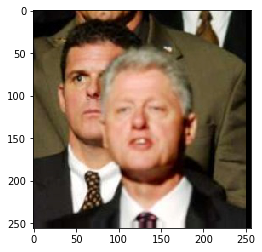

An Example from the Generator: 


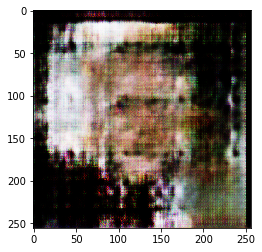

Prediction: [1.4045852e-20]


--------------- Epoch: 116 ---------------
Discriminator loss: 3.4335747, GAN loss: 9.135035

Discriminator loss: 1.7574545, GAN loss: 6.167723

Discriminator loss: 3.4105124, GAN loss: 4.901271

Discriminator loss: 2.5322611, GAN loss: 4.3483095

Discriminator loss: 2.524951, GAN loss: 7.3914704

Discriminator loss: 0.81986177, GAN loss: 4.8091393

Discriminator loss: 2.919119, GAN loss: 7.8318343

Discriminator loss: 5.7007647, GAN loss: 3.3102317

Discriminator loss: 1.1795849, GAN loss: 4.6754436

Loss History:


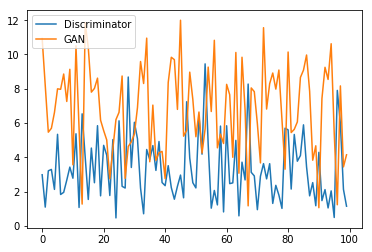

An Example from the Training Set: 


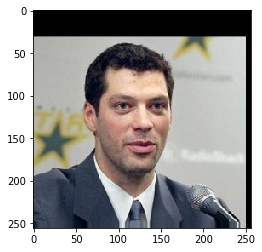

An Example from the Generator: 


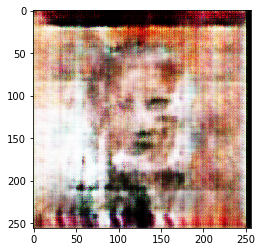

Prediction: [1.095439e-09]


--------------- Epoch: 117 ---------------
Discriminator loss: 1.9084889, GAN loss: 4.528302

Discriminator loss: 2.451315, GAN loss: 12.569168

Discriminator loss: 1.1378415, GAN loss: 5.391994

Discriminator loss: 1.7037268, GAN loss: 6.326717

Discriminator loss: 0.60167086, GAN loss: 6.982299

Discriminator loss: 9.041925, GAN loss: 0.5598718

Discriminator loss: 5.020972, GAN loss: 7.672229

Discriminator loss: 3.5689888, GAN loss: 8.852854

Discriminator loss: 5.4224563, GAN loss: 3.2043705

Loss History:


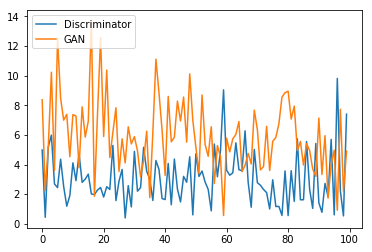

An Example from the Training Set: 


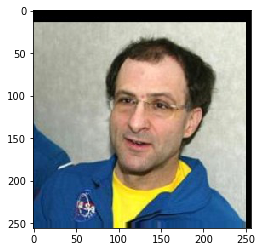

An Example from the Generator: 


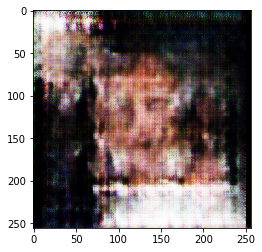

Prediction: [1.5204342e-13]


--------------- Epoch: 118 ---------------
Discriminator loss: 0.97542685, GAN loss: 7.9186378

Discriminator loss: 1.7744799, GAN loss: 4.9258432

Discriminator loss: 1.2912126, GAN loss: 7.499321

Discriminator loss: 1.9422632, GAN loss: 10.641915

Discriminator loss: 4.001479, GAN loss: 10.985599

Discriminator loss: 2.0993829, GAN loss: 8.379068

Discriminator loss: 1.2894901, GAN loss: 6.2233143

Discriminator loss: 2.395768, GAN loss: 3.0056317

Discriminator loss: 3.678138, GAN loss: 5.998107

Loss History:


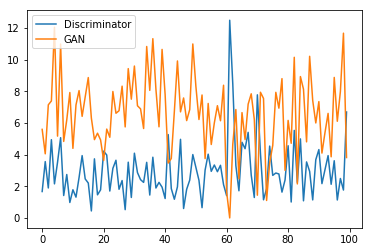

An Example from the Training Set: 


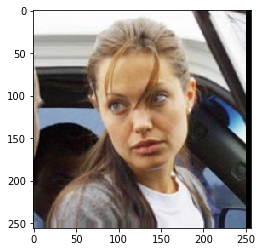

An Example from the Generator: 


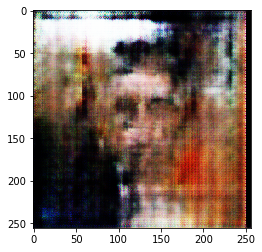

Prediction: [2.8235995e-17]


--------------- Epoch: 119 ---------------
Discriminator loss: 1.7227201, GAN loss: 8.0969515

Discriminator loss: 6.963392, GAN loss: 8.365113

Discriminator loss: 4.129407, GAN loss: 9.422701

Discriminator loss: 2.9343724, GAN loss: 11.330902

Discriminator loss: 3.48511, GAN loss: 6.7820344

Discriminator loss: 1.9385284, GAN loss: 8.709046

Discriminator loss: 2.0611484, GAN loss: 6.5146346

Discriminator loss: 4.3025513, GAN loss: 9.035194

Discriminator loss: 1.3333167, GAN loss: 7.2002892

Loss History:


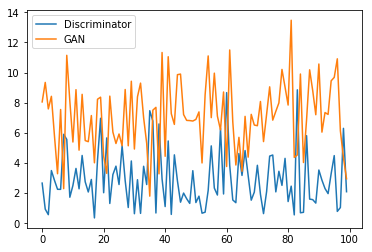

An Example from the Training Set: 


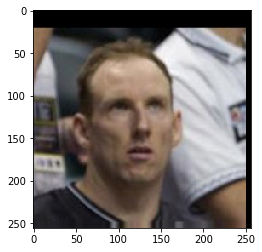

An Example from the Generator: 


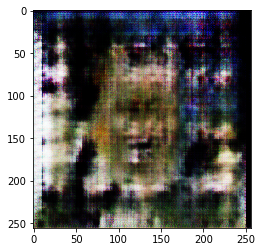

Prediction: [1.4597369e-18]


--------------- Epoch: 120 ---------------
Discriminator loss: 6.3911963, GAN loss: 8.498558

Discriminator loss: 5.2818546, GAN loss: 11.751951

Discriminator loss: 4.984061, GAN loss: 4.234267

Discriminator loss: 0.52729267, GAN loss: 7.0680795

Discriminator loss: 1.9042146, GAN loss: 14.920858

Discriminator loss: 2.0335853, GAN loss: 7.056671

Discriminator loss: 4.7397966, GAN loss: 5.7598467

Discriminator loss: 8.355614, GAN loss: 2.0927315

Discriminator loss: 9.023048, GAN loss: 13.495112

Loss History:


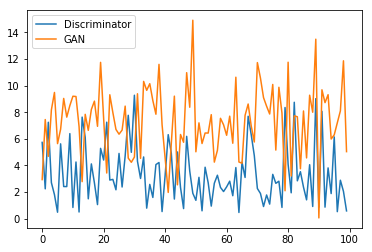

An Example from the Training Set: 


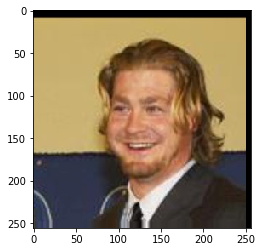

An Example from the Generator: 


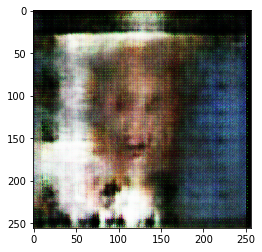

Prediction: [2.138909e-15]


--------------- Epoch: 121 ---------------
Discriminator loss: 2.6735814, GAN loss: 11.506945

Discriminator loss: 3.4337897, GAN loss: 4.179207

Discriminator loss: 3.0699642, GAN loss: 5.6474924

Discriminator loss: 0.7562945, GAN loss: 6.91389

Discriminator loss: 3.499637, GAN loss: 11.59601

Discriminator loss: 3.3671055, GAN loss: 2.7785816

Discriminator loss: 4.61514, GAN loss: 9.299889

Discriminator loss: 1.2564095, GAN loss: 6.5875115

Discriminator loss: 2.90152, GAN loss: 6.525946

Loss History:


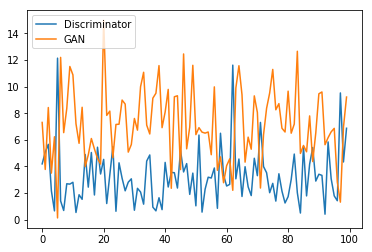

An Example from the Training Set: 


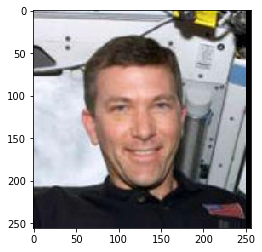

An Example from the Generator: 


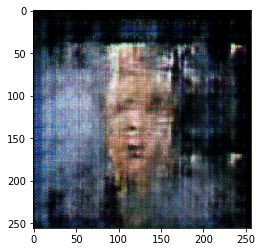

Prediction: [3.477336e-13]


--------------- Epoch: 122 ---------------
Discriminator loss: 2.3444154, GAN loss: 1.4794093

Discriminator loss: 3.653809, GAN loss: 5.138686

Discriminator loss: 3.3318985, GAN loss: 8.54764

Discriminator loss: 1.6014719, GAN loss: 10.443123

Discriminator loss: 0.9962317, GAN loss: 2.5052323

Discriminator loss: 0.8843872, GAN loss: 3.801925

Discriminator loss: 1.4846989, GAN loss: 6.675199

Discriminator loss: 1.5598072, GAN loss: 6.9379816

Discriminator loss: 3.4552174, GAN loss: 11.171522

Loss History:


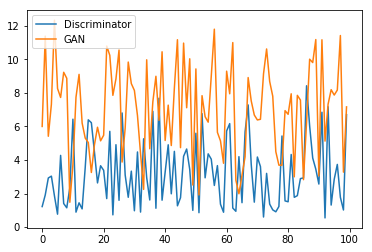

An Example from the Training Set: 


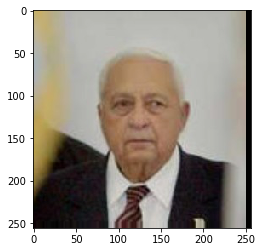

An Example from the Generator: 


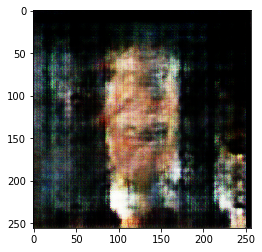

Prediction: [5.267593e-05]


--------------- Epoch: 123 ---------------
Discriminator loss: 1.1791484, GAN loss: 5.769044

Discriminator loss: 4.9834557, GAN loss: 11.808168

Discriminator loss: 3.702451, GAN loss: 10.005488

Discriminator loss: 1.4119983, GAN loss: 6.4567404

Discriminator loss: 3.3533454, GAN loss: 7.6549387

Discriminator loss: 1.3125962, GAN loss: 8.447741

Discriminator loss: 5.2323704, GAN loss: 7.2644553

Discriminator loss: 1.6189283, GAN loss: 5.0362577

Discriminator loss: 1.9460847, GAN loss: 5.8667884

Loss History:


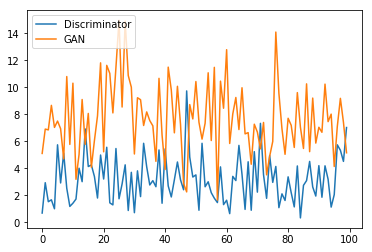

An Example from the Training Set: 


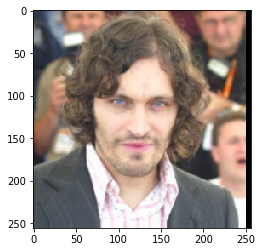

An Example from the Generator: 


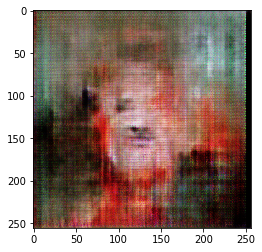

Prediction: [1.0317446e-09]


--------------- Epoch: 124 ---------------
Discriminator loss: 2.173554, GAN loss: 8.852602

Discriminator loss: 2.332337, GAN loss: 5.7237053

Discriminator loss: 3.6002803, GAN loss: 4.865861

Discriminator loss: 2.2211792, GAN loss: 9.721254

Discriminator loss: 2.7974632, GAN loss: 7.120639

Discriminator loss: 0.4158233, GAN loss: 5.0050488

Discriminator loss: 4.286276, GAN loss: 12.18752

Discriminator loss: 3.7980106, GAN loss: 8.659739

Discriminator loss: 4.463166, GAN loss: 7.497866

Loss History:


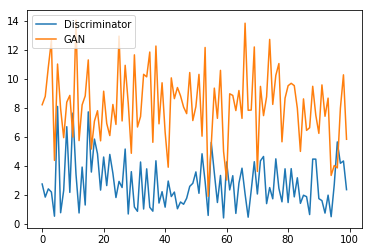

An Example from the Training Set: 


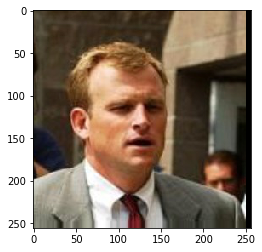

An Example from the Generator: 


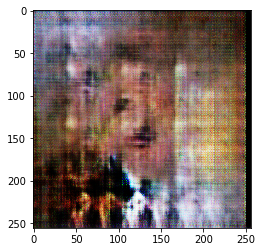

Prediction: [6.9593493e-12]


--------------- Epoch: 125 ---------------
Discriminator loss: 5.4637704, GAN loss: 8.757277

Discriminator loss: 6.905349, GAN loss: 7.1551657

Discriminator loss: 4.6590405, GAN loss: 8.388641

Discriminator loss: 1.1756814, GAN loss: 0.80336297

Discriminator loss: 9.691404, GAN loss: 5.3367906

Discriminator loss: 3.672221, GAN loss: 7.1145773

Discriminator loss: 3.5999203, GAN loss: 7.5349655

Discriminator loss: 4.7273893, GAN loss: 6.113358

Discriminator loss: 4.8269606, GAN loss: 10.896231

Loss History:


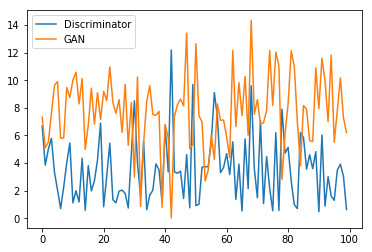

An Example from the Training Set: 


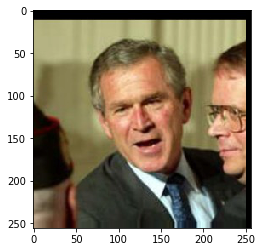

An Example from the Generator: 


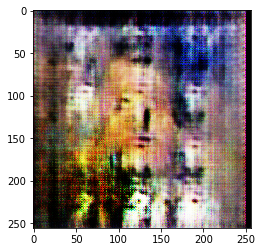

Prediction: [2.879434e-16]


--------------- Epoch: 126 ---------------
Discriminator loss: 2.1910121, GAN loss: 7.5441146

Discriminator loss: 1.2477728, GAN loss: 11.632631

Discriminator loss: 0.72776526, GAN loss: 8.454552

Discriminator loss: 1.3280399, GAN loss: 7.6553087

Discriminator loss: 2.6603832, GAN loss: 6.4653916

Discriminator loss: 2.5526614, GAN loss: 11.08343

Discriminator loss: 0.86367303, GAN loss: 8.415517

Discriminator loss: 0.5194627, GAN loss: 9.682425

Discriminator loss: 9.132181, GAN loss: 2.4100387

Loss History:


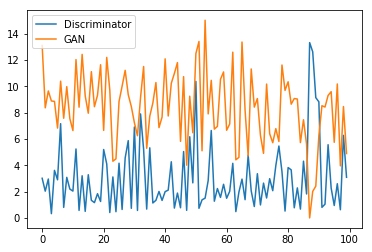

An Example from the Training Set: 


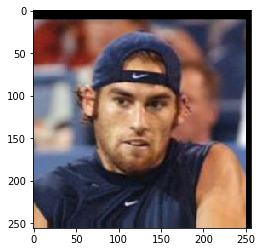

An Example from the Generator: 


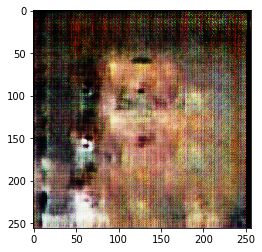

Prediction: [2.3946032e-17]


--------------- Epoch: 127 ---------------
Discriminator loss: 3.9938035, GAN loss: 10.22521

Discriminator loss: 2.231474, GAN loss: 12.980677

Discriminator loss: 5.3426347, GAN loss: 13.57478

Discriminator loss: 3.6886525, GAN loss: 11.247127

Discriminator loss: 4.5412474, GAN loss: 3.3583577

Discriminator loss: 2.1105342, GAN loss: 3.5910172

Discriminator loss: 2.410115, GAN loss: 9.2958

Discriminator loss: 3.5607686, GAN loss: 10.619612

Discriminator loss: 5.926012, GAN loss: 10.813586

Loss History:


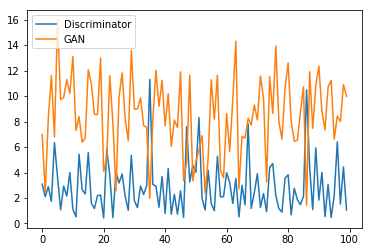

An Example from the Training Set: 


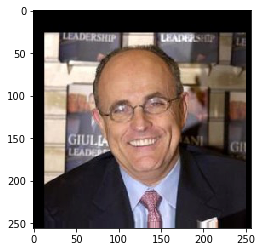

An Example from the Generator: 


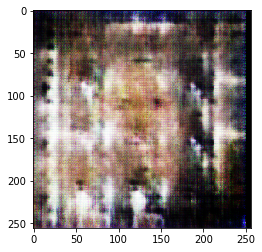

Prediction: [1.4613585e-14]


--------------- Epoch: 128 ---------------
Discriminator loss: 2.2383673, GAN loss: 12.66854

Discriminator loss: 0.89097273, GAN loss: 8.914161

Discriminator loss: 9.069292, GAN loss: 4.9715075

Discriminator loss: 5.1437345, GAN loss: 5.250195

Discriminator loss: 0.7069082, GAN loss: 2.7801147

Discriminator loss: 0.5236166, GAN loss: 6.2469397

Discriminator loss: 1.1594901, GAN loss: 10.913515

Discriminator loss: 2.9119413, GAN loss: 14.263501

Discriminator loss: 2.3605008, GAN loss: 6.69253

Loss History:


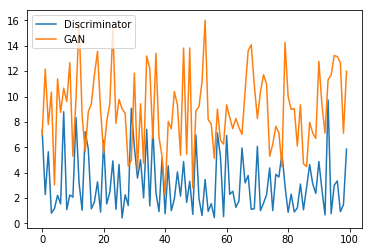

An Example from the Training Set: 


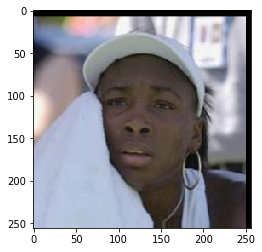

An Example from the Generator: 


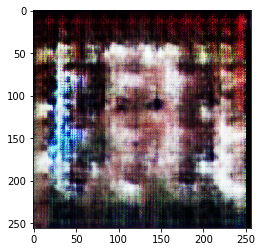

Prediction: [1.1199109e-18]


--------------- Epoch: 129 ---------------
Discriminator loss: 3.7545006, GAN loss: 11.6092825

Discriminator loss: 1.1870631, GAN loss: 8.040853

Discriminator loss: 0.7197015, GAN loss: 5.204152

Discriminator loss: 1.2529097, GAN loss: 3.870496

Discriminator loss: 4.996576, GAN loss: 10.391451

Discriminator loss: 1.8914515, GAN loss: 9.145829

Discriminator loss: 3.9392617, GAN loss: 10.165192

Discriminator loss: 1.653421, GAN loss: 8.969847

Discriminator loss: 5.684948, GAN loss: 1.9041535

Loss History:


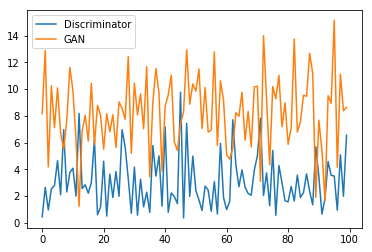

An Example from the Training Set: 


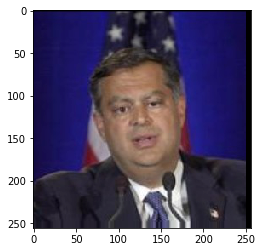

An Example from the Generator: 


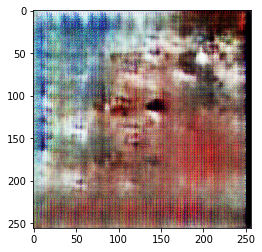

Prediction: [2.5199327e-23]


--------------- Epoch: 130 ---------------
Discriminator loss: 2.0642002, GAN loss: 8.75023

Discriminator loss: 0.7876681, GAN loss: 10.221788

Discriminator loss: 4.830191, GAN loss: 11.676792

Discriminator loss: 5.821514, GAN loss: 12.061129

Discriminator loss: 0.9623569, GAN loss: 9.224833

Discriminator loss: 3.9464238, GAN loss: 10.211134

Discriminator loss: 2.593345, GAN loss: 8.653044

Discriminator loss: 0.42584333, GAN loss: 4.260192

Discriminator loss: 3.5482311, GAN loss: 12.210958

Loss History:


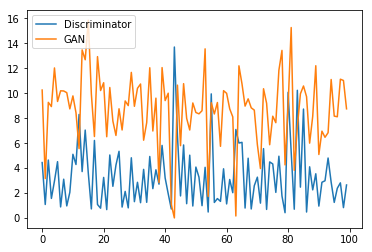

An Example from the Training Set: 


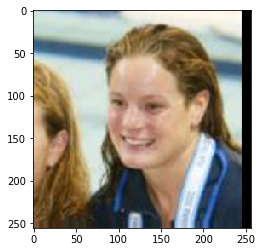

An Example from the Generator: 


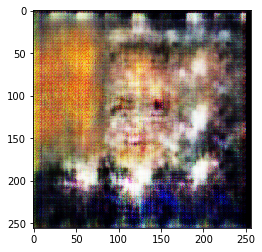

Prediction: [3.1803314e-24]


--------------- Epoch: 131 ---------------
Discriminator loss: 4.163263, GAN loss: 11.896011

Discriminator loss: 0.3772236, GAN loss: 8.938013

Discriminator loss: 12.117899, GAN loss: 2.2567682

Discriminator loss: 4.0623255, GAN loss: 12.757809

Discriminator loss: 1.4272465, GAN loss: 4.399683

Discriminator loss: 1.0171198, GAN loss: 7.8600206

Discriminator loss: 10.99436, GAN loss: 2.4276633

Discriminator loss: 2.8150616, GAN loss: 9.250343

Discriminator loss: 2.0645094, GAN loss: 3.7756786

Loss History:


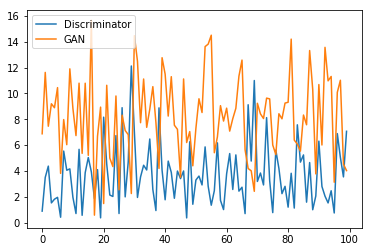

An Example from the Training Set: 


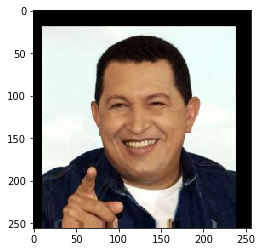

An Example from the Generator: 


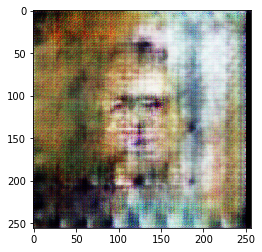

Prediction: [4.5687865e-25]


--------------- Epoch: 132 ---------------
Discriminator loss: 2.5412285, GAN loss: 9.94471

Discriminator loss: 4.27674, GAN loss: 8.305436

Discriminator loss: 1.0331938, GAN loss: 7.294612

Discriminator loss: 0.68985784, GAN loss: 6.49191

Discriminator loss: 1.6399246, GAN loss: 2.6692314

Discriminator loss: 7.1211348, GAN loss: 7.7415824

Discriminator loss: 5.0618777, GAN loss: 8.115587

Discriminator loss: 3.9209056, GAN loss: 13.728012

Discriminator loss: 3.7696445, GAN loss: 11.112826

Loss History:


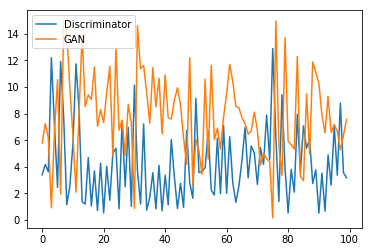

An Example from the Training Set: 


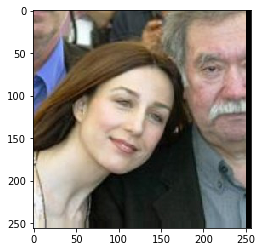

An Example from the Generator: 


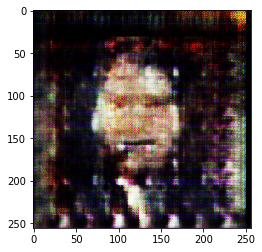

Prediction: [2.8355322e-28]


--------------- Epoch: 133 ---------------
Discriminator loss: 1.0904478, GAN loss: 4.6944685

Discriminator loss: 1.9287875, GAN loss: 12.4442425

Discriminator loss: 4.243819, GAN loss: 10.712373

Discriminator loss: 2.7742386, GAN loss: 6.233562

Discriminator loss: 3.060288, GAN loss: 6.252453

Discriminator loss: 3.7894669, GAN loss: 11.071522

Discriminator loss: 2.4517667, GAN loss: 5.8672132

Discriminator loss: 2.593956, GAN loss: 11.504916

Discriminator loss: 1.2822845, GAN loss: 8.391478

Loss History:


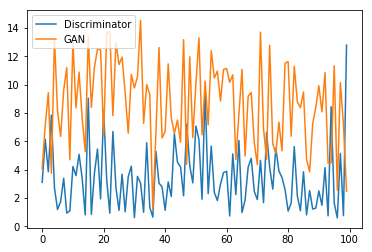

An Example from the Training Set: 


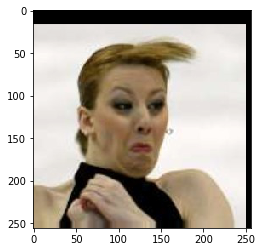

An Example from the Generator: 


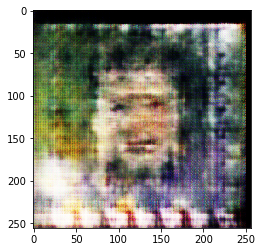

Prediction: [5.055594e-29]


--------------- Epoch: 134 ---------------
Discriminator loss: 9.971759, GAN loss: 10.217833

Discriminator loss: 2.1432803, GAN loss: 6.6577024

Discriminator loss: 1.4327675, GAN loss: 2.2096307

Discriminator loss: 5.3508945, GAN loss: 9.828311

Discriminator loss: 1.8593069, GAN loss: 9.280466

Discriminator loss: 1.8708556, GAN loss: 8.474902

Discriminator loss: 3.5384278, GAN loss: 12.352629

Discriminator loss: 2.934786, GAN loss: 12.297678

Discriminator loss: 0.70594704, GAN loss: 8.644951

Loss History:


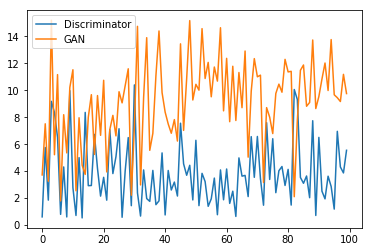

An Example from the Training Set: 


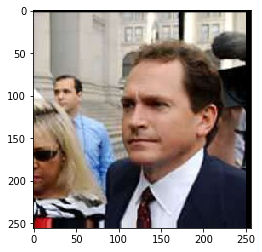

An Example from the Generator: 


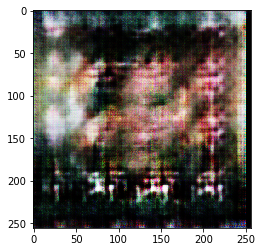

Prediction: [1.2259714e-26]


--------------- Epoch: 135 ---------------
Discriminator loss: 1.1118782, GAN loss: 3.0926313

Discriminator loss: 1.3114817, GAN loss: 9.088663

Discriminator loss: 1.2597868, GAN loss: 5.2071943

Discriminator loss: 5.610733, GAN loss: 14.229474

Discriminator loss: 8.732265, GAN loss: 4.8648777

Discriminator loss: 3.3664079, GAN loss: 6.048396

Discriminator loss: 1.605704, GAN loss: 8.776128

Discriminator loss: 2.181346, GAN loss: 5.6096044

Discriminator loss: 0.59192824, GAN loss: 8.177281

Loss History:


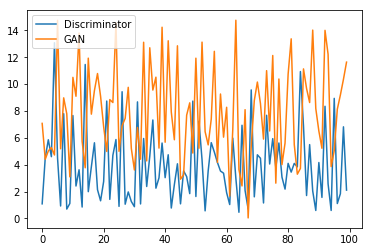

An Example from the Training Set: 


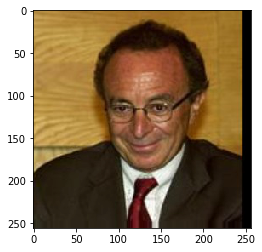

An Example from the Generator: 


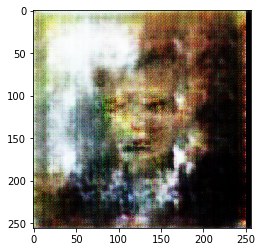

Prediction: [5.372714e-27]


--------------- Epoch: 136 ---------------
Discriminator loss: 4.034621, GAN loss: 12.75912

Discriminator loss: 4.840654, GAN loss: 12.051068

Discriminator loss: 6.792012, GAN loss: 6.4599533

Discriminator loss: 7.0402765, GAN loss: 6.0365224

Discriminator loss: 10.945863, GAN loss: 1.7861038

Discriminator loss: 8.949093, GAN loss: 9.294426

Discriminator loss: 2.8621025, GAN loss: 5.9173117

Discriminator loss: 3.926046, GAN loss: 6.615917

Discriminator loss: 5.521214, GAN loss: 9.346346

Loss History:


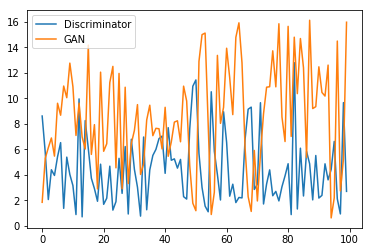

An Example from the Training Set: 


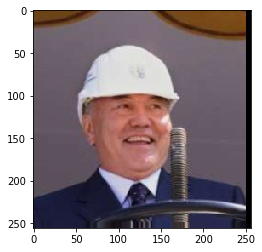

An Example from the Generator: 


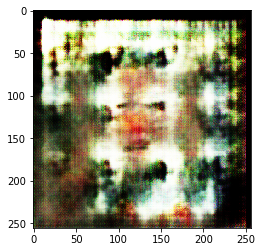

Prediction: [0.7470827]


--------------- Epoch: 137 ---------------
Discriminator loss: 1.393419, GAN loss: 16.118095

Discriminator loss: 2.08806, GAN loss: 11.538796

Discriminator loss: 0.7616519, GAN loss: 10.545474

Discriminator loss: 9.292587, GAN loss: 4.3943

Discriminator loss: 2.1837544, GAN loss: 10.752553

Discriminator loss: 5.786782, GAN loss: 6.093856

Discriminator loss: 1.892691, GAN loss: 11.423459

Discriminator loss: 1.4640834, GAN loss: 6.885054

Discriminator loss: 3.9205823, GAN loss: 10.472582

Loss History:


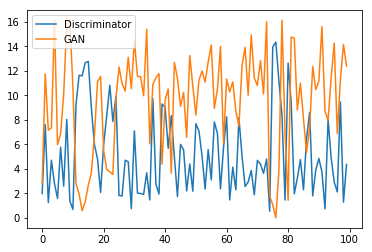

An Example from the Training Set: 


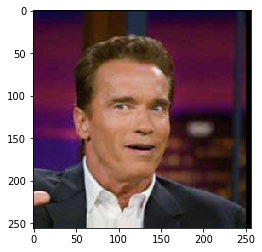

An Example from the Generator: 


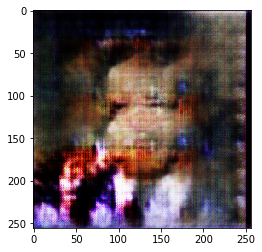

Prediction: [7.494667e-09]


--------------- Epoch: 138 ---------------
Discriminator loss: 3.0950866, GAN loss: 15.465563

Discriminator loss: 1.1409127, GAN loss: 12.307482

Discriminator loss: 0.8570223, GAN loss: 14.113884

Discriminator loss: 1.210083, GAN loss: 8.391095

Discriminator loss: 2.2924664, GAN loss: 14.182497

Discriminator loss: 3.7839005, GAN loss: 3.8909092

Discriminator loss: 3.5021515, GAN loss: 12.694807

Discriminator loss: 6.689775, GAN loss: 12.717606

Discriminator loss: 14.304912, GAN loss: 1.1920933e-07

Loss History:


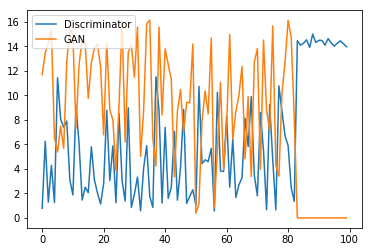

An Example from the Training Set: 


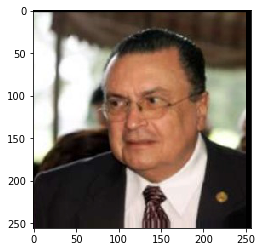

An Example from the Generator: 


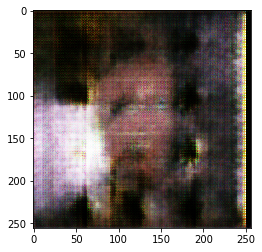

Prediction: [1.0660261e-12]


--------------- Epoch: 139 ---------------
Discriminator loss: 12.603571, GAN loss: 2.8799605

Discriminator loss: 9.624952, GAN loss: 14.519183

Discriminator loss: 3.186409, GAN loss: 10.93219

Discriminator loss: 3.3187852, GAN loss: 12.436705

Discriminator loss: 1.4124936, GAN loss: 10.893776

Discriminator loss: 2.4621243, GAN loss: 8.192506

Discriminator loss: 10.766207, GAN loss: 9.327939

Discriminator loss: 3.5397675, GAN loss: 13.746744

Discriminator loss: 3.166205, GAN loss: 3.7906551

Loss History:


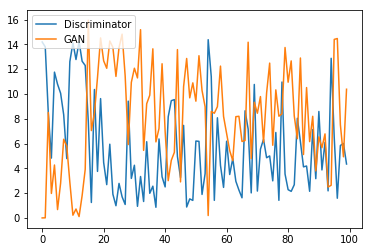

An Example from the Training Set: 


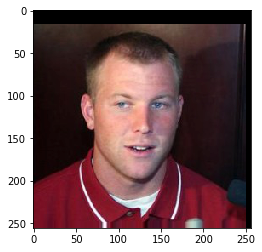

An Example from the Generator: 


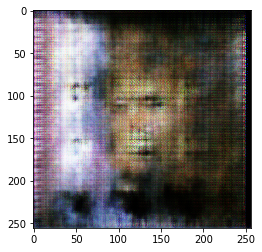

Prediction: [2.0522698e-07]


--------------- Epoch: 140 ---------------
Discriminator loss: 4.959072, GAN loss: 11.450498

Discriminator loss: 1.1873628, GAN loss: 9.38944

Discriminator loss: 1.0309443, GAN loss: 11.025118

Discriminator loss: 3.6222522, GAN loss: 12.644281

Discriminator loss: 5.87163, GAN loss: 15.669296

Discriminator loss: 3.1024902, GAN loss: 10.220843

Discriminator loss: 4.372139, GAN loss: 15.071231

Discriminator loss: 2.7795417, GAN loss: 6.5732336

Discriminator loss: 10.280704, GAN loss: 6.7817755

Loss History:


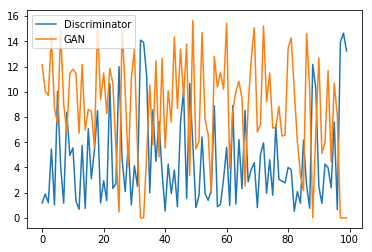

An Example from the Training Set: 


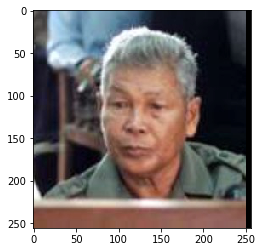

An Example from the Generator: 


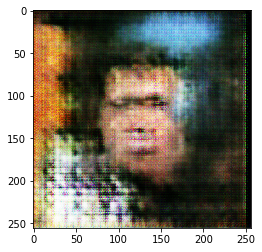

Prediction: [1.4057832e-09]


--------------- Epoch: 141 ---------------
Discriminator loss: 14.2931385, GAN loss: 1.1920933e-07

Discriminator loss: 14.272197, GAN loss: 1.1920933e-07

Discriminator loss: 14.356504, GAN loss: 1.1920933e-07

Discriminator loss: 14.383375, GAN loss: 1.1920933e-07

Discriminator loss: 12.903427, GAN loss: 0.00020342859

Discriminator loss: 6.1540766, GAN loss: 12.775126

Discriminator loss: 0.52695644, GAN loss: 8.542376

Discriminator loss: 7.5099206, GAN loss: 13.105955

Discriminator loss: 14.407583, GAN loss: 1.1920933e-07

Loss History:


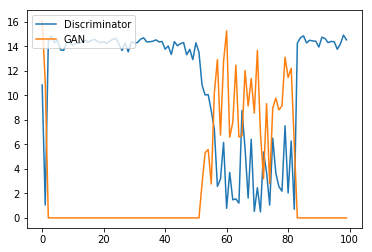

An Example from the Training Set: 


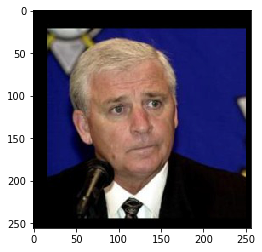

An Example from the Generator: 


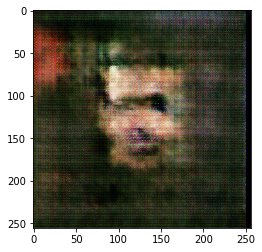

Prediction: [1.3580909e-11]


--------------- Epoch: 142 ---------------
Discriminator loss: 14.170591, GAN loss: 1.1920933e-07

Discriminator loss: 14.394033, GAN loss: 1.1920933e-07

Discriminator loss: 14.578807, GAN loss: 1.1920933e-07

Discriminator loss: 14.566397, GAN loss: 1.1920933e-07

Discriminator loss: 14.415808, GAN loss: 1.1920933e-07

Discriminator loss: 14.920558, GAN loss: 1.1920933e-07

Discriminator loss: 14.205043, GAN loss: 1.1920933e-07

Discriminator loss: 14.164996, GAN loss: 1.1920933e-07

Discriminator loss: 14.007719, GAN loss: 1.1920933e-07

Loss History:


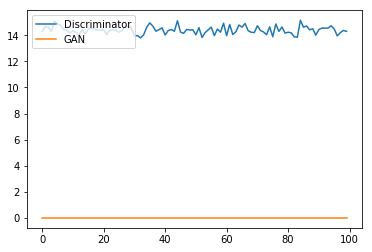

An Example from the Training Set: 


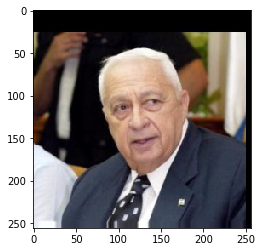

An Example from the Generator: 


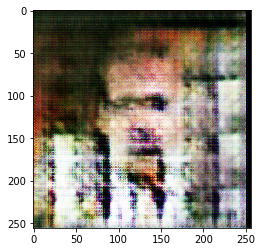

Prediction: [2.6961686e-07]


--------------- Epoch: 143 ---------------
Discriminator loss: 14.206032, GAN loss: 1.1920933e-07

Discriminator loss: 14.71201, GAN loss: 1.1920933e-07

Discriminator loss: 14.292458, GAN loss: 1.1920933e-07

Discriminator loss: 14.337123, GAN loss: 1.1920933e-07

Discriminator loss: 14.86167, GAN loss: 1.1920933e-07

Discriminator loss: 13.8108015, GAN loss: 1.1920933e-07

Discriminator loss: 14.261746, GAN loss: 1.1920933e-07

Discriminator loss: 14.511584, GAN loss: 1.1920933e-07

Discriminator loss: 14.294329, GAN loss: 1.1920933e-07

Loss History:


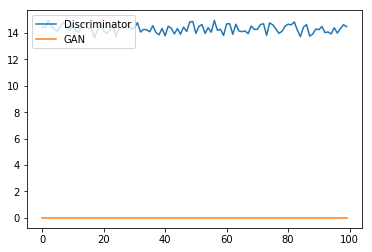

An Example from the Training Set: 


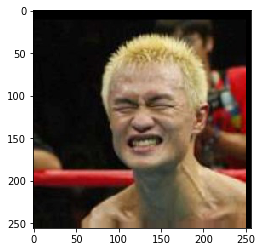

An Example from the Generator: 


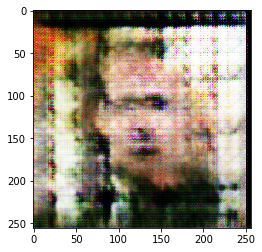

Prediction: [6.1615154e-08]


--------------- Epoch: 144 ---------------
Discriminator loss: 14.377693, GAN loss: 1.1920933e-07

Discriminator loss: 14.82403, GAN loss: 1.1920933e-07

Discriminator loss: 14.325439, GAN loss: 1.1920933e-07

Discriminator loss: 14.05484, GAN loss: 1.1920933e-07

Discriminator loss: 14.033557, GAN loss: 1.1920933e-07

Discriminator loss: 14.2012, GAN loss: 1.1920933e-07

Discriminator loss: 14.646505, GAN loss: 1.1920933e-07

Discriminator loss: 14.31568, GAN loss: 1.1920933e-07

Discriminator loss: 14.363226, GAN loss: 1.1920933e-07

Loss History:


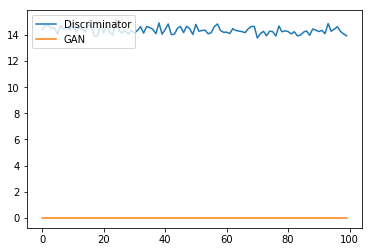

An Example from the Training Set: 


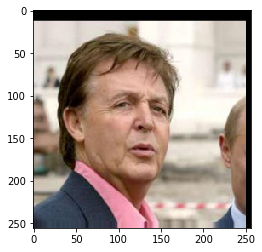

An Example from the Generator: 


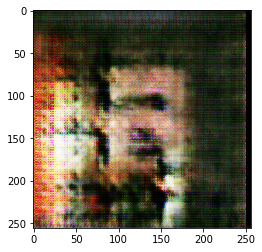

Prediction: [2.4763663e-10]


--------------- Epoch: 145 ---------------
Discriminator loss: 14.527321, GAN loss: 1.1920933e-07

Discriminator loss: 14.320578, GAN loss: 1.1920933e-07

Discriminator loss: 14.570297, GAN loss: 1.1920933e-07

Discriminator loss: 14.264475, GAN loss: 1.1920933e-07

Discriminator loss: 14.208676, GAN loss: 1.1920933e-07

Discriminator loss: 14.658007, GAN loss: 1.1920933e-07

Discriminator loss: 14.674154, GAN loss: 1.1920933e-07

Discriminator loss: 14.487991, GAN loss: 1.1920933e-07

Discriminator loss: 14.460577, GAN loss: 1.1920933e-07

Loss History:


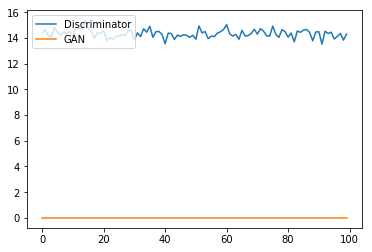

An Example from the Training Set: 


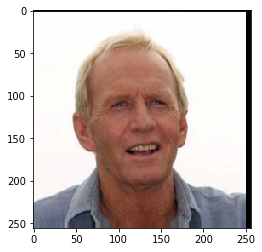

An Example from the Generator: 


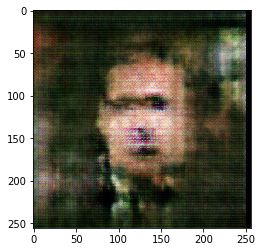

Prediction: [2.0720603e-09]


--------------- Epoch: 146 ---------------
Discriminator loss: 14.2786255, GAN loss: 1.1920933e-07

Discriminator loss: 14.330643, GAN loss: 1.1920933e-07

Discriminator loss: 14.609766, GAN loss: 1.1920933e-07

Discriminator loss: 14.131758, GAN loss: 1.1920933e-07

Discriminator loss: 13.839788, GAN loss: 1.1920933e-07

Discriminator loss: 14.442902, GAN loss: 1.1920933e-07

Discriminator loss: 15.182196, GAN loss: 1.1920933e-07

Discriminator loss: 14.207678, GAN loss: 1.1920933e-07

Discriminator loss: 14.120399, GAN loss: 1.1920933e-07

Loss History:


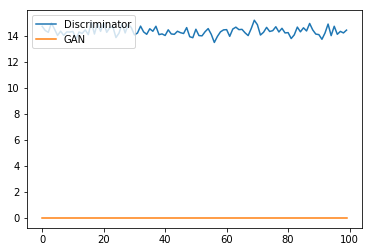

An Example from the Training Set: 


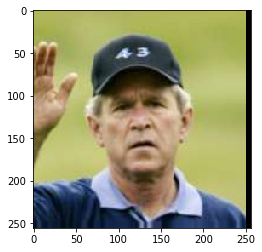

An Example from the Generator: 


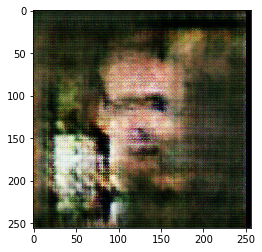

Prediction: [3.2342553e-09]


--------------- Epoch: 147 ---------------
Discriminator loss: 14.591144, GAN loss: 1.1920933e-07

Discriminator loss: 14.383377, GAN loss: 1.1920933e-07

Discriminator loss: 14.441607, GAN loss: 1.1920933e-07

Discriminator loss: 14.416751, GAN loss: 1.1920933e-07

Discriminator loss: 14.525789, GAN loss: 1.1920933e-07

Discriminator loss: 14.512039, GAN loss: 1.1920933e-07

Discriminator loss: 14.663388, GAN loss: 1.1920933e-07

Discriminator loss: 14.312589, GAN loss: 1.1920933e-07

Discriminator loss: 14.377927, GAN loss: 1.1920933e-07

Loss History:


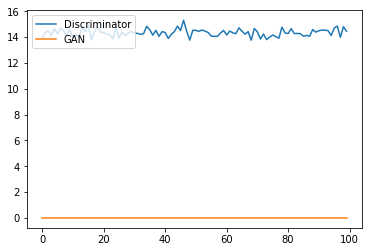

An Example from the Training Set: 


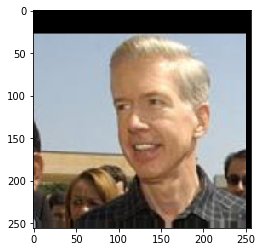

An Example from the Generator: 


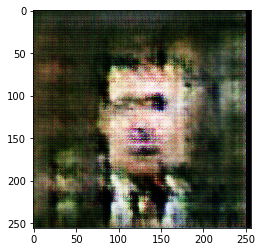

Prediction: [2.9859944e-08]


--------------- Epoch: 148 ---------------
Discriminator loss: 14.258867, GAN loss: 1.1920933e-07

Discriminator loss: 14.259921, GAN loss: 1.1920933e-07

Discriminator loss: 14.337689, GAN loss: 1.1920933e-07

Discriminator loss: 14.600499, GAN loss: 1.1920933e-07

Discriminator loss: 14.033475, GAN loss: 1.1920933e-07

Discriminator loss: 14.365366, GAN loss: 1.1920933e-07

Discriminator loss: 13.838282, GAN loss: 1.1920933e-07

Discriminator loss: 14.488383, GAN loss: 1.1920933e-07

Discriminator loss: 14.37409, GAN loss: 1.1920933e-07

Loss History:


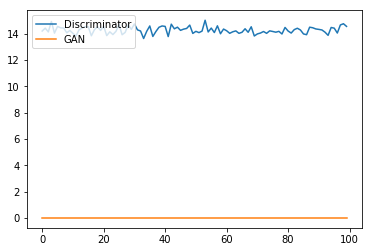

An Example from the Training Set: 


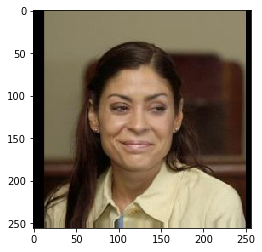

An Example from the Generator: 


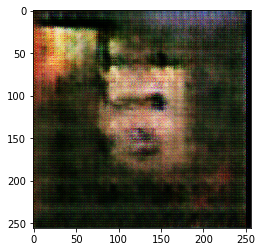

Prediction: [1.7992693e-09]


--------------- Epoch: 149 ---------------
Discriminator loss: 14.364224, GAN loss: 1.1920933e-07

Discriminator loss: 14.365744, GAN loss: 1.1920933e-07

Discriminator loss: 13.984331, GAN loss: 1.1920933e-07

Discriminator loss: 14.368688, GAN loss: 1.1920933e-07

Discriminator loss: 14.844933, GAN loss: 1.1920933e-07

Discriminator loss: 14.221448, GAN loss: 1.1920933e-07

Discriminator loss: 14.622073, GAN loss: 1.1920933e-07

Discriminator loss: 14.367052, GAN loss: 1.1920933e-07

Discriminator loss: 14.209845, GAN loss: 1.1920933e-07

Loss History:


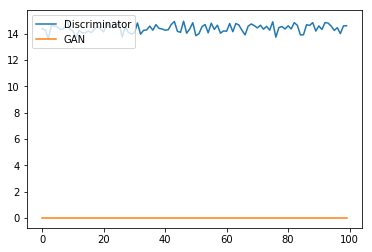

An Example from the Training Set: 


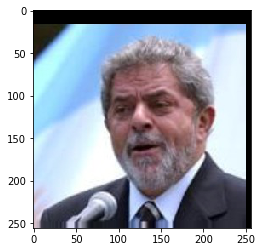

An Example from the Generator: 


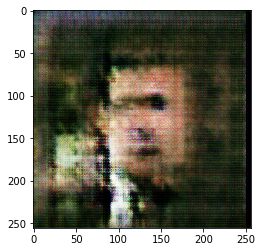

Prediction: [1.9034604e-10]


--------------- Epoch: 150 ---------------
Discriminator loss: 14.523794, GAN loss: 1.1920933e-07

Discriminator loss: 15.297655, GAN loss: 1.1920933e-07

Discriminator loss: 14.144415, GAN loss: 1.1920933e-07

Discriminator loss: 14.683751, GAN loss: 1.1920933e-07

Discriminator loss: 14.37135, GAN loss: 1.1920933e-07

Discriminator loss: 14.162593, GAN loss: 1.1920933e-07

Discriminator loss: 14.245694, GAN loss: 1.1920933e-07

Discriminator loss: 13.847982, GAN loss: 1.1920933e-07

Discriminator loss: 14.688154, GAN loss: 1.1920933e-07

Loss History:


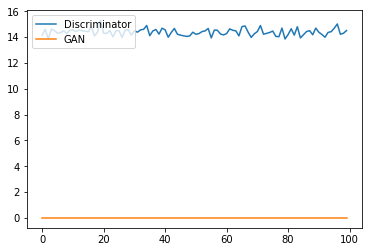

An Example from the Training Set: 


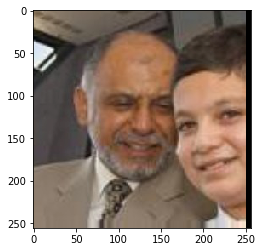

An Example from the Generator: 


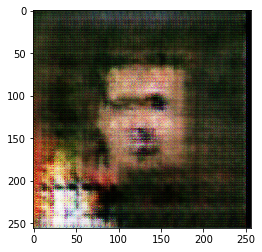

Prediction: [1.3940125e-10]


--------------- Epoch: 151 ---------------


KeyboardInterrupt: 

In [13]:
epochs = 600
batch_size = 10

# generator.load_weights('g_weights.h5')
# discriminator.load_weights('d_weights.h5')

for i in range(epochs):
    
    print("\n")
    print('-'*15, 'Epoch: ' + str(i), '-'*15)
    
    x_train_batch = get_batch(1000)
    
    # Number of batches
    batch_count = x_train_batch.shape[0] / batch_size
    
    start = 0
    end = batch_size
    
    d_loss = 0
    g_loss = 0
    g_loss_arr = []
    d_loss_arr = []
        
    for j in range(int(batch_count)):
        
        if j % 10 == 0 and j != 0:
            # print(".", end="")
            print("Discriminator loss: " + str(d_loss) + ", GAN loss: " + str(g_loss) + "\n")
        
        # Get a random set of input noise and images
        # generator.trainable = False
        noise = np.random.normal(0, 1, size=[batch_size, 1, 1, 100])        
        image_batch = x_train_batch[start:end]
        image_batch = np.reshape(image_batch, (batch_size, 256, 256, 3))
        
        # Generate fake images
        generated_images = generator.predict(noise)
        X = np.concatenate([image_batch, generated_images])
        
#         if j % 50 == 0 and j != 0:
#             k = rand.randint(0, batch_size)
#             print("An Example from the Training Set: ")
#             plt.imshow(image_batch[k], vmin=0, vmax=1)
#             plt.show()

        # Labels for generated and real data
        y_dis = np.zeros(2*batch_size)
        y_dis[:batch_size] = 1
        
        real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
        fake_data_Y = np.random.random_sample(batch_size)*0.2

        # Train discriminator
        discriminator.trainable = True
        generator.trainable = False
        # discriminator.fit(X, y_dis, epochs=10)
        # d_loss = discriminator.train_on_batch(X, y_dis)
        d_loss = discriminator.train_on_batch(image_batch, real_data_Y)
        d_loss = discriminator.train_on_batch(generated_images, fake_data_Y)
        
        # d_history = discriminator.fit(X, y_dis)
        d_loss_arr.append(d_loss)

        # Train generator
        noise = np.random.normal(0, 1, size=[batch_size, 1, 1, 100])
        # The y-label will be 1 since we want to train the generator such that the GAN gives out 1
        y_gen = np.ones(batch_size)
        discriminator.trainable = False
        generator.trainable = True
        g_loss = gan.train_on_batch(noise, y_gen)
        # g_loss = gan.train_on_batch(noise, y_gen)
        # g_history = gan.fit(noise, y_gen)
        g_loss_arr.append(g_loss)
        
        # Update start and end
        start += batch_size
        end += batch_size

    print("Loss History:")
    plt.plot(d_loss_arr, label = 'Discriminator')
    plt.plot(g_loss_arr, label = 'GAN')
    plt.legend(loc='upper left')
    plt.show()
    
    # Display a sample of the results
    noise = np.random.normal(0, 1, size=[1, 1, 1, 100])
    generated_images = generator.predict(noise)
    generated_images = generated_images * 0.5 + 0.5

    arr = discriminator.predict(generated_images)
    generated_images = generated_images.reshape(1, 256, 256, 3)
    generated_images = np.clip(generated_images, 0, 1)

    k = rand.randint(0, batch_size)
    img = image_batch[k] * 0.5 + 0.5
    print("An Example from the Training Set: ")
    plt.imshow(img, vmin=0, vmax=1)
    plt.show()
    print("An Example from the Generator: ")
    plt.imshow(generated_images[0], vmin=0, vmax=1)
    plt.show()
    print("Prediction: " + str(arr[0]))
    
    generator.save_weights('g_weights.h5')
    discriminator.save_weights('d_weights.h5')